In [ ]:
!pip install -q kaggle
from google.colab import files
files.upload()  # حمّل ملف kaggle.json هنا

!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

!kaggle datasets download -d alkanerturan/vehicledetection
!unzip vehicledetection.zip -d vehicle_data


Saving kaggle.json to kaggle.json
Dataset URL: https://www.kaggle.com/datasets/alkanerturan/vehicledetection
License(s): other
  0% 0.00/62.8M [00:00<?, ?B/s]
100% 62.8M/62.8M [00:00<00:00, 1.31GB/s]
Archive:  vehicledetection.zip
  inflating: vehicle_data/TestVideo/TrafficPolice.mp4  
  inflating: vehicle_data/VehiclesDetectionDataset/dataset.yaml  
  inflating: vehicle_data/VehiclesDetectionDataset/test/images/00dea1edf14f09ab_jpg.rf.3f17c8790a68659d03b1939a59ccda80.jpg  
  inflating: vehicle_data/VehiclesDetectionDataset/test/images/00dea1edf14f09ab_jpg.rf.KJ730oDTFPdXdJxvSLnX.jpg  
  inflating: vehicle_data/VehiclesDetectionDataset/test/images/00e481ea1a520175_jpg.rf.6e6a8b3b45c9a11d106958f88ff714ea.jpg  
  inflating: vehicle_data/VehiclesDetectionDataset/test/images/00e481ea1a520175_jpg.rf.MV6sZ8QCFwFeMYaI2tHm.jpg  
  inflating: vehicle_data/VehiclesDetectionDataset/test/images/08c8b73e0c2e296e_jpg.rf.7IkYAamjZhnwsoXSrwKt.jpg  
  inflating: vehicle_data/VehiclesDetectionDataset/te

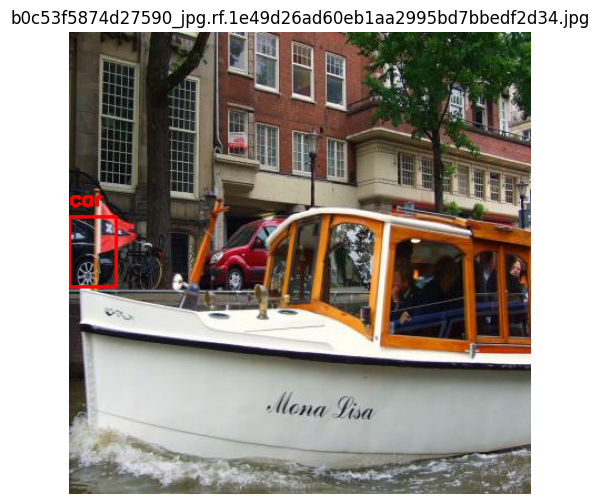

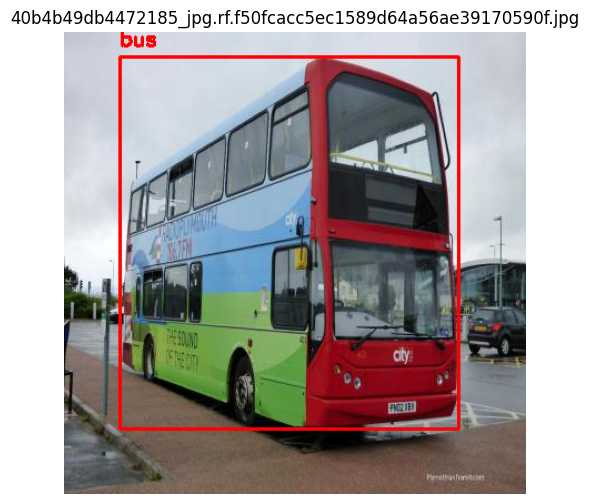

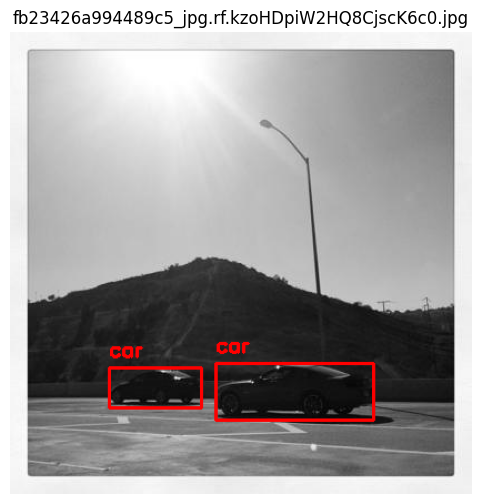

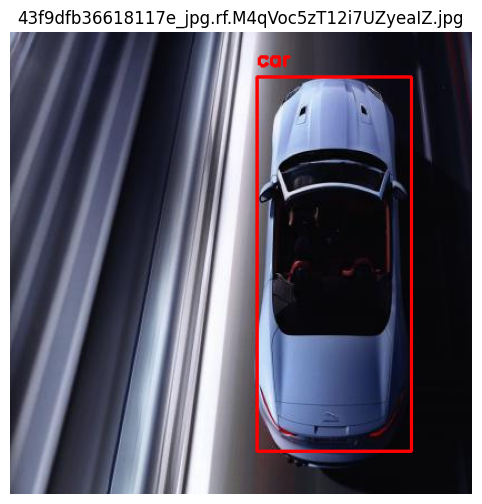

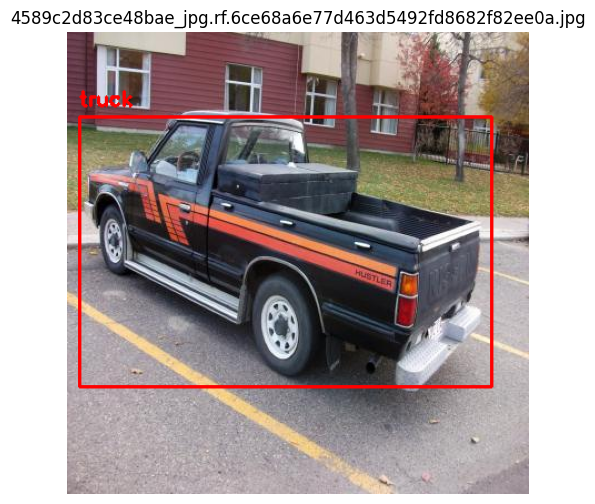

...

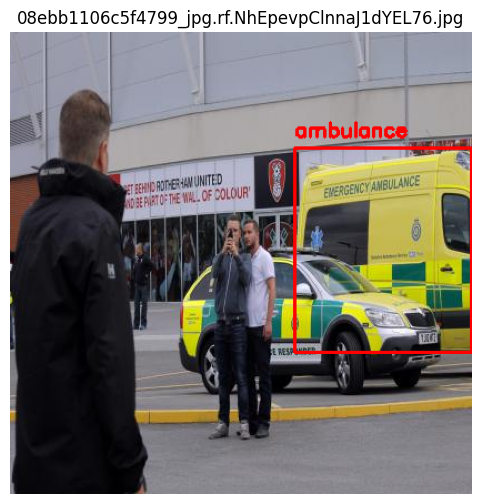

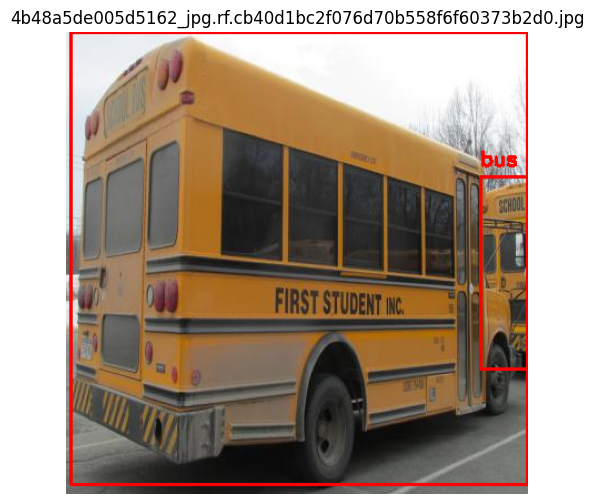

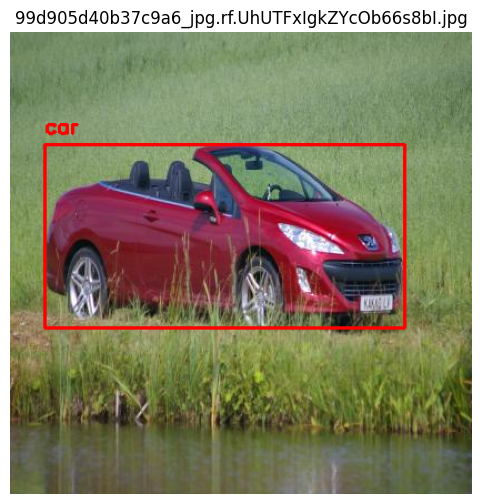

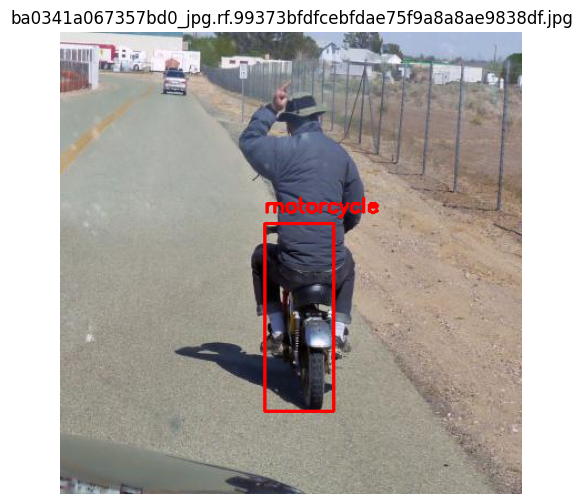

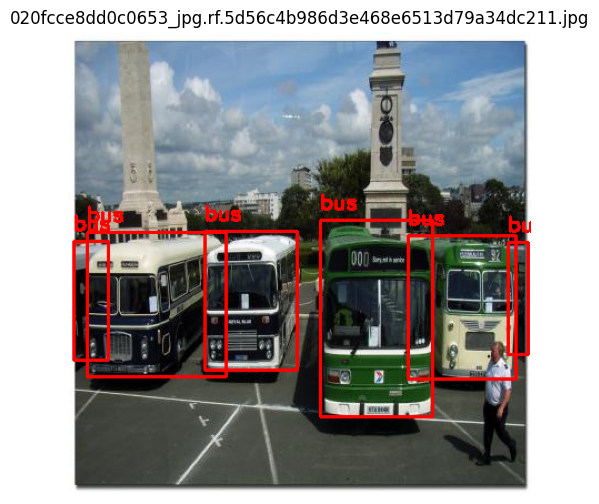

In [ ]:
import os
import random
import cv2
import matplotlib.pyplot as plt

# Paths
images_path = '/content/vehicle_data/VehiclesDetectionDataset/train/images'
labels_path = '/content/vehicle_data/VehiclesDetectionDataset/train/labels'

# Class names (update if you have different names)
class_names = ['ambulance', 'bus', 'car', 'motorcycle', 'truck', 'bicycle']

# List of image files
image_files = [f for f in os.listdir(images_path) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Show 20 random images
sample_images = random.sample(image_files, 20)

for img_file in sample_images:
    img_path = os.path.join(images_path, img_file)
    label_path = os.path.join(labels_path, os.path.splitext(img_file)[0] + '.txt')

    # Load image
    image = cv2.imread(img_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w, _ = image.shape

    # Draw labels if exist
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue
                class_id, x_center, y_center, box_width, box_height = map(float, parts)
                class_id = int(class_id)

                # Convert from normalized to pixel values
                x1 = int((x_center - box_width / 2) * w)
                y1 = int((y_center - box_height / 2) * h)
                x2 = int((x_center + box_width / 2) * w)
                y2 = int((y_center + box_height / 2) * h)

                # Draw rectangle and label
                color = (255, 0, 0)
                cv2.rectangle(image, (x1, y1), (x2, y2), color, 2)
                cv2.putText(image, class_names[class_id] if class_id < len(class_names) else str(class_id),
                            (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)

    # Plot image
    plt.figure(figsize=(8, 6))
    plt.imshow(image)
    plt.title(img_file)
    plt.axis('off')
    plt.show()


In [ ]:
!pip install ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 38.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 125.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 94.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 55.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 109.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstallin

<ipython-input-5-ef43f13d0846>:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(class_counts.keys()), y=list(class_counts.values()), palette="viridis")


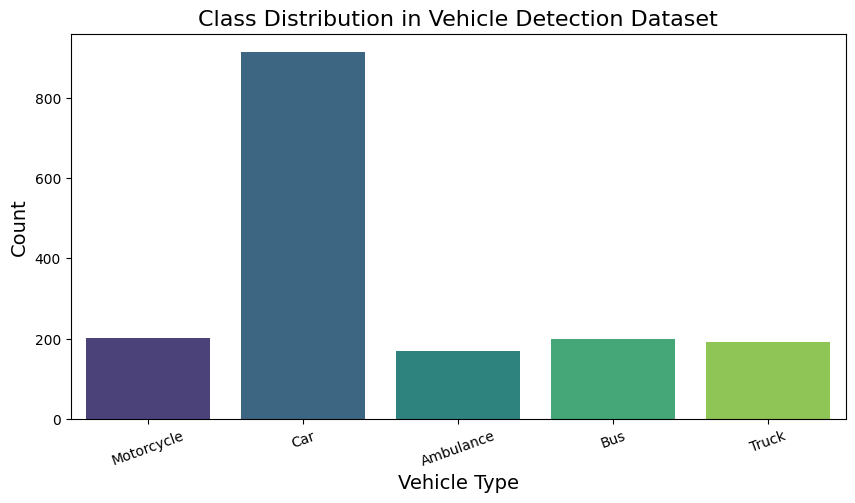

In [ ]:
from collections import Counter
import seaborn as sns

def Count_Classes():
    """
    Reads all label files and counts the occurrences of each class.
    """
    class_counts = Counter()

    # Loop through all label files
    for lbl_path in train_labels.iterdir():
        with open(lbl_path, 'r') as f:
            lines = f.readlines()
            for line in lines:
                class_id = int(line.strip().split()[0])  # Extract class ID
                class_counts[class_names[class_id]] += 1  # Increment count

    # Plot countplot
    plt.figure(figsize=(10, 5))
    sns.barplot(x=list(class_counts.keys()), y=list(class_counts.values()), palette="viridis")
    plt.xlabel("Vehicle Type", fontsize=14)
    plt.ylabel("Count", fontsize=14)
    plt.title("Class Distribution in Vehicle Detection Dataset", fontsize=16)
    plt.xticks(rotation=20)  # Rotate labels for better readability
    plt.show()

Count_Classes()

In [ ]:
!pip install albumentations


In [ ]:
import os
import cv2
import albumentations as A
from albumentations.pytorch import ToTensorV2
import numpy as np

# Define augmentation pipeline
transform = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.Rotate(limit=10, p=0.3),
    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=0, p=0.5),
    A.RandomShadow(p=0.2),
    A.MotionBlur(p=0.2),
], bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

# Paths
augmented_path = '/content/vehicle_data/VehiclesDetectionDataset/augmented'
os.makedirs(os.path.join(augmented_path, 'images'), exist_ok=True)
os.makedirs(os.path.join(augmented_path, 'labels'), exist_ok=True)

# Process each image
for img_file in image_files:
    img_path = os.path.join(images_path, img_file)
    label_path = os.path.join(labels_path, os.path.splitext(img_file)[0] + '.txt')

    # Load image and label
    image = cv2.imread(img_path)
    h, w, _ = image.shape
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    bboxes = []
    class_labels = []

    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue
                class_id, x_center, y_center, box_width, box_height = map(float, parts)
                bboxes.append([x_center, y_center, box_width, box_height])
                class_labels.append(int(class_id))

        # Apply augmentation
        augmented = transform(image=image, bboxes=bboxes, class_labels=class_labels)
        aug_img = augmented['image']
        aug_bboxes = augmented['bboxes']
        aug_classes = augmented['class_labels']

        # Save augmented image and label
        aug_img = cv2.cvtColor(aug_img, cv2.COLOR_RGB2BGR)
        aug_img_name = os.path.splitext(img_file)[0] + '_aug.jpg'
        cv2.imwrite(os.path.join(augmented_path, 'images', aug_img_name), aug_img)

        label_output_path = os.path.join(augmented_path, 'labels', os.path.splitext(img_file)[0] + '_aug.txt')
        with open(label_output_path, 'w') as f:
            for bbox, class_id in zip(aug_bboxes, aug_classes):
                f.write(f"{class_id} {' '.join(f'{x:.6f}' for x in bbox)}\n")


/usr/local/lib/python3.11/dist-packages/albumentations/core/validation.py:111: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)


In [ ]:
import os

val_img_dir = '/content/vehicle_data/VehiclesDetectionDataset/valid/images'

# Count image files
val_images = [f for f in os.listdir(val_img_dir) if f.endswith(('.jpg', '.png', '.jpeg'))]
print(f"Total validation images: {len(val_images)}")


Total validation images: 250


In [ ]:
import os

# Path to augmented images
aug_images_path = '/content/vehicle_data/VehiclesDetectionDataset/augmented/images'

# List all image files
aug_image_files = [f for f in os.listdir(aug_images_path) if f.endswith(('.jpg', '.jpeg', '.png'))]

# Count and print
print(f"Total augmented images: {len(aug_image_files)}")


Total augmented images: 878


move the augmented images to the train folder

In [ ]:
import shutil
import os

# Paths
aug_img_dir = '/content/vehicle_data/VehiclesDetectionDataset/augmented/images'
aug_lbl_dir = '/content/vehicle_data/VehiclesDetectionDataset/augmented/labels'
train_img_dir = '/content/vehicle_data/VehiclesDetectionDataset/train/images'
train_lbl_dir = '/content/vehicle_data/VehiclesDetectionDataset/train/labels'

# Copy images
for file in os.listdir(aug_img_dir):
    if file.endswith(('.jpg', '.png', '.jpeg')):
        shutil.copy(os.path.join(aug_img_dir, file), os.path.join(train_img_dir, file))

# Copy labels
for file in os.listdir(aug_lbl_dir):
    if file.endswith('.txt'):
        shutil.copy(os.path.join(aug_lbl_dir, file), os.path.join(train_lbl_dir, file))


In [ ]:
print("Total training images:", len(os.listdir(train_img_dir)))
print("Total training labels:", len(os.listdir(train_lbl_dir)))


Total training images: 1756
Total training labels: 1756


In [ ]:
# هذا الكود ينشئ ملف data.yaml داخل Colab
with open("data.yaml", "w") as f:
    f.write(
        """
train: /content/vehicle_data/VehiclesDetectionDataset/augmented/images
val: /content/vehicle_data//VehiclesDetectionDataset/valid/images
test: /content/vehicle_data/VehiclesDetectionDataset/test/images

nc: 5
names : ['ambulance', 'bus', 'car', 'motorcycle', 'truck']
        """
    )

**yolov8n**

In [ ]:
from ultralytics import YOLO

# Use a pre-trained model (recommended)
model = YOLO("yolov8n.pt")  # Or yolov8s.pt if your GPU can handle it

# Train
model.train(
    data="/content/data.yaml",
    epochs=150,
    imgsz=800,
    batch=32,
    name="vehicle_detection_augmented"
)


Ultralytics 8.3.122 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/data.yaml, epochs=150, time=None, patience=100, batch=32, imgsz=800, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=vehicle_detection_augmented3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=T

train: Scanning /content/vehicle_data/VehiclesDetectionDataset/train/labels.cache... 1756 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1756/1756 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 329.8±253.9 MB/s, size: 33.0 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]


Plotting labels to runs/detect/vehicle_detection_augmented3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 800 train, 800 val
Using 8 dataloader workers
Logging results to runs/detect/vehicle_detection_augmented3
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/150      6.03G      1.155      2.968      1.538        119        800: 100%|██████████| 55/55 [00:23<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]

                   all        250        454      0.498      0.166      0.254       0.12



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/150         6G      1.202      2.259      1.549         96        800: 100%|██████████| 55/55 [00:22<00:00,  2.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]

                   all        250        454      0.255      0.348      0.263      0.113



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/150      5.98G      1.203      2.096      1.546        108        800: 100%|██████████| 55/55 [00:22<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.10it/s]

                   all        250        454      0.356      0.242      0.214      0.104



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/150      5.99G      1.235      2.016      1.585         81        800: 100%|██████████| 55/55 [00:23<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]

                   all        250        454     0.0983      0.289      0.121     0.0612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/150      5.99G      1.198      1.847      1.565         90        800: 100%|██████████| 55/55 [00:23<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]

                   all        250        454      0.436      0.333      0.283      0.149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/150         6G      1.201      1.737      1.547        110        800: 100%|██████████| 55/55 [00:23<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.389      0.447      0.321      0.176



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/150      5.93G       1.16      1.581      1.515        100        800: 100%|██████████| 55/55 [00:23<00:00,  2.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.702      0.326      0.423      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/150      7.35G      1.139      1.506      1.497         87        800: 100%|██████████| 55/55 [00:23<00:00,  2.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.24it/s]

                   all        250        454      0.382      0.407      0.365      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/150      7.36G      1.113      1.447      1.475        125        800: 100%|██████████| 55/55 [00:23<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.457      0.388      0.324       0.18



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/150      7.37G      1.095      1.355      1.438        104        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.23it/s]

                   all        250        454      0.465      0.453      0.411      0.249



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/150      7.37G      1.074      1.296      1.432        100        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.24it/s]

                   all        250        454      0.459      0.357      0.355      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/150      7.37G      1.053      1.256      1.428        100        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.23it/s]

                   all        250        454      0.561      0.355       0.41      0.263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/150         6G      1.041      1.221      1.417         92        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.534      0.494       0.45      0.302



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/150      5.96G      1.017      1.191       1.38         95        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.23it/s]

                   all        250        454       0.46      0.512      0.458      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/150      5.94G      1.015      1.159      1.399         84        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.467       0.49      0.423      0.262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/150      7.36G     0.9925      1.093      1.371         91        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.23it/s]

                   all        250        454      0.521      0.419      0.405      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/150      7.38G     0.9735      1.087       1.36         83        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.517      0.386      0.388       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/150      5.96G     0.9481      1.051      1.344         93        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.563      0.421      0.475      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/150      5.92G     0.9435     0.9988      1.333         88        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.585       0.36      0.423      0.274



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/150      7.34G     0.9419     0.9756      1.333        110        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.582       0.43      0.451      0.288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/150      7.36G     0.9043      0.942      1.307        106        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]

                   all        250        454      0.558      0.462      0.435      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/150      7.36G     0.9063     0.9201      1.305         99        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.555      0.571        0.5       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/150      7.36G      0.878     0.9029      1.275         87        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]

                   all        250        454      0.692      0.467      0.516      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/150      7.37G     0.8838     0.9096      1.288        102        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.28it/s]

                   all        250        454      0.566      0.506       0.52       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/150      6.01G     0.8383     0.8555      1.252         77        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.543      0.444      0.452      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/150      5.99G      0.868     0.8778      1.261         85        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.31it/s]

                   all        250        454      0.698      0.474       0.49      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/150      5.96G     0.8293     0.8373      1.243        111        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]

                   all        250        454      0.549      0.516       0.48      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/150      7.38G     0.8339     0.8147      1.248         95        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]

                   all        250        454       0.43      0.495      0.409      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/150      5.99G     0.8331     0.8326      1.254        109        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.622      0.457      0.522      0.359



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/150      5.99G     0.8124     0.7987       1.24        119        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.604       0.47      0.491      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/150      5.99G     0.8235     0.7979      1.235         92        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.24it/s]

                   all        250        454      0.615      0.439      0.471      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/150         6G     0.8047     0.7663      1.234        113        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.524      0.503      0.482      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/150      5.92G     0.7967     0.7751      1.226        106        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.32it/s]

                   all        250        454      0.575      0.457      0.486      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/150      7.34G      0.778     0.7477       1.21        116        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.587      0.483      0.498      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/150      7.35G     0.7725     0.7303      1.199        128        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.24it/s]

                   all        250        454      0.586      0.486      0.509      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/150      7.35G     0.7763      0.742      1.204         96        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]

                   all        250        454      0.611      0.465      0.485      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/150      7.35G     0.7755     0.7416      1.203         71        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]

                   all        250        454      0.609      0.472      0.505      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/150      7.35G     0.7512     0.7047      1.196         90        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]

                   all        250        454      0.641      0.412      0.466      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/150      7.37G     0.7545     0.7015      1.184         88        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.23it/s]

                   all        250        454      0.522      0.524      0.502      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/150      5.97G     0.7465     0.6959      1.187         96        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.24it/s]

                   all        250        454      0.507      0.539      0.484       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/150      5.99G     0.7437     0.6906      1.183        104        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454       0.57      0.513      0.523      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/150      5.96G     0.7252     0.6866      1.174         93        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]

                   all        250        454      0.567      0.465      0.454      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/150         6G     0.7252     0.6771      1.167         99        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]

                   all        250        454      0.593      0.461      0.485      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/150      5.96G     0.7199     0.6526      1.158         80        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.702      0.444      0.501      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/150      5.99G     0.6999     0.6264      1.148        124        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.28it/s]

                   all        250        454      0.571      0.498      0.519      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/150      5.99G     0.7063     0.6334       1.15        115        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]

                   all        250        454      0.605      0.512      0.535      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/150         6G     0.7266     0.6652      1.168        101        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.574      0.446      0.502      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/150      5.98G     0.7101     0.6475      1.164         83        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.573      0.517      0.513      0.359



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/150      5.96G     0.6808     0.6158       1.14        107        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.647      0.504      0.509      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/150      7.38G     0.6735     0.6057      1.131         95        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]

                   all        250        454       0.59      0.556      0.549      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/150      5.98G     0.6824     0.6222      1.146         79        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.28it/s]

                   all        250        454      0.519      0.579      0.513      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/150      5.99G     0.6618     0.5983      1.128         90        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]

                   all        250        454       0.59      0.484      0.513      0.379



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/150      5.97G     0.6546     0.5877      1.117        113        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.28it/s]

                   all        250        454      0.599       0.54       0.55      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/150      5.96G     0.6421     0.5843      1.117         93        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.648      0.468        0.5      0.359



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/150      5.96G     0.6511     0.5852      1.117        111        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]

                   all        250        454      0.524      0.542      0.537      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/150      7.38G     0.6562     0.5962      1.126         87        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]

                   all        250        454      0.588      0.593      0.563      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/150      5.92G     0.6483     0.5758      1.112        123        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.597      0.505      0.525       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/150      7.34G     0.6499     0.5664      1.112        121        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]

                   all        250        454      0.626      0.453       0.52      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/150      7.35G     0.6354     0.5659      1.105        104        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.555      0.486      0.491      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/150      7.37G     0.6437     0.5703      1.117         74        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.652      0.436      0.525      0.368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/150      7.37G     0.6291     0.5577      1.108        103        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.561      0.486      0.505      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/150      5.94G     0.6286     0.5539      1.105        133        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.23it/s]

                   all        250        454      0.639      0.483      0.539      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/150      7.35G     0.6276      0.571      1.105        107        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.626      0.525      0.561      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/150      7.37G     0.6283     0.5524        1.1         92        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.594      0.454      0.496      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/150      5.94G     0.6172     0.5466      1.094        108        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.32it/s]

                   all        250        454       0.67      0.514      0.558       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/150      7.35G     0.6154     0.5436       1.09         95        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.578      0.502      0.524      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/150      7.36G     0.6143     0.5487      1.097        101        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.32it/s]

                   all        250        454      0.596      0.498      0.535      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/150      7.37G      0.598     0.5244      1.092        109        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.669      0.476       0.54      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/150      7.37G     0.5975     0.5151      1.085         97        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]

                   all        250        454      0.681      0.492      0.534      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/150      7.38G     0.5977     0.5282      1.086        107        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.31it/s]

                   all        250        454       0.57       0.54      0.538      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/150      5.98G     0.5912     0.5092      1.082         97        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]

                   all        250        454      0.588      0.544      0.546      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/150      5.96G     0.5749     0.5059      1.073        104        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]

                   all        250        454      0.541      0.548      0.541       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/150      5.97G     0.5873     0.5115      1.083         93        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]

                   all        250        454      0.581      0.605       0.57      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/150      5.96G      0.584     0.5057      1.076         87        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.32it/s]

                   all        250        454      0.544      0.526      0.524      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/150      5.98G     0.5769     0.5068      1.072         80        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.23it/s]

                   all        250        454      0.597      0.567      0.562      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/150      5.93G     0.5715     0.4941      1.063         82        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.579      0.595      0.553      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/150      7.35G     0.5673     0.4829      1.067         95        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]

                   all        250        454      0.596      0.539      0.551      0.412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/150      7.37G     0.5751     0.4927      1.061         87        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.31it/s]

                   all        250        454      0.548      0.584      0.539      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/150      5.94G     0.5587     0.4815      1.051         92        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.555      0.522       0.53      0.382



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/150      7.35G      0.566     0.4755       1.06        103        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.28it/s]

                   all        250        454       0.67       0.55      0.582      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/150      7.36G     0.5674     0.4843      1.058         87        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.28it/s]

                   all        250        454      0.648      0.553      0.531       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/150      7.37G     0.5659     0.4789      1.062         98        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.31it/s]

                   all        250        454      0.485      0.572      0.526      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/150      7.37G     0.5552     0.4782      1.048        116        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]

                   all        250        454      0.586      0.568      0.546      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/150      7.38G     0.5422     0.4583      1.048        113        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.28it/s]

                   all        250        454      0.587       0.53      0.517      0.378



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/150      5.99G     0.5507     0.4688      1.057        113        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.31it/s]

                   all        250        454      0.619       0.56      0.554      0.407



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/150      5.96G     0.5437     0.4564      1.043         93        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.31it/s]

                   all        250        454      0.563      0.562      0.537       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/150      5.97G     0.5317     0.4528      1.043        105        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.28it/s]

                   all        250        454      0.595      0.564      0.546      0.391



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/150         6G     0.5364     0.4644      1.043        101        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.617      0.539      0.563      0.399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/150      5.93G     0.5338     0.4502      1.049        115        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.28it/s]

                   all        250        454      0.633      0.506      0.542      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/150      7.35G     0.5263     0.4445      1.036         93        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]

                   all        250        454      0.649      0.517      0.546      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/150      7.37G     0.5127     0.4363      1.026         96        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454       0.69      0.522      0.572       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/150      7.37G     0.5157      0.435      1.027        111        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.632      0.484      0.556      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/150      7.37G     0.5167      0.434      1.028         94        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.33it/s]

                   all        250        454      0.608      0.534      0.559      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/150      7.38G       0.51     0.4316      1.031         86        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]

                   all        250        454      0.608      0.544      0.535      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/150      5.99G     0.5052     0.4365      1.028         93        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.24it/s]

                   all        250        454      0.623      0.561      0.554      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/150      5.99G     0.5078     0.4275      1.029         96        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]

                   all        250        454      0.641      0.554      0.557      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/150         6G     0.4946     0.4218      1.019         78        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.32it/s]

                   all        250        454      0.597      0.531       0.51      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/150      5.97G     0.4985     0.4224      1.024         93        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.32it/s]

                   all        250        454      0.599      0.513       0.53        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/150      5.93G      0.498     0.4305       1.02        120        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]

                   all        250        454      0.644      0.521       0.54      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/150      7.35G     0.4883     0.4141      1.018         94        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]

                   all        250        454      0.705       0.47      0.563      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/150      7.37G     0.4904     0.4167      1.017         85        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.592      0.552      0.543      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/150      7.37G     0.4886     0.4111      1.013         83        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.28it/s]

                   all        250        454      0.611      0.562      0.575      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/150      7.37G     0.4939     0.4169      1.021         84        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]

                   all        250        454      0.533      0.548      0.537      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/150      7.38G      0.489     0.4139      1.017         79        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.639      0.529      0.571      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/150      5.99G     0.4856      0.406      1.007         78        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.31it/s]

                   all        250        454      0.652      0.475      0.532      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/150      5.98G     0.4789     0.3977      1.013         84        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.581      0.556      0.556      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/150      5.99G     0.4878     0.4128      1.017        100        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.589      0.512       0.55      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/150      5.92G     0.4868     0.4054      1.017        104        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.685      0.488      0.534      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/150      7.34G     0.4708     0.3994      1.005        123        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.564      0.533      0.523      0.381



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/150      7.36G     0.4615     0.3851     0.9995        106        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]

                   all        250        454      0.627      0.497      0.542      0.391



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/150      7.36G     0.4583     0.3892     0.9961         83        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.23it/s]

                   all        250        454      0.507      0.549      0.547      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/150      7.36G     0.4711     0.3982      1.007        114        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454       0.62      0.506      0.528      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/150      7.38G     0.4564     0.3808     0.9933         89        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.31it/s]

                   all        250        454      0.514      0.551      0.504      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/150      6.03G     0.4624     0.3829     0.9979        127        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.31it/s]

                   all        250        454      0.638      0.507      0.538      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/150      5.97G     0.4578     0.3817     0.9929        106        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]

                   all        250        454      0.666      0.488      0.568      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/150      5.97G     0.4606     0.3782     0.9989        110        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]

                   all        250        454      0.579      0.529      0.549      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/150      5.97G     0.4495     0.3752      0.988        114        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]

                   all        250        454      0.607      0.498      0.543      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/150      5.99G     0.4509     0.3761     0.9957        107        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.28it/s]

                   all        250        454      0.726      0.444      0.545      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/150      5.92G     0.4351     0.3658     0.9879        104        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]

                   all        250        454      0.626       0.53      0.582      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/150      7.34G     0.4456     0.3721     0.9874        127        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.641      0.525      0.553      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/150      7.36G     0.4472     0.3704     0.9951        104        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.674        0.5      0.533      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/150      7.36G     0.4343     0.3627     0.9861        123        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.603      0.532      0.556      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/150      7.36G     0.4446     0.3653     0.9892         95        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.28it/s]

                   all        250        454      0.607      0.496      0.538      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/150      7.38G     0.4249     0.3558     0.9849         98        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]

                   all        250        454      0.648        0.5      0.577      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/150      5.99G     0.4287     0.3591     0.9806         93        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]

                   all        250        454      0.582      0.551      0.558       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/150      5.93G     0.4288     0.3585     0.9824         80        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.569      0.569       0.56      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/150      7.35G     0.4245     0.3584     0.9835         94        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.31it/s]

                   all        250        454      0.595      0.581      0.562      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/150      7.37G     0.4218     0.3565     0.9804        119        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.621      0.552       0.58      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/150      7.37G     0.4193     0.3547     0.9786         95        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]

                   all        250        454      0.591      0.544       0.56      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/150      7.37G     0.4165     0.3464     0.9832        100        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.638       0.53      0.546      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/150      5.98G     0.4117     0.3443     0.9709        110        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.23it/s]

                   all        250        454      0.592      0.566      0.569       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/150      5.98G     0.4146     0.3494     0.9733         95        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.28it/s]

                   all        250        454      0.574      0.536      0.553      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/150      5.98G     0.4238     0.3466     0.9785         84        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.32it/s]

                   all        250        454      0.672      0.487      0.563      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/150      5.97G     0.4092     0.3419     0.9759         95        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.616      0.535      0.555      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/150      5.98G     0.4095     0.3418     0.9716        101        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.26it/s]

                   all        250        454      0.599      0.549      0.567      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/150      5.93G      0.403     0.3317     0.9731        103        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.657      0.547      0.583      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/150      7.35G     0.3981     0.3318     0.9668         90        800: 100%|██████████| 55/55 [00:23<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.556      0.577      0.566      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/150      7.36G     0.4064     0.3383     0.9711        109        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.23it/s]

                   all        250        454      0.565      0.518       0.55      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/150      7.37G      0.407     0.3348     0.9737        111        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.31it/s]

                   all        250        454      0.557      0.532      0.555      0.412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/150      7.37G     0.3922     0.3332     0.9637        104        800: 100%|██████████| 55/55 [00:23<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.553      0.568      0.581       0.43


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/150      5.89G     0.3908     0.3002     0.9533         63        800: 100%|██████████| 55/55 [00:25<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.24it/s]

                   all        250        454      0.582      0.533      0.576      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    142/150       7.3G     0.3558      0.269     0.9308         43        800: 100%|██████████| 55/55 [00:23<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.31it/s]

                   all        250        454        0.6      0.539      0.566      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    143/150      7.31G      0.356     0.2663     0.9277         56        800: 100%|██████████| 55/55 [00:23<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.623      0.541      0.576      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    144/150      7.33G     0.3374     0.2566     0.9179         44        800: 100%|██████████| 55/55 [00:23<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454       0.58      0.558      0.571      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    145/150      7.33G     0.3379     0.2595     0.9208         58        800: 100%|██████████| 55/55 [00:23<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]

                   all        250        454      0.617      0.575      0.577      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    146/150      7.33G     0.3415     0.2591     0.9224         46        800: 100%|██████████| 55/55 [00:23<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.31it/s]

                   all        250        454      0.592      0.575      0.584      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    147/150      7.35G     0.3267     0.2501      0.908         57        800: 100%|██████████| 55/55 [00:23<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]

                   all        250        454      0.603      0.583      0.578      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    148/150      7.35G     0.3294     0.2512     0.9129         64        800: 100%|██████████| 55/55 [00:23<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.601      0.573      0.576       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    149/150      7.35G     0.3267     0.2496     0.9142         54        800: 100%|██████████| 55/55 [00:23<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.604      0.575      0.581      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    150/150      7.36G     0.3197     0.2465      0.909         56        800: 100%|██████████| 55/55 [00:23<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.27it/s]

                   all        250        454      0.608      0.581       0.59      0.446



150 epochs completed in 1.083 hours.
Optimizer stripped from runs/detect/vehicle_detection_augmented3/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/vehicle_detection_augmented3/weights/best.pt, 6.3MB

Validating runs/detect/vehicle_detection_augmented3/weights/best.pt...
Ultralytics 8.3.122 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.50it/s]


                   all        250        454      0.605      0.581       0.59      0.447
             ambulance         50         64      0.841      0.875      0.883      0.745
                   bus         30         46      0.551      0.652      0.671      0.541
                   car         90        238      0.565      0.471      0.482      0.343
            motorcycle         42         46        0.6      0.609      0.537      0.309
                 truck         38         60      0.469        0.3      0.377      0.296
Speed: 0.3ms preprocess, 3.9ms inference, 0.0ms loss, 3.1ms postprocess per image
Results saved to runs/detect/vehicle_detection_augmented3


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x78adce253dd0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
from ultralytics import YOLO

# بدال ما تحمل YOLOv5s، تحمل YOLOv8n أو YOLOv8s أو غيره
model = YOLO("yolov8s.pt")  # أو yolov8s.pt حسب الحجم اللي تريده

# التدريب بنفس الكود:
model.train(
    data="/content/data.yaml",
    epochs=100,
    imgsz=800,
    batch=16,
    name="vehicle_detection_yolov8",
    augment=True
)


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 21.5M/21.5M [00:00<00:00, 361MB/s]


Ultralytics 8.3.117 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=800, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=vehicle_detection_yolov8, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, 

100%|██████████| 755k/755k [00:00<00:00, 89.9MB/s]

Overriding model.yaml nc=80 with nc=6

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

Model summary: 129 layers, 11,137,922 parameters, 11,137,906 gradients, 28.7 GFLOPs

Transferred 349/355 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...


100%|██████████| 5.35M/5.35M [00:00<00:00, 305MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 887.2±351.4 MB/s, size: 29.7 KB)


train: Scanning /content/vehicle_data/VehiclesDetectionDataset/train/labels... 878 images, 0 backgrounds, 0 corrupt: 100%|██████████| 878/878 [00:00<00:00, 1516.88it/s]

train: New cache created: /content/vehicle_data/VehiclesDetectionDataset/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 691.1±410.9 MB/s, size: 33.0 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<00:00, 1438.33it/s]

val: New cache created: /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache


Plotting labels to runs/detect/vehicle_detection_yolov8/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 800 train, 800 val
Using 8 dataloader workers
Logging results to runs/detect/vehicle_detection_yolov8
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      5.61G      1.189      4.505      1.549         50        800: 100%|██████████| 55/55 [00:21<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.34it/s]

                   all        250        454       0.51      0.449      0.444      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      6.81G      1.175       1.94      1.529         50        800: 100%|██████████| 55/55 [00:20<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.99it/s]

                   all        250        454      0.392      0.316      0.263      0.139



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      6.85G       1.22      1.834      1.556         52        800: 100%|██████████| 55/55 [00:21<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.548      0.213      0.177     0.0875



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      6.88G      1.299      1.905      1.648         54        800: 100%|██████████| 55/55 [00:22<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.85it/s]

                   all        250        454      0.262      0.281      0.164     0.0676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      6.92G      1.309      1.885      1.643         38        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.372      0.354      0.277      0.164



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      6.96G      1.261       1.77      1.596         38        800: 100%|██████████| 55/55 [00:21<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.371      0.288      0.254      0.119



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      6.99G      1.236       1.75      1.608         47        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.232      0.318      0.275      0.163



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      7.03G      1.177      1.635      1.536         46        800: 100%|██████████| 55/55 [00:21<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.451      0.381      0.378       0.23



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      7.06G      1.197       1.59      1.537         42        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.301       0.43      0.343      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100       7.1G      1.169      1.525      1.531         44        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454      0.279      0.455       0.36      0.192



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      7.14G      1.152      1.485      1.532         63        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.499      0.372      0.388      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      7.17G      1.089      1.423       1.47         68        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.507      0.433      0.447      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      7.21G      1.062      1.351      1.463         48        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.436       0.43      0.399      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      7.24G       1.04      1.325      1.448         46        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.479      0.478      0.476      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      7.28G      1.041      1.282      1.426         61        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.505      0.499      0.524      0.339



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      7.32G      1.037      1.248      1.409         57        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.507      0.513      0.448      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      7.35G     0.9872      1.181      1.394         38        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454       0.53       0.48      0.497       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      5.76G      1.003      1.193      1.398         57        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.503      0.514       0.47      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      6.91G     0.9696      1.136      1.379         57        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.564      0.503      0.501      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      6.91G     0.9697      1.094      1.374         59        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.453      0.531      0.485      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      6.91G     0.9556      1.075      1.358         38        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.561      0.485      0.494      0.346



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      6.91G     0.9374      1.064      1.356         50        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.88it/s]

                   all        250        454      0.542      0.536      0.544      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      6.91G     0.9301      1.007      1.344         37        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.582      0.548      0.542      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      6.91G     0.9261       1.03      1.331         49        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.637      0.489      0.505      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      6.91G     0.8804     0.9811      1.303         42        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.546      0.458      0.461      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      6.93G     0.8771     0.9421      1.294         60        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.644      0.495      0.546      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      6.97G      0.875     0.9081      1.282         55        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.622      0.467      0.454       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100         7G     0.8378     0.8998      1.273         53        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.541      0.477      0.494      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      7.04G      0.825     0.8978      1.257         47        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.532      0.509      0.513      0.356



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      7.08G     0.8147     0.8949      1.254         41        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.575      0.525       0.53      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      7.11G      0.832     0.8663      1.269         48        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454       0.67      0.437      0.487       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      7.15G     0.8046     0.8213      1.243         67        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454       0.59      0.463      0.493      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      7.18G     0.7945     0.8162       1.24         44        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.592      0.532      0.543       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      7.22G     0.7803     0.8142      1.241         53        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454      0.623      0.472      0.522      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      7.26G     0.7708     0.7651      1.217         39        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.645      0.538      0.577       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      7.29G     0.7516     0.7754       1.21         69        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.599      0.584      0.583      0.407



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      7.33G     0.7651      0.765      1.209         42        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454       0.64      0.528      0.543      0.359



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      7.37G     0.7561     0.7855      1.213         51        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.548      0.551      0.526       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100       5.8G     0.7242     0.7347      1.197         40        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.698      0.543      0.577      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      6.96G     0.7285     0.7091      1.175         71        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.654      0.504      0.555      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      6.96G     0.7203     0.6875      1.168         45        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.593      0.585      0.574      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      6.96G     0.7203      0.712      1.173         49        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.532       0.55      0.523      0.355



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      6.96G     0.7017     0.6793       1.17         59        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.635      0.505      0.576        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      6.96G     0.6995     0.6913      1.165         47        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.765      0.426      0.549       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      6.96G     0.6852     0.6856      1.158         49        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.565      0.527      0.567      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      6.96G     0.6617     0.6472      1.135         53        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454      0.631      0.513      0.567      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      6.96G     0.6576     0.6291       1.13         51        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.564      0.604      0.599      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      6.98G     0.6648     0.6243      1.138         49        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.533      0.614      0.587      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      7.02G     0.6568     0.6365      1.145         34        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454       0.55      0.485      0.496      0.349



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      7.05G     0.6507      0.619      1.137         42        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.713      0.524      0.614      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      7.09G      0.635     0.5815      1.111         46        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.687      0.541      0.595      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      7.13G      0.631     0.6079      1.123         60        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.684      0.541       0.56      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      7.16G     0.6337     0.5988      1.119         31        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.778      0.494        0.6      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100       7.2G     0.6034     0.5646        1.1         40        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.646      0.528      0.567        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      7.23G     0.6102     0.5722      1.101         53        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.574      0.592      0.585      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      7.27G       0.61     0.5844      1.099         59        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.634      0.519      0.566      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      7.31G     0.5775     0.5308      1.077         43        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.672       0.51      0.587      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      7.35G     0.5756     0.5446      1.082         47        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.631      0.547      0.582      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      7.38G     0.5732     0.5364      1.077         62        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.609      0.557      0.606      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      5.87G      0.574     0.5321      1.068         59        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.664      0.545      0.604      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      7.02G     0.5562     0.5147      1.071         48        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454       0.62      0.528      0.555      0.382



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      7.02G     0.5528     0.5292      1.076         44        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.686      0.515      0.571      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      7.02G     0.5394      0.505      1.064         41        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.657      0.507      0.568      0.412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      7.02G     0.5468     0.4961      1.079         46        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.548      0.521      0.532      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      7.02G     0.5239     0.4826      1.049         50        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.516       0.54      0.522      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      7.02G     0.5378     0.4867      1.048         62        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.588       0.53      0.575      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      7.02G     0.5456     0.4879      1.053         65        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.599      0.571      0.598      0.421



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      7.02G     0.5241      0.483      1.047         55        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.634      0.516      0.566      0.407



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      7.05G     0.4973     0.4594      1.033         54        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.712       0.51      0.594      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      7.09G      0.506     0.4681      1.041         35        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.666      0.508      0.556      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      7.12G     0.5148     0.4659      1.046         49        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.696      0.499      0.578      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      7.16G     0.5042      0.466      1.049         54        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454       0.68      0.514      0.602      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100       7.2G     0.4944     0.4589      1.032         53        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.662      0.526      0.571      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      7.23G     0.4933      0.455      1.041         48        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.658      0.512      0.575      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      7.27G     0.4901     0.4462      1.023         52        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454       0.62      0.562      0.574      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      7.31G     0.4603     0.4211      1.009         68        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454       0.67      0.556      0.591      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      7.34G     0.4715     0.4324       1.03         45        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.709      0.532      0.608      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      7.38G     0.4691     0.4186       1.02         45        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454       0.59      0.537      0.572      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      5.75G     0.4751     0.4354      1.023         52        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.641      0.531      0.584      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100       6.9G     0.4729     0.4229       1.02         68        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.669      0.516      0.587      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100       6.9G     0.4433     0.4027      1.002         53        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.581      0.579      0.591      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100       6.9G     0.4478     0.4032      1.008         55        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.564       0.54       0.57      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100       6.9G     0.4612      0.412      1.014         42        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.794      0.434       0.57      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100       6.9G     0.4381     0.3953      1.006         46        800: 100%|██████████| 55/55 [00:21<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454       0.58      0.546      0.584       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100       6.9G     0.4388     0.3956      1.003         54        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.726      0.491      0.579       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100       6.9G     0.4274     0.3998      1.003         56        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.681      0.496      0.569      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      6.93G     0.4251     0.3783     0.9922         54        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.639      0.534      0.592      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      6.97G      0.414     0.3682     0.9808         55        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.637      0.517      0.586      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100         7G       0.41     0.3704     0.9892         55        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.601      0.546       0.58      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      7.04G     0.4189       0.37     0.9868         51        800: 100%|██████████| 55/55 [00:21<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.648      0.517      0.587      0.438


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      7.08G     0.3827     0.3172     0.9552         25        800: 100%|██████████| 55/55 [00:22<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.627      0.522      0.567       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      7.11G     0.3589     0.3031     0.9437         19        800: 100%|██████████| 55/55 [00:21<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.541      0.571      0.578      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      7.15G     0.3546      0.298     0.9351         26        800: 100%|██████████| 55/55 [00:21<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.624      0.538      0.592      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      7.19G      0.345     0.2899     0.9412         27        800: 100%|██████████| 55/55 [00:21<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.681      0.523      0.604      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      7.22G     0.3488     0.2897     0.9445         25        800: 100%|██████████| 55/55 [00:21<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.619      0.531        0.6      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      7.26G     0.3354     0.2826     0.9252         23        800: 100%|██████████| 55/55 [00:21<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.704      0.501      0.598       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      7.29G     0.3238     0.2688      0.923         20        800: 100%|██████████| 55/55 [00:21<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.639      0.512      0.601      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      7.33G      0.316     0.2692     0.9163         28        800: 100%|██████████| 55/55 [00:21<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.647      0.529      0.609      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      7.37G     0.3188     0.2638     0.9213         19        800: 100%|██████████| 55/55 [00:21<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.551      0.573      0.608      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100       5.8G     0.3211     0.2644      0.923         20        800: 100%|██████████| 55/55 [00:21<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.557       0.58      0.607      0.457



100 epochs completed in 0.695 hours.
Optimizer stripped from runs/detect/vehicle_detection_yolov8/weights/last.pt, 22.6MB
Optimizer stripped from runs/detect/vehicle_detection_yolov8/weights/best.pt, 22.6MB

Validating runs/detect/vehicle_detection_yolov8/weights/best.pt...
Ultralytics 8.3.117 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,127,906 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:06<00:00,  1.33it/s]


                   all        250        454      0.656      0.575      0.631      0.473
             ambulance         50         64      0.838      0.812      0.854      0.724
                   bus         30         46      0.687      0.696      0.758      0.635
                   car         90        238       0.57      0.423      0.473       0.34
            motorcycle         42         46      0.695      0.609      0.634      0.362
                 truck         38         60      0.492      0.333      0.438      0.306
Speed: 0.3ms preprocess, 18.9ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs/detect/vehicle_detection_yolov8


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b3a3b749d10>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
# تقييم النموذج على مجموعة الاختبار
metrics = model.val(
    data="/content/data.yaml",
    imgsz=800,
    batch=16,
    conf=0.5,  # عتبة الثقة
    iou=0.5    # عتبة IOU
)

# عرض النتائج
print(f"mAP@0.5: {metrics.box.map}")       # الدقة عند IOU=0.5
print(f"mAP@0.5:0.95: {metrics.box.map50}") # الدقة عند IOU=0.5:0.95

Ultralytics 8.3.117 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,127,906 parameters, 0 gradients, 28.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 815.0±250.4 MB/s, size: 31.0 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:09<00:00,  1.67it/s]


                   all        250        454      0.693      0.562      0.654      0.517
             ambulance         50         64      0.828       0.75       0.82      0.731
                   bus         30         46      0.696      0.696      0.761      0.666
                   car         90        238      0.617       0.42      0.513      0.405
            motorcycle         42         46      0.737      0.609      0.674      0.413
                 truck         38         60      0.588      0.333      0.505      0.368
Speed: 1.3ms preprocess, 31.2ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs/detect/vehicle_detection_yolov82
mAP@0.5: 0.5165662742051798
mAP@0.5:0.95: 0.6543790697828298




second part


remove the car class

In [ ]:
from collections import Counter

label_dir = '/content/vehicle_data/VehiclesDetectionDataset/train/labels'
class_counts = Counter()

for label_file in os.listdir(label_dir):
    with open(os.path.join(label_dir, label_file), 'r') as f:
        for line in f:
            class_id = int(float(line.strip().split()[0]))
            class_counts[class_id] += 1

# Show counts
for cls_id, count in class_counts.items():
    print(f"{cls_id}: {count}")


3: 202
1: 198
2: 914
4: 192
0: 170


In [ ]:
import os
import cv2
import albumentations as A
import shutil

# Paths
src_img_dir = '/content/vehicle_data/VehiclesDetectionDataset/train/images'
src_lbl_dir = '/content/vehicle_data/VehiclesDetectionDataset/train/labels'
aug_img_dir = '/content/vehicle_data/VehiclesDetectionDataset/balanced_aug/images'
aug_lbl_dir = '/content/vehicle_data/VehiclesDetectionDataset/balanced_aug/labels'

os.makedirs(aug_img_dir, exist_ok=True)
os.makedirs(aug_lbl_dir, exist_ok=True)

# Augmentation (you can adjust this)
transform = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.4),
    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=10, p=0.5)
])

# Underrepresented class IDs
minority_classes = [0, 1, 3, 4]  # ambulance, bus, motorcycle, truck
augmentations_per_image = 5     # how many times to augment each selected image

# Loop over all label files
for label_file in os.listdir(src_lbl_dir):
    label_path = os.path.join(src_lbl_dir, label_file)

    # Check if label file has minority class
    with open(label_path, 'r') as f:
        lines = f.readlines()
        if not any(int(float(line.strip().split()[0])) in minority_classes for line in lines):
            continue  # skip images with only 'car'

    # Read image
    image_filename = label_file.replace('.txt', '.jpg')  # change if using .png
    image_path = os.path.join(src_img_dir, image_filename)
    if not os.path.exists(image_path):
        continue

    image = cv2.imread(image_path)

    # Apply augmentations
    for i in range(augmentations_per_image):
        augmented = transform(image=image)['image']
        new_img_name = f"{label_file.replace('.txt', '')}_aug{i}.jpg"
        new_lbl_name = f"{label_file.replace('.txt', '')}_aug{i}.txt"

        cv2.imwrite(os.path.join(aug_img_dir, new_img_name), augmented)
        shutil.copy(label_path, os.path.join(aug_lbl_dir, new_lbl_name))

print("✅ Augmentation done for minority classes.")


/usr/local/lib/python3.11/dist-packages/albumentations/core/validation.py:111: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)


✅ Augmentation done for minority classes.


In [ ]:
# هذا الكود ينشئ ملف data.yaml داخل Colab
with open("data.yaml", "w") as f:
    f.write(
        """
train: /content/vehicle_data/VehiclesDetectionDataset/balanced_aug
val: /content/vehicle_data//VehiclesDetectionDataset/valid/images
test: /content/vehicle_data/VehiclesDetectionDataset/test/images

nc: 5
names : ['ambulance', 'bus', 'car', 'motorcycle', 'truck']
        """
    )

In [ ]:
from ultralytics import YOLO

# بدال ما تحمل YOLOv5s، تحمل YOLOv8n أو YOLOv8s أو غيره
model = YOLO("yolov8s.pt")  # أو yolov8s.pt حسب الحجم اللي تريده

# التدريب بنفس الكود:
model.train(
    data="/content/data.yaml",
    epochs=100,
    imgsz=800,
    batch=16,
    name="vehicle_detection_yolov8",
    augment=True
)


Ultralytics 8.3.122 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=800, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=vehicle_detection_yolov82, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True,

train: Scanning /content/vehicle_data/VehiclesDetectionDataset/balanced_aug/labels... 5100 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5100/5100 [00:03<00:00, 1646.03it/s]


train: New cache created: /content/vehicle_data/VehiclesDetectionDataset/balanced_aug/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 457.1±91.4 MB/s, size: 32.0 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]


Plotting labels to runs/detect/vehicle_detection_yolov82/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 800 train, 800 val
Using 8 dataloader workers
Logging results to runs/detect/vehicle_detection_yolov82
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100       5.4G      1.567      2.388      1.995         43        800: 100%|██████████| 319/319 [02:12<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454        0.5      0.351      0.264      0.156



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      6.59G      1.604       2.05      2.032         42        800: 100%|██████████| 319/319 [02:10<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454      0.505      0.253      0.314      0.117



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100       6.6G       1.61       2.07      2.047         41        800: 100%|██████████| 319/319 [02:10<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454      0.348      0.264      0.223      0.115



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      6.63G      1.574      1.997      2.011         52        800: 100%|██████████| 319/319 [02:10<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.285      0.277      0.244       0.14



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      6.67G      1.495      1.853      1.942         24        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.392      0.357      0.327      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100       6.7G      1.457      1.728       1.91         35        800: 100%|██████████| 319/319 [02:10<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.391      0.369      0.334       0.21



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100       6.7G      1.409      1.648      1.865         44        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.309      0.396      0.306      0.186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100       6.7G       1.38      1.549      1.832         23        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.368      0.445      0.383      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100       6.7G      1.334      1.484      1.798         39        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.459      0.323      0.332      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100       6.7G        1.3      1.428      1.782         35        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.373      0.408      0.336      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100       6.7G      1.275      1.376      1.746         40        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.444      0.394      0.368      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100       6.7G      1.253      1.328      1.733         38        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.453      0.354      0.364      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100       6.7G      1.241      1.291       1.71         30        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.351      0.396      0.346       0.22



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100       6.7G      1.218      1.258      1.697         44        800: 100%|██████████| 319/319 [02:09<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.353      0.424      0.353      0.238



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100       6.7G      1.197      1.227      1.675         23        800: 100%|██████████| 319/319 [02:09<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.476      0.383      0.388      0.239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100       6.7G      1.195      1.229      1.669         40        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.371      0.361      0.327      0.204



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100       6.7G      1.172      1.186      1.653         46        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.299      0.438      0.342       0.21



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100       6.7G      1.158      1.166      1.638         54        800: 100%|██████████| 319/319 [02:09<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.367      0.389      0.353      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100       6.7G      1.128      1.136      1.606         25        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.299      0.404       0.32      0.209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100       6.7G      1.115       1.11      1.596         36        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.391      0.406      0.363      0.237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100       6.7G      1.114      1.097      1.597         36        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.441      0.402      0.353       0.23



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100       6.7G      1.108      1.106      1.595         27        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.431      0.379      0.373       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100       6.7G      1.095      1.089      1.575         36        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.337      0.404      0.305      0.182



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100       6.7G      1.082      1.076      1.566         42        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.333      0.422      0.356       0.22



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100       6.7G      1.063      1.037      1.549         49        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.402      0.321      0.332      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100       6.7G      1.058      1.038      1.549         34        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.403      0.365      0.371      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100       6.7G      1.038      1.009      1.526         36        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.356      0.356      0.341      0.222



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100       6.7G      1.033      1.005      1.517         48        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.434      0.428      0.391      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100       6.7G      1.032     0.9952      1.519         21        800: 100%|██████████| 319/319 [02:10<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454       0.42      0.434      0.374      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100       6.7G      1.012     0.9798      1.501         27        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.441      0.446      0.411      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100       6.7G      1.011     0.9836        1.5         38        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.444      0.372      0.393       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100       6.7G     0.9895     0.9564      1.486         33        800: 100%|██████████| 319/319 [02:10<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.425      0.421      0.384      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100       6.7G     0.9953     0.9646      1.485         32        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.376      0.466      0.395      0.263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100       6.7G     0.9707      0.932      1.468         42        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.399      0.416      0.357       0.23



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100       6.7G     0.9745      0.931      1.464         26        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.407       0.38      0.345      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100       6.7G     0.9542     0.9207      1.457         33        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.419      0.405      0.351       0.23



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100       6.7G     0.9498     0.9138      1.451         31        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.396      0.423      0.356      0.237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100       6.7G     0.9418     0.9165      1.442         36        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.432      0.377      0.343      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100       6.7G      0.943     0.9061      1.438         40        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.411      0.366      0.327      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100       6.7G     0.9265     0.8971      1.429         35        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.409      0.393      0.363      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100       6.7G     0.9198     0.8739      1.421         42        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.412      0.438      0.361      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100       6.7G      0.923     0.8832       1.42         36        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.412      0.389      0.368      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100       6.7G     0.9108     0.8626      1.417         46        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.427      0.382      0.361      0.234



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100       6.7G     0.9016     0.8568      1.406         27        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.346      0.412      0.348      0.223



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100       6.7G     0.8973     0.8683      1.406         32        800: 100%|██████████| 319/319 [02:09<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.397      0.403       0.36      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      6.71G     0.8993     0.8571        1.4         33        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.399       0.46       0.38      0.237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      6.74G     0.8842     0.8441      1.397         34        800: 100%|██████████| 319/319 [02:09<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.415      0.382      0.351      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      6.74G     0.8906     0.8569      1.394         40        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.374       0.41      0.358      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      6.74G      0.881     0.8417      1.382         39        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454        0.4      0.353      0.354      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      6.74G     0.8757     0.8437      1.384         44        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.372      0.371      0.349      0.229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      6.74G     0.8644      0.834      1.373         35        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.362      0.396      0.349      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      6.74G     0.8551      0.819      1.365         29        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.415      0.392      0.371       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      6.74G     0.8516     0.8214      1.368         51        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454       0.46      0.423      0.397      0.268



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      6.74G     0.8522     0.8199      1.356         44        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.469      0.439      0.402      0.274



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      6.74G     0.8328     0.8172       1.35         38        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.404      0.416      0.368      0.247



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      6.74G     0.8448     0.8095      1.353         39        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.348       0.41      0.328      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      6.74G     0.8302     0.8077      1.346         46        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.388      0.401      0.347      0.239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      6.74G      0.817     0.7965      1.332         34        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.436      0.386      0.378      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      6.74G      0.818     0.7864      1.335         28        800: 100%|██████████| 319/319 [02:09<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454       0.42      0.446      0.373      0.255



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      6.74G     0.8089     0.7903      1.329         42        800: 100%|██████████| 319/319 [02:09<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.375      0.394      0.363      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      6.74G     0.8141      0.791      1.332         29        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.418      0.377       0.37      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      6.74G      0.809      0.787      1.325         45        800: 100%|██████████| 319/319 [02:10<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.471      0.378      0.393      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      6.74G      0.793     0.7749      1.318         29        800: 100%|██████████| 319/319 [02:09<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.369      0.419      0.373      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      6.74G     0.7854       0.77      1.313         31        800: 100%|██████████| 319/319 [02:10<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.98it/s]

                   all        250        454      0.473      0.402      0.398      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      6.74G     0.7912     0.7658      1.313         34        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.401       0.46       0.39      0.256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      6.74G     0.7873     0.7658      1.316         24        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454       0.45      0.425      0.394      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      6.74G     0.7796     0.7618      1.304         48        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.455      0.384      0.385      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      6.74G     0.7728     0.7583      1.294         38        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.378      0.437      0.378      0.245



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      6.74G     0.7625     0.7455      1.289         34        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.417      0.435      0.379      0.239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      6.74G     0.7683     0.7548      1.305         36        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.415      0.451      0.393      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      6.74G     0.7644     0.7431      1.296         42        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.98it/s]

                   all        250        454      0.423      0.396      0.383      0.247



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      6.74G     0.7579     0.7375      1.284         35        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.411      0.412      0.369      0.242



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      6.74G     0.7588     0.7414       1.28         33        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.435      0.413      0.368      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      6.74G     0.7523     0.7479      1.283         36        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.362      0.451       0.37      0.242



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      6.74G     0.7439     0.7269      1.277         31        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.98it/s]

                   all        250        454      0.338      0.436      0.362      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      6.74G     0.7376     0.7214      1.269         29        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.359      0.452      0.371       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      6.74G     0.7214      0.707      1.261         37        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.402      0.447      0.392      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      6.74G     0.7265     0.7183      1.262         43        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.427      0.446      0.404      0.259



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      6.74G     0.7206     0.7119      1.263         38        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.398      0.414      0.409      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      6.74G     0.7222     0.7105       1.26         42        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.384      0.464      0.397      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      6.74G     0.7165     0.7068      1.252         38        800: 100%|██████████| 319/319 [02:10<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.409      0.483      0.397      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      6.74G      0.716     0.7022      1.253         32        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.413      0.402      0.379      0.259



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      6.74G     0.7018     0.7002      1.246         50        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.99it/s]

                   all        250        454      0.365      0.485      0.384      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      6.74G     0.7028     0.6977      1.244         44        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.98it/s]

                   all        250        454      0.479      0.431      0.394      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      6.74G     0.7034     0.6987      1.241         56        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.488      0.387      0.386      0.261



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      6.74G     0.7008     0.6849       1.24         36        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.98it/s]

                   all        250        454      0.426      0.422      0.395      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      6.74G     0.6968     0.6923      1.238         59        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.421      0.417      0.398      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      6.74G     0.6863     0.6868      1.233         39        800: 100%|██████████| 319/319 [02:10<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.98it/s]

                   all        250        454      0.401      0.435      0.382      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      6.74G      0.681     0.6801       1.23         37        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.98it/s]

                   all        250        454      0.434      0.423      0.392      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      6.74G     0.6826     0.6874      1.228         34        800: 100%|██████████| 319/319 [02:09<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.434      0.432      0.392      0.256


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      6.74G     0.6932     0.6887      1.331         19        800: 100%|██████████| 319/319 [02:09<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.393      0.494      0.374      0.255



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      6.74G     0.6638     0.6636      1.304         23        800: 100%|██████████| 319/319 [02:08<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.399      0.478      0.379      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      6.74G      0.653     0.6542      1.288         15        800: 100%|██████████| 319/319 [02:08<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.99it/s]

                   all        250        454      0.397      0.482      0.381      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      6.74G     0.6465     0.6447      1.284         17        800: 100%|██████████| 319/319 [02:08<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.98it/s]

                   all        250        454      0.395      0.482      0.394      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      6.74G     0.6439     0.6399      1.284         16        800: 100%|██████████| 319/319 [02:08<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.99it/s]

                   all        250        454      0.386      0.461      0.372       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      6.74G     0.6331      0.634      1.279         12        800: 100%|██████████| 319/319 [02:09<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.99it/s]

                   all        250        454      0.391      0.451       0.37      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      6.74G     0.6299     0.6329      1.268         14        800: 100%|██████████| 319/319 [02:08<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.404      0.421      0.373      0.249



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      6.74G     0.6231       0.63      1.264         22        800: 100%|██████████| 319/319 [02:08<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.382      0.436      0.374      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      6.74G     0.6193     0.6259      1.261         17        800: 100%|██████████| 319/319 [02:08<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.392      0.438      0.386      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      6.74G     0.6136     0.6209       1.25         17        800: 100%|██████████| 319/319 [02:08<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454        0.4      0.432      0.387      0.251



100 epochs completed in 3.689 hours.
Optimizer stripped from runs/detect/vehicle_detection_yolov82/weights/last.pt, 22.6MB
Optimizer stripped from runs/detect/vehicle_detection_yolov82/weights/best.pt, 22.6MB

Validating runs/detect/vehicle_detection_yolov82/weights/best.pt...
Ultralytics 8.3.122 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,127,519 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:05<00:00,  1.37it/s]


                   all        250        454      0.411      0.464      0.396      0.283
             ambulance         50         64      0.531      0.812      0.712      0.572
                   bus         30         46      0.745      0.652      0.663      0.512
                   car         90        238          0          0          0          0
            motorcycle         42         46      0.395      0.455      0.338      0.176
                 truck         38         60      0.384        0.4      0.265      0.157
Speed: 0.4ms preprocess, 19.1ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs/detect/vehicle_detection_yolov82


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x78afa892ce90>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
# تقييم النموذج على مجموعة الاختبار
metrics = model.val(
    data="/content/data.yaml",
    imgsz=800,
    batch=16,
    conf=0.5,  # عتبة الثقة
    iou=0.5    # عتبة IOU
)

# عرض النتائج
print(f"mAP@0.5: {metrics.box.map}")       # الدقة عند IOU=0.5
print(f"mAP@0.5:0.95: {metrics.box.map50}") # الدقة عند IOU=0.5:0.95

Ultralytics 8.3.122 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,127,519 parameters, 0 gradients, 28.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1370.8±428.9 MB/s, size: 27.2 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.56it/s]


                   all        250        454       0.49      0.266      0.378      0.308
             ambulance         50         64        0.6      0.562      0.629      0.548
                   bus         30         46      0.889      0.348      0.637      0.562
                   car         90        238          0          0          0          0
            motorcycle         42         46        0.5      0.217       0.34      0.203
                 truck         38         60      0.462        0.2      0.284      0.226
Speed: 1.7ms preprocess, 32.9ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs/detect/vehicle_detection_yolov822
mAP@0.5: 0.30774673560214433
mAP@0.5:0.95: 0.3780737184712606


In [ ]:
from ultralytics import YOLO

# بدال ما تحمل YOLOv5s، تحمل YOLOv8n أو YOLOv8s أو غيره
model = YOLO("yolov8n.pt")  # أو yolov8s.pt حسب الحجم اللي تريده

# التدريب بنفس الكود:
model.train(
    data="/content/data.yaml",
    epochs=100,
    imgsz=800,
    batch=16,
    name="vehicle_detection_yolov8",
    augment=True
)


Ultralytics 8.3.124 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=800, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=vehicle_detection_yolov82, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True,

100%|██████████| 755k/755k [00:00<00:00, 14.6MB/s]

Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

Model summary: 129 layers, 3,011,823 parameters, 3,011,807 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...


100%|██████████| 5.35M/5.35M [00:00<00:00, 65.0MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1716.7±644.0 MB/s, size: 59.0 KB)


train: Scanning /content/vehicle_data/VehiclesDetectionDataset/balanced_aug/labels... 2550 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2550/2550 [00:01<00:00, 1710.40it/s]


train: New cache created: /content/vehicle_data/VehiclesDetectionDataset/balanced_aug/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 756.1±396.2 MB/s, size: 32.0 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<00:00, 1299.72it/s]

val: New cache created: /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache


Plotting labels to runs/detect/vehicle_detection_yolov82/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 800 train, 800 val
Using 8 dataloader workers
Logging results to runs/detect/vehicle_detection_yolov82
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      3.07G      1.519      3.073      1.979         19        800: 100%|██████████| 160/160 [00:35<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.99it/s]


                   all        250        454      0.427      0.308       0.25      0.139

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100       3.8G      1.548      2.546      2.003          9        800: 100%|██████████| 160/160 [00:33<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.15it/s]


                   all        250        454      0.622      0.278      0.229      0.117

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100       3.8G      1.593      2.379      2.029         14        800: 100%|██████████| 160/160 [00:34<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.39it/s]


                   all        250        454      0.455      0.308      0.218      0.103

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      3.82G      1.571      2.221      2.009         26        800: 100%|██████████| 160/160 [00:34<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.53it/s]


                   all        250        454      0.485      0.305      0.287      0.156

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      3.84G      1.524      2.098      1.977         18        800: 100%|██████████| 160/160 [00:33<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.63it/s]


                   all        250        454      0.481      0.352      0.262      0.157

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      3.85G       1.52      2.005      1.963         14        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.52it/s]


                   all        250        454      0.295      0.393      0.316      0.179

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      3.87G      1.499      1.927      1.942         17        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.43it/s]


                   all        250        454      0.264      0.308       0.28      0.165

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      3.89G      1.445      1.858      1.894         22        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.49it/s]


                   all        250        454      0.346      0.316      0.295      0.164

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      3.91G      1.433      1.796      1.894         19        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.57it/s]


                   all        250        454      0.397      0.346      0.331      0.197

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      3.92G       1.41      1.758      1.862         23        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.62it/s]


                   all        250        454      0.457      0.331       0.32      0.181

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      3.94G      1.362      1.637       1.83         17        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.67it/s]

                   all        250        454      0.331      0.341      0.292      0.172



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      3.96G      1.363      1.617      1.821         20        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.52it/s]

                   all        250        454      0.341      0.362      0.297      0.173



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      3.97G       1.32      1.553      1.796         18        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.62it/s]


                   all        250        454      0.426       0.35      0.344      0.197

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      3.99G      1.303      1.514      1.774         12        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.63it/s]

                   all        250        454      0.279      0.379      0.304      0.181



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      4.01G      1.279      1.465      1.757         13        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.62it/s]

                   all        250        454      0.447      0.331      0.345      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      4.02G       1.29       1.46      1.751         15        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.64it/s]


                   all        250        454      0.352      0.393      0.327      0.186

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      4.04G      1.268      1.439      1.752         18        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.65it/s]

                   all        250        454      0.463      0.332      0.323      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      4.06G       1.25      1.387      1.713         21        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.59it/s]


                   all        250        454      0.443      0.303      0.338      0.205

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      4.08G      1.244      1.379      1.717         15        800: 100%|██████████| 160/160 [00:34<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.54it/s]


                   all        250        454      0.375      0.391      0.347      0.207

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      4.09G      1.209      1.358      1.694         14        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.60it/s]

                   all        250        454      0.344      0.413      0.368      0.222



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      4.11G       1.21      1.337      1.691         16        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.65it/s]

                   all        250        454      0.303      0.405      0.325      0.186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      4.13G      1.195      1.337      1.668         18        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.67it/s]

                   all        250        454      0.284      0.378      0.283      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      4.14G      1.197      1.284       1.67         16        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.64it/s]

                   all        250        454      0.424      0.366      0.376      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      4.16G      1.162      1.271      1.649         27        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.68it/s]

                   all        250        454      0.349      0.439      0.343      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      4.18G      1.153      1.262      1.626         12        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.65it/s]

                   all        250        454      0.497      0.366      0.372      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100       4.2G      1.154      1.248      1.641         19        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.66it/s]

                   all        250        454      0.346      0.419      0.352      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      4.21G      1.152       1.22      1.634         14        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.64it/s]

                   all        250        454      0.382      0.363      0.324      0.197



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      4.23G      1.116      1.165      1.613         20        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.67it/s]

                   all        250        454      0.337      0.383       0.33      0.204



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      4.25G      1.113      1.191      1.594         19        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.62it/s]

                   all        250        454      0.327      0.365      0.303      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      4.26G      1.125      1.189        1.6         25        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.57it/s]

                   all        250        454      0.399        0.4      0.315       0.19



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      4.28G      1.118      1.161        1.6         20        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.54it/s]

                   all        250        454      0.341      0.423      0.317      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100       4.3G       1.08       1.14      1.575         17        800: 100%|██████████| 160/160 [00:34<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.60it/s]

                   all        250        454      0.343      0.409       0.31      0.183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      4.31G      1.088      1.129       1.57         28        800: 100%|██████████| 160/160 [00:34<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.60it/s]

                   all        250        454      0.426      0.363      0.342      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      4.33G      1.058      1.105      1.549         20        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.59it/s]

                   all        250        454      0.395      0.386      0.342      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      4.35G       1.07      1.115      1.559         13        800: 100%|██████████| 160/160 [00:34<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.63it/s]

                   all        250        454      0.383      0.389      0.316       0.19



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      4.37G       1.06      1.106      1.554         17        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.65it/s]

                   all        250        454      0.302      0.384      0.308      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      4.38G       1.04      1.069      1.527         20        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.66it/s]

                   all        250        454      0.398      0.437      0.339      0.208



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100       4.4G      1.018      1.053      1.516         19        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.69it/s]

                   all        250        454      0.402      0.411      0.354      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      4.42G      1.027       1.05      1.525         19        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.66it/s]

                   all        250        454      0.433      0.354      0.347      0.222



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      4.44G      1.004      1.034      1.507         20        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.68it/s]

                   all        250        454      0.342      0.429      0.363      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      4.45G       1.01      1.027      1.504         24        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.66it/s]

                   all        250        454      0.378      0.398      0.355      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      4.47G      1.011      1.026      1.499         21        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.53it/s]

                   all        250        454      0.322      0.412      0.304      0.193



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      4.49G      1.011      1.047      1.507         21        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.63it/s]

                   all        250        454      0.419      0.385       0.35      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100       4.5G     0.9969      1.016        1.5         25        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.71it/s]

                   all        250        454      0.387      0.349      0.337       0.22



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      4.52G     0.9837      1.006      1.476         23        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.65it/s]

                   all        250        454      0.342      0.405      0.332      0.212



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      4.54G     0.9702     0.9827      1.475         20        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.72it/s]

                   all        250        454       0.32       0.41      0.321      0.189



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      4.55G     0.9692      0.982      1.467         21        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.71it/s]

                   all        250        454       0.38      0.423      0.354      0.204



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      4.57G     0.9517     0.9786       1.45         20        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.64it/s]

                   all        250        454      0.377      0.358      0.313      0.193



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      4.59G     0.9584     0.9746      1.456         19        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.69it/s]

                   all        250        454       0.38      0.345      0.316      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      4.61G     0.9654       0.99      1.461         10        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.67it/s]

                   all        250        454       0.38      0.421      0.323      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      4.62G     0.9495      0.959      1.452         19        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.70it/s]

                   all        250        454      0.425      0.361      0.339       0.21



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      4.64G     0.9418     0.9532      1.447         18        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.68it/s]

                   all        250        454      0.329      0.451      0.335      0.209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      4.66G     0.9342     0.9458      1.442         17        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.55it/s]


                   all        250        454      0.375      0.394      0.347      0.222

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      4.68G     0.9339     0.9438      1.431         16        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.64it/s]

                   all        250        454      0.383       0.37       0.33      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      4.69G     0.9316     0.9257      1.433         15        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.64it/s]

                   all        250        454      0.441       0.39       0.35      0.215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      4.71G     0.9159     0.9268      1.419         24        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.65it/s]

                   all        250        454      0.386      0.366      0.343      0.212



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      4.72G     0.9126     0.9124      1.419         18        800: 100%|██████████| 160/160 [00:34<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.68it/s]

                   all        250        454      0.414      0.389      0.357      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      4.74G     0.9125     0.9214      1.423         19        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.67it/s]

                   all        250        454      0.409       0.38      0.338      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      4.76G     0.8932     0.8883      1.403         17        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.69it/s]

                   all        250        454      0.356      0.427      0.347      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      4.78G     0.8774     0.9032      1.386         25        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.69it/s]

                   all        250        454      0.367      0.391      0.314      0.201



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      4.79G     0.8747     0.8782      1.391         26        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.65it/s]

                   all        250        454      0.391      0.413      0.341      0.216



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      4.81G     0.8782     0.8822      1.399         27        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.59it/s]

                   all        250        454      0.394      0.434      0.358      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      4.83G     0.8757     0.8779       1.39         10        800: 100%|██████████| 160/160 [00:34<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.67it/s]

                   all        250        454      0.349      0.394      0.329      0.197



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      4.84G     0.8928     0.8919      1.394         14        800: 100%|██████████| 160/160 [00:34<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.63it/s]


                   all        250        454      0.351      0.433      0.346      0.212

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      4.86G      0.858     0.8581      1.375         14        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.57it/s]

                   all        250        454      0.419      0.392      0.342      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      4.88G     0.8783      0.874      1.392         21        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.62it/s]

                   all        250        454      0.402      0.321      0.339      0.215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100       4.9G     0.8529     0.8694      1.375         19        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.69it/s]

                   all        250        454      0.343       0.43      0.335      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      4.91G     0.8403     0.8296      1.351         22        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.65it/s]

                   all        250        454      0.414      0.367      0.327      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      4.93G     0.8316     0.8453      1.363         20        800: 100%|██████████| 160/160 [00:34<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.66it/s]

                   all        250        454      0.381      0.378      0.335      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      4.95G     0.8444     0.8386      1.364         18        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.70it/s]

                   all        250        454      0.417      0.354      0.348      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      4.96G     0.8382     0.8574      1.356         15        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.71it/s]

                   all        250        454      0.423      0.378      0.342      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      4.98G     0.8326     0.8347      1.354         19        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.71it/s]

                   all        250        454      0.366      0.427      0.338      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100         5G     0.8336      0.832      1.353         16        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.59it/s]

                   all        250        454      0.422       0.38      0.371      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      5.02G      0.827     0.8243      1.351         13        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.67it/s]

                   all        250        454      0.397      0.412      0.354      0.223



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      5.04G     0.8192     0.8315      1.343         17        800: 100%|██████████| 160/160 [00:34<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.64it/s]

                   all        250        454      0.401      0.402      0.343      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      5.05G      0.822     0.8206      1.338         13        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.56it/s]


                   all        250        454      0.393      0.351       0.34      0.209

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      5.07G      0.814     0.8095      1.337         16        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.55it/s]

                   all        250        454      0.406      0.373      0.336      0.208



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      5.08G     0.7987      0.798      1.327         16        800: 100%|██████████| 160/160 [00:34<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.65it/s]

                   all        250        454       0.36      0.411       0.33      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100       5.1G      0.795     0.7977      1.315         16        800: 100%|██████████| 160/160 [00:34<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.66it/s]

                   all        250        454      0.385      0.413      0.355      0.229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      5.12G     0.7953     0.8054      1.316         21        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.68it/s]

                   all        250        454      0.401      0.371      0.342      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      5.13G      0.778      0.784      1.311         22        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.68it/s]

                   all        250        454      0.399      0.432       0.34      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      5.15G     0.7795     0.7824      1.306         19        800: 100%|██████████| 160/160 [00:34<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.69it/s]

                   all        250        454      0.376      0.401      0.325       0.21



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      5.17G     0.7783     0.7773      1.312         30        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.62it/s]

                   all        250        454       0.42        0.4      0.356       0.22



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      5.19G     0.7747     0.7795      1.306         27        800: 100%|██████████| 160/160 [00:34<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.65it/s]

                   all        250        454      0.334      0.419      0.335      0.212



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      5.21G     0.7766     0.7726      1.306         18        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.72it/s]

                   all        250        454       0.38      0.357      0.317      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      5.22G     0.7672     0.7748      1.302         18        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.70it/s]

                   all        250        454      0.387        0.4      0.334      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      5.24G     0.7697     0.7682      1.303          8        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.66it/s]

                   all        250        454      0.364      0.407      0.338      0.215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      5.25G     0.7604     0.7686      1.295         17        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.63it/s]

                   all        250        454      0.391      0.412      0.352      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      5.27G     0.7509      0.757      1.289         22        800: 100%|██████████| 160/160 [00:34<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.70it/s]

                   all        250        454      0.413      0.371      0.347      0.225



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      5.29G      0.751     0.7656       1.28         22        800: 100%|██████████| 160/160 [00:34<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.68it/s]

                   all        250        454      0.427      0.395      0.359      0.223


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      5.31G     0.7733      0.765      1.406          8        800: 100%|██████████| 160/160 [00:34<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.60it/s]


                   all        250        454      0.364       0.42      0.352      0.219

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      5.33G     0.7423     0.7393      1.376         10        800: 100%|██████████| 160/160 [00:33<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.62it/s]

                   all        250        454      0.433      0.393       0.34      0.223



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      5.34G     0.7264     0.7185      1.369          8        800: 100%|██████████| 160/160 [00:33<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.62it/s]

                   all        250        454      0.403      0.383      0.342      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      5.36G     0.7193     0.7223      1.354         15        800: 100%|██████████| 160/160 [00:33<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.75it/s]

                   all        250        454      0.435      0.375      0.343      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      5.38G     0.7125      0.707      1.354          8        800: 100%|██████████| 160/160 [00:33<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.71it/s]

                   all        250        454      0.445      0.388      0.342      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      5.39G     0.6981      0.692      1.339         12        800: 100%|██████████| 160/160 [00:33<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.74it/s]

                   all        250        454      0.471      0.397      0.358      0.229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      5.41G     0.6963     0.6924      1.338          7        800: 100%|██████████| 160/160 [00:34<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.62it/s]

                   all        250        454      0.451      0.371      0.354      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      5.43G     0.6897     0.6882      1.335          9        800: 100%|██████████| 160/160 [00:33<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.53it/s]

                   all        250        454      0.439      0.379      0.357      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      5.44G     0.6889     0.6954      1.337         11        800: 100%|██████████| 160/160 [00:33<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.69it/s]

                   all        250        454      0.455      0.393      0.368      0.229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      5.46G     0.6838      0.689      1.327          9        800: 100%|██████████| 160/160 [00:34<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<00:00,  4.72it/s]

                   all        250        454      0.455        0.4      0.363       0.23



100 epochs completed in 1.004 hours.
Optimizer stripped from runs/detect/vehicle_detection_yolov82/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/vehicle_detection_yolov82/weights/best.pt, 6.3MB

Validating runs/detect/vehicle_detection_yolov82/weights/best.pt...
Ultralytics 8.3.124 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.15it/s]


                   all        250        454      0.427      0.431      0.362      0.258
             ambulance         50         64      0.741      0.812      0.794      0.619
                   bus         30         46       0.79      0.565      0.571      0.427
                   car         90        238          0          0          0          0
            motorcycle         42         46      0.343      0.478      0.253      0.112
                 truck         38         60      0.262        0.3      0.193       0.13
Speed: 0.3ms preprocess, 11.3ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/vehicle_detection_yolov82


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7f177d2e4c50>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
# تقييم النموذج على مجموعة الاختبار
metrics = model.val(
    data="/content/data.yaml",
    imgsz=800,
    batch=16,
    conf=0.5,  # عتبة الثقة
    iou=0.5    # عتبة IOU
)

# عرض النتائج
print(f"mAP@0.5: {metrics.box.map}")       # الدقة عند IOU=0.5
print(f"mAP@0.5:0.95: {metrics.box.map50}") # الدقة عند IOU=0.5:0.95

Ultralytics 8.3.124 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 785.3±244.2 MB/s, size: 27.2 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:05<00:00,  3.11it/s]


                   all        250        454      0.499      0.332      0.403      0.303
             ambulance         50         64      0.846      0.688      0.769      0.645
                   bus         30         46      0.917      0.478       0.71      0.518
                   car         90        238          0          0          0          0
            motorcycle         42         46      0.429      0.261      0.284      0.156
                 truck         38         60      0.304      0.233      0.251      0.197
Speed: 1.4ms preprocess, 13.9ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs/detect/vehicle_detection_yolov822
mAP@0.5: 0.302946733595722
mAP@0.5:0.95: 0.40293866603340567


part 3

balance dataset

In [ ]:
import os

# Path to your YOLO labels
labels_dir = '/content/vehicle_data/VehiclesDetectionDataset/train/labels'

# Initialize a dictionary to store image counts per class
class_image_counts = {}

# Loop through all label files
for label_file in os.listdir(labels_dir):
    if label_file.endswith('.txt'):
        label_path = os.path.join(labels_dir, label_file)
        with open(label_path, 'r') as f:
            lines = f.readlines()
            classes_in_image = set(line.strip().split()[0] for line in lines if line.strip())
            for cls in classes_in_image:
                cls = int(float(cls))  # Ensure integer class
                class_image_counts[cls] = class_image_counts.get(cls, 0) + 1

# Print results
print("📊 Number of images containing each class:")
for cls, count in sorted(class_image_counts.items()):
    print(f"Class {cls}: {count} images")


📊 Number of images containing each class:
Class 0: 236 images
Class 1: 272 images
Class 2: 736 images
Class 3: 252 images
Class 4: 260 images


In [ ]:
import os
import shutil
import random

# Original dataset paths
images_dir = '/content/vehicle_data/VehiclesDetectionDataset/train/images'
labels_dir = '/content/vehicle_data/VehiclesDetectionDataset/train/labels'

# # Output directories
output_labels_dir = '/content/vehicle_data/balanced/labels'
output_images_dir = '/content/vehicle_data/balanced/images'

# Create output folders
os.makedirs(output_labels_dir, exist_ok=True)
os.makedirs(output_images_dir, exist_ok=True)

# Class ID for 'car'
car_class_id = 2
car_only_files = []
other_class_files = set()

# Loop through label files to group by class presence
for file in os.listdir(labels_dir):
    if not file.endswith('.txt'):
        continue
    path = os.path.join(labels_dir, file)
    with open(path, 'r') as f:
        lines = f.readlines()
        class_ids = set(int(float(line.strip().split()[0])) for line in lines)
        if class_ids == {car_class_id}:
            car_only_files.append(file)
        else:
            other_class_files.add(file)

# Reduce number of car-only files
target_car_count = 260
car_only_sampled = random.sample(car_only_files, min(target_car_count, len(car_only_files)))

# Combine selected car-only + all other-class files
final_labels = list(other_class_files) + car_only_sampled

# Copy selected label and image files to new folder
for lbl_file in final_labels:
    img_file = os.path.splitext(lbl_file)[0] + '.jpg'
    src_lbl = os.path.join(labels_dir, lbl_file)
    src_img = os.path.join(images_dir, img_file)
    dst_lbl = os.path.join(output_labels_dir, lbl_file)
    dst_img = os.path.join(output_images_dir, img_file)

    if os.path.exists(src_img):
        shutil.copy(src_lbl, dst_lbl)
        shutil.copy(src_img, dst_img)

print(f"✅ Dataset balanced. Total images copied: {len(final_labels)}")


✅ Dataset balanced. Total images copied: 1280


In [ ]:
import os

# Path to your YOLO labels
labels_dir = '/content/vehicle_data/balanced/labels'

# Initialize a dictionary to store image counts per class
class_image_counts = {}

# Loop through all label files
for label_file in os.listdir(labels_dir):
    if label_file.endswith('.txt'):
        label_path = os.path.join(labels_dir, label_file)
        with open(label_path, 'r') as f:
            lines = f.readlines()
            classes_in_image = set(line.strip().split()[0] for line in lines if line.strip())
            for cls in classes_in_image:
                cls = int(float(cls))  # Ensure integer class
                class_image_counts[cls] = class_image_counts.get(cls, 0) + 1

# Print results
print("📊 Number of images containing each class:")
for cls, count in sorted(class_image_counts.items()):
    print(f"Class {cls}: {count} images")


📊 Number of images containing each class:
Class 0: 236 images
Class 1: 272 images
Class 2: 260 images
Class 3: 252 images
Class 4: 260 images


In [ ]:
# هذا الكود ينشئ ملف data.yaml داخل Colab
with open("data.yaml", "w") as f:
    f.write(
        """
train: /content/vehicle_data/balanced
val: /content/vehicle_data//VehiclesDetectionDataset/valid/images
test: /content/vehicle_data/VehiclesDetectionDataset/test/images

nc: 5
names : ['ambulance', 'bus', 'car', 'motorcycle', 'truck']
        """
    )

In [ ]:
from ultralytics import YOLO

# بدال ما تحمل YOLOv5s، تحمل YOLOv8n أو YOLOv8s أو غيره
model = YOLO("yolov8s.pt")  # أو yolov8s.pt حسب الحجم اللي تريده

# التدريب بنفس الكود:
model.train(
    data="/content/data.yaml",
    epochs=100,
    imgsz=800,
    batch=16,
    name="vehicle_detection_yolov8",
    augment=True
)


Ultralytics 8.3.122 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=800, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=vehicle_detection_yolov83, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True,

train: Scanning /content/vehicle_data/balanced/labels... 1280 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1280/1280 [00:00<00:00, 1647.49it/s]

train: New cache created: /content/vehicle_data/balanced/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 444.8±138.8 MB/s, size: 32.0 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]


Plotting labels to runs/detect/vehicle_detection_yolov83/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 800 train, 800 val
Using 8 dataloader workers
Logging results to runs/detect/vehicle_detection_yolov83
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      5.18G      1.178      2.627      1.612         62        800: 100%|██████████| 80/80 [00:32<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454      0.379      0.507      0.417      0.239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      5.67G      1.218      1.888      1.617         40        800: 100%|██████████| 80/80 [00:33<00:00,  2.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.77it/s]

                   all        250        454      0.177      0.226      0.135     0.0752



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      5.67G      1.321      2.024      1.717         56        800: 100%|██████████| 80/80 [00:32<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454       0.21      0.296       0.21      0.113



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      5.67G      1.324      1.951      1.723         43        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.81it/s]

                   all        250        454       0.41       0.28      0.279      0.162



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      5.67G      1.272      1.854      1.687         62        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.314      0.312      0.268       0.13



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      5.67G      1.225      1.711      1.642         37        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.86it/s]

                   all        250        454      0.425      0.368      0.291       0.17



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      5.67G      1.211      1.686      1.619         44        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.445      0.291      0.337      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      5.67G      1.203      1.643      1.612         46        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454       0.36      0.491      0.382      0.237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      5.67G      1.141      1.523      1.563         45        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454       0.44      0.478       0.43      0.272



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      5.67G      1.124      1.481      1.549         47        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.493      0.424      0.435      0.256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      5.67G      1.085      1.417      1.532         41        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454      0.449        0.5      0.473      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      5.67G      1.076       1.31      1.499         52        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.88it/s]

                   all        250        454      0.541      0.525      0.511      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      5.67G      1.054      1.294      1.486         51        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.518      0.515      0.487      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      5.67G      1.024      1.237      1.457         53        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454      0.544      0.468      0.473      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      5.67G      0.979       1.18       1.42         44        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454       0.49      0.514      0.515      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      5.67G     0.9636      1.135      1.424         64        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454      0.633      0.524      0.538      0.368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      5.67G       0.96      1.107      1.424         63        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454       0.64      0.443      0.497      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      5.67G     0.9468        1.1      1.402         60        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.635      0.517      0.539      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      5.67G     0.9412       1.05      1.384         70        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.479      0.411      0.433      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      5.67G     0.9179       1.03      1.368         57        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.621      0.489      0.538      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      5.67G     0.9121     0.9903      1.355         52        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.598      0.469      0.493      0.337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      5.67G     0.8763     0.9622      1.347         53        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.569       0.54      0.506      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      5.67G     0.8538     0.9608       1.33         42        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454        0.5        0.5      0.478      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      5.67G     0.8676     0.9326      1.333         47        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.587      0.427      0.452      0.315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      5.67G      0.839     0.8907      1.309         42        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454      0.565      0.517      0.523      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      5.67G     0.8189     0.8881      1.297         56        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.673      0.411      0.496      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      5.67G     0.8133     0.8753      1.291         40        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.615      0.475      0.537      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      5.67G     0.7971     0.8197      1.281         65        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.501      0.558      0.492      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      5.71G      0.795     0.8251      1.259         53        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.559      0.476      0.478      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      5.74G     0.7768     0.7895       1.26         50        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.531      0.548      0.546      0.365



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      5.78G      0.775     0.7901      1.256         51        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.517       0.48      0.489       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      5.82G     0.7446     0.7506      1.227         62        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.629      0.491      0.539      0.359



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      5.85G     0.7551     0.7522      1.247         50        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.638      0.464      0.512      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      5.89G     0.7183     0.6913      1.212         61        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454       0.74      0.489       0.58      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      5.93G     0.7202     0.7295      1.211         56        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.739      0.432      0.549      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      5.93G     0.7122     0.7106        1.2         43        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.694      0.534      0.588      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      5.93G     0.7088     0.7063      1.218         57        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.745      0.503      0.549      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      5.93G     0.6899     0.6707      1.196         43        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.607       0.53      0.548      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      5.93G     0.6909      0.673      1.189         49        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.738       0.52      0.581      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      5.93G      0.683     0.6765      1.194         43        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454       0.64      0.529      0.556      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      5.93G     0.6668     0.6701      1.186         59        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454        0.6      0.528      0.543      0.368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      5.93G     0.6622     0.6472      1.169         65        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454      0.632      0.549      0.555      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      5.93G     0.6673     0.6432      1.177         48        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454      0.637      0.545      0.562      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      5.93G     0.6432      0.613      1.158         51        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454      0.658      0.539      0.572      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      5.93G     0.6541      0.614      1.153         58        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454      0.751      0.448       0.54      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      5.93G      0.642     0.5994       1.16         41        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.593      0.511      0.532      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      5.93G     0.6193     0.5782       1.14         75        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454       0.59      0.572      0.545      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      5.93G     0.6169     0.5757      1.139         63        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.666      0.559      0.558      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      5.93G     0.6214     0.5778      1.139         46        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.662      0.544      0.573      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      5.93G     0.6113      0.575      1.135         55        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.713       0.52      0.567      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      5.93G     0.6053     0.5667       1.13         53        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454       0.77        0.5      0.579      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      5.93G     0.5844     0.5367      1.118         42        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.697      0.519      0.573      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      5.93G     0.5825     0.5237      1.111         58        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.717      0.505      0.569      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      5.93G     0.5838     0.5562      1.119         54        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454      0.651      0.521      0.558      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      5.93G     0.5713     0.5376      1.105         53        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454      0.612      0.505       0.54      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      5.93G     0.5645     0.5106        1.1         53        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.589      0.582       0.57      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      5.93G     0.5662      0.511      1.101         67        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.634      0.538      0.555      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      5.93G     0.5549     0.5073      1.087         80        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.728      0.531      0.613       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      5.93G     0.5452     0.4932      1.083         59        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.618      0.566      0.575      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      5.93G     0.5403     0.4868      1.086         54        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.568      0.578      0.572      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      5.93G     0.5262     0.4867      1.078         48        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.682      0.507      0.558      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      5.93G     0.5343     0.4827      1.078         57        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.559      0.555      0.521      0.379



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      5.93G     0.5211     0.4745      1.075         51        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.655       0.53       0.59       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      5.93G     0.5261     0.4835      1.074         55        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454       0.72      0.517      0.579      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      5.93G     0.5095     0.4689      1.063         57        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.698      0.517      0.539      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      5.93G     0.5199     0.4672      1.074         47        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454      0.666      0.484      0.529      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      5.93G     0.4994      0.448      1.051         49        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454       0.53      0.535       0.52      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      5.93G     0.4862     0.4472      1.051         59        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.558       0.51       0.51      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      5.93G     0.4869     0.4449      1.057         40        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454      0.676      0.489      0.538      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      5.93G     0.4853     0.4394       1.05         60        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454      0.666      0.486      0.533      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      5.93G     0.4745      0.424      1.045         48        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454       0.62      0.515      0.558      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      5.93G      0.468     0.4307      1.039         46        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.687       0.55      0.569      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      5.93G     0.4598      0.415      1.032         48        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.733      0.479      0.559      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      5.93G     0.4625     0.4105       1.03         45        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.703      0.549      0.575      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      5.93G     0.4724     0.4132      1.036         44        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.619      0.559      0.549      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      5.93G      0.457     0.4039      1.029         46        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.716      0.492      0.575       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      5.93G     0.4525     0.3953       1.03         47        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.555      0.539      0.541      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      5.93G     0.4477     0.3918      1.027         53        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.675      0.498      0.544      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      5.93G     0.4447     0.3927      1.016         57        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.571      0.587      0.571      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      5.93G     0.4365     0.3821      1.015         48        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.655        0.5      0.543      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      5.93G     0.4317     0.3793      1.018         51        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.653       0.54      0.552      0.398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      5.93G     0.4237     0.3735      1.009         47        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.631      0.499      0.524      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      5.93G     0.4237     0.3741       1.01         51        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.677       0.51      0.546      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      5.93G     0.4173     0.3676      1.015         48        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.673      0.514      0.561      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      5.93G      0.425     0.3721      1.015         59        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.653      0.512      0.549      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      5.93G     0.4083     0.3653      1.006         70        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454       0.74      0.514      0.556      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      5.93G      0.411     0.3627      1.003         68        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.707      0.531      0.562      0.421



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      5.93G     0.4228     0.3659      1.008         79        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.606      0.549      0.542       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      5.93G     0.3947     0.3465     0.9989         37        800: 100%|██████████| 80/80 [00:32<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454       0.64      0.552      0.555      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      5.93G     0.4003     0.3564     0.9948         50        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.665      0.536      0.557      0.414


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      5.93G     0.3648     0.2993     0.9699         29        800: 100%|██████████| 80/80 [00:33<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454      0.637      0.519      0.545      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      5.93G     0.3538     0.2786     0.9565         23        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.745      0.543      0.573      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      5.93G      0.332     0.2658     0.9419         25        800: 100%|██████████| 80/80 [00:32<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.678      0.556      0.579      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      5.93G     0.3373     0.2641     0.9578         23        800: 100%|██████████| 80/80 [00:32<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.705       0.52      0.565      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      5.93G     0.3273     0.2605      0.956         28        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454      0.645      0.558      0.568      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      5.93G     0.3069     0.2433     0.9302         21        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.636      0.569      0.573       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      5.93G     0.3109     0.2483     0.9353         23        800: 100%|██████████| 80/80 [00:32<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.621      0.572      0.573      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      5.93G     0.3147     0.2476     0.9418         35        800: 100%|██████████| 80/80 [00:32<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.627      0.586      0.577      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      5.93G     0.3076     0.2501     0.9413         27        800: 100%|██████████| 80/80 [00:32<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.625      0.569      0.575      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      5.93G     0.2979     0.2432     0.9286         26        800: 100%|██████████| 80/80 [00:32<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.648      0.541      0.576      0.433



100 epochs completed in 0.995 hours.
Optimizer stripped from runs/detect/vehicle_detection_yolov83/weights/last.pt, 22.6MB
Optimizer stripped from runs/detect/vehicle_detection_yolov83/weights/best.pt, 22.6MB

Validating runs/detect/vehicle_detection_yolov83/weights/best.pt...
Ultralytics 8.3.122 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,127,519 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:06<00:00,  1.32it/s]


                   all        250        454      0.706      0.565      0.627      0.481
             ambulance         50         64      0.876       0.75      0.882      0.737
                   bus         30         46      0.649      0.739       0.73      0.638
                   car         90        238      0.601      0.406      0.477      0.338
            motorcycle         42         46      0.764      0.565      0.596      0.349
                 truck         38         60      0.638      0.367      0.449      0.343
Speed: 0.3ms preprocess, 19.5ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/vehicle_detection_yolov83


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x78aeb0380d10>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
# تقييم النموذج على مجموعة الاختبار
metrics = model.val(
    data="/content/data.yaml",
    imgsz=800,
    batch=16,
    conf=0.5,  # عتبة الثقة
    iou=0.5    # عتبة IOU
)

# عرض النتائج
print(f"mAP@0.5: {metrics.box.map}")       # الدقة عند IOU=0.5
print(f"mAP@0.5:0.95: {metrics.box.map50}") # الدقة عند IOU=0.5:0.95

Ultralytics 8.3.122 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,127,519 parameters, 0 gradients, 28.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1177.5±312.9 MB/s, size: 27.2 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.57it/s]


                   all        250        454       0.72      0.565      0.674      0.541
             ambulance         50         64      0.879       0.75      0.848      0.735
                   bus         30         46      0.649      0.739       0.77       0.69
                   car         90        238      0.633      0.406      0.542      0.426
            motorcycle         42         46      0.765      0.565       0.66      0.429
                 truck         38         60      0.677      0.367      0.552      0.424
Speed: 1.6ms preprocess, 31.8ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to runs/detect/vehicle_detection_yolov832
mAP@0.5: 0.5410738314203449
mAP@0.5:0.95: 0.674464514016971


part 4

strong aug for car truck

In [ ]:
import os

# مسارات الملفات
labels_dir = "/content/vehicle_data/VehiclesDetectionDataset/train/labels/"
images_dir = "/content/vehicle_data/VehiclesDetectionDataset/train/images/"
target_classes = [2, 4]
selected_images = []

# البحث عن الصور المطلوبة
for label_file in os.listdir(labels_dir):
    if not label_file.endswith(".txt"):
        continue
    label_path = os.path.join(labels_dir, label_file)
    with open(label_path, 'r') as f:
        lines = f.readlines()
        for line in lines:
            class_id = int(line.split()[0])
            if class_id in target_classes:
                image_name = label_file.replace('.txt', '.jpg')  # assuming images are jpg
                selected_images.append(image_name)
                break


In [ ]:
print(f"عدد الصور التي تحتوي سيارات أو شاحنات: {len(selected_images)}")


عدد الصور التي تحتوي سيارات أو شاحنات: 498


In [ ]:
import os
import cv2
import random
import shutil

# مسارات الملفات
labels_dir = "/content/vehicle_data/VehiclesDetectionDataset/train/labels/"
images_dir = "/content/vehicle_data/VehiclesDetectionDataset/train/images/"
aug_images_dir = "/content/vehicle_data/VehiclesDetectionDataset/train/images_aug/"
aug_labels_dir = "/content/vehicle_data/VehiclesDetectionDataset/train/labels_aug/"

# إنشاء مجلدات جديدة للصور والليبلات المعدلة
os.makedirs(aug_images_dir, exist_ok=True)
os.makedirs(aug_labels_dir, exist_ok=True)

# الفئات المستهدفة (سيارة = 3، شاحنة = 5)
target_classes = [2, 4]
selected_images = []

# اختيار الصور التي تحتوي سيارات أو شاحنات
for label_file in os.listdir(labels_dir):
    if not label_file.endswith(".txt"):
        continue
    label_path = os.path.join(labels_dir, label_file)
    with open(label_path, 'r') as f:
        lines = f.readlines()
        for line in lines:
            class_id = int(line.split()[0])
            if class_id in target_classes:
                image_name = label_file.replace('.txt', '.jpg')  # أو .png حسب صورك
                selected_images.append(image_name)
                break

print(f"عدد الصور التي تحتوي سيارات أو شاحنات: {len(selected_images)}")

# Augmentation بسيط: قلب الصورة أفقيًا وتغيير إضاءة بسيط
for img_name in selected_images:
    img_path = os.path.join(images_dir, img_name)
    label_path = os.path.join(labels_dir, img_name.replace('.jpg', '.txt'))

    # قراءة الصورة
    img = cv2.imread(img_path)
    if img is None:
        continue

    # --- Augmentation 1: قلب أفقي ---
    flipped_img = cv2.flip(img, 1)

    # حفظ الصورة الجديدة
    aug_img_name = img_name.replace('.jpg', '_flip.jpg')
    cv2.imwrite(os.path.join(aug_images_dir, aug_img_name), flipped_img)

    # نسخ الليبل كما هو (YOLO يتحمل القلب الأفقي بدون تعديل إلا لو أردت أعلى دقة)
    shutil.copy(label_path, os.path.join(aug_labels_dir, aug_img_name.replace('.jpg', '.txt')))

    # --- Augmentation 2: زيادة الإضاءة ---
    brightness_factor = random.uniform(1.2, 1.5)
    bright_img = cv2.convertScaleAbs(img, alpha=brightness_factor, beta=0)

    aug_img_name2 = img_name.replace('.jpg', '_bright.jpg')
    cv2.imwrite(os.path.join(aug_images_dir, aug_img_name2), bright_img)

    # نسخ الليبل كما هو
    shutil.copy(label_path, os.path.join(aug_labels_dir, aug_img_name2.replace('.jpg', '.txt')))

print(f"✅ تم إنشاء {len(selected_images) * 2} صورة Augmented (قلب + إضاءة)")


عدد الصور التي تحتوي سيارات أو شاحنات: 498
✅ تم إنشاء 996 صورة Augmented (قلب + إضاءة)


In [ ]:
import shutil
import os

# مسارات المجلدات
original_images_dir = "/content/vehicle_data/VehiclesDetectionDataset/train/images/"
original_labels_dir = "/content/vehicle_data/VehiclesDetectionDataset/train/labels/"

augmented_images_dir = "/content/vehicle_data/VehiclesDetectionDataset/train/images_aug/"
augmented_labels_dir = "/content/vehicle_data/VehiclesDetectionDataset/train/labels_aug/"

# دمج الصور
for img_file in os.listdir(augmented_images_dir):
    src = os.path.join(augmented_images_dir, img_file)
    dst = os.path.join(original_images_dir, img_file)
    shutil.copy(src, dst)

# دمج الليبلات
for label_file in os.listdir(augmented_labels_dir):
    src = os.path.join(augmented_labels_dir, label_file)
    dst = os.path.join(original_labels_dir, label_file)
    shutil.copy(src, dst)

print("✅ تم دمج جميع الصور والليبلات المعدلة مع الداتا الأصلية بنجاح!")


✅ تم دمج جميع الصور والليبلات المعدلة مع الداتا الأصلية بنجاح!


In [ ]:
# هذا الكود ينشئ ملف data.yaml داخل Colab
with open("data.yaml", "w") as f:
    f.write(
        """
train: /content/vehicle_data//VehiclesDetectionDataset/train/images
val: /content/vehicle_data//VehiclesDetectionDataset/valid/images
test: /content/vehicle_data/VehiclesDetectionDataset/test/images

nc: 6
names : ['ambulance', 'bus', 'car', 'motorcycle', 'truck', 'bicycle']
        """
    )

In [ ]:
from ultralytics import YOLO

model = YOLO("yolov8s.yaml")  # أو yolov8s.yaml لو تريد نسخة أقوى

model.train(
    data="/content/data.yaml",
    epochs=100,
    imgsz=800,
    batch=16,
    name="vehicle_detection_augmented_full",
    augment=True  # طبعا خلي augment=True للاستفادة أكثر
)


Ultralytics 8.3.117 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.yaml, data=/content/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=800, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=vehicle_detection_augmented_full, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_bo

train: Scanning /content/vehicle_data/VehiclesDetectionDataset/train/labels... 2126 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2126/2126 [00:01<00:00, 1532.69it/s]


train: New cache created: /content/vehicle_data/VehiclesDetectionDataset/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 613.6±199.7 MB/s, size: 32.0 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]


Plotting labels to runs/detect/vehicle_detection_augmented_full/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 800 train, 800 val
Using 8 dataloader workers
Logging results to runs/detect/vehicle_detection_augmented_full
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      5.14G      3.176      4.525      4.052         58        800: 100%|██████████| 133/133 [00:50<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.84it/s]

                   all        250        454    0.00284      0.406     0.0055    0.00145



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      5.63G      2.836       4.19      3.476         66        800: 100%|██████████| 133/133 [00:50<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.83it/s]

                   all        250        454      0.404      0.236     0.0147    0.00393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      5.63G      2.582      3.978      3.166         59        800: 100%|██████████| 133/133 [00:51<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.77it/s]

                   all        250        454       0.81     0.0218     0.0234    0.00734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      5.66G      2.357      3.707      2.925         53        800: 100%|██████████| 133/133 [00:51<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.627     0.0785     0.0399     0.0109



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      5.66G      2.178      3.527      2.751         55        800: 100%|██████████| 133/133 [00:52<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454      0.424     0.0928     0.0455     0.0185



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      5.66G      2.031      3.331      2.605         48        800: 100%|██████████| 133/133 [00:52<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454      0.287     0.0936     0.0727     0.0283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      5.66G      1.953       3.18      2.517         63        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.409      0.165       0.12     0.0571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100       5.7G      1.904      3.099      2.475         45        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454      0.588     0.0862      0.101     0.0441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      5.73G      1.865       2.99      2.414         40        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.88it/s]

                   all        250        454      0.399      0.167      0.129     0.0618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      5.73G      1.841      2.945      2.374         55        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.88it/s]

                   all        250        454      0.198      0.249       0.17     0.0772



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      5.73G      1.774       2.84      2.324         56        800: 100%|██████████| 133/133 [00:53<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454      0.272      0.215      0.173     0.0918



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      5.73G      1.754      2.757       2.29         44        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.246      0.261      0.186     0.0778



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      5.73G      1.722      2.697      2.266         47        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454        0.2      0.217      0.164     0.0907



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      5.73G      1.705      2.661      2.232         38        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.312       0.33      0.255      0.137



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      5.73G      1.652      2.551      2.182         49        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.339      0.306      0.258      0.144



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      5.73G      1.641      2.512      2.171         53        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454       0.31      0.312      0.236      0.124



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      5.73G      1.633      2.499      2.169         70        800: 100%|██████████| 133/133 [00:53<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.283      0.358      0.269      0.152



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      5.73G      1.607      2.469      2.141         58        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.88it/s]

                   all        250        454      0.281      0.316      0.221       0.12



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      5.73G      1.592      2.408      2.112         48        800: 100%|██████████| 133/133 [00:53<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.88it/s]

                   all        250        454      0.361      0.324      0.283      0.164



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      5.77G      1.573      2.357      2.094         40        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454      0.336      0.352      0.266      0.163



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      5.77G       1.56      2.356       2.08         58        800: 100%|██████████| 133/133 [00:53<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454      0.369      0.332       0.28      0.176



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      5.77G      1.517       2.29      2.048         60        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.242      0.304      0.202       0.12



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      5.77G      1.516      2.268      2.044         49        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.323      0.409      0.308      0.168



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      5.77G      1.505      2.254      2.039         54        800: 100%|██████████| 133/133 [00:53<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.336       0.37      0.276      0.155



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      5.77G      1.494      2.239      2.025         54        800: 100%|██████████| 133/133 [00:53<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.83it/s]

                   all        250        454      0.331      0.363      0.301      0.187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      5.77G      1.455      2.161      1.995         51        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.86it/s]

                   all        250        454      0.389      0.384      0.325        0.2



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      5.77G      1.461      2.134      1.975         46        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.86it/s]

                   all        250        454      0.419      0.365      0.316      0.183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      5.77G       1.45      2.154      1.989         57        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.412      0.378      0.342      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      5.77G       1.42      2.058      1.947         48        800: 100%|██████████| 133/133 [00:53<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.88it/s]

                   all        250        454       0.37      0.386      0.335      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      5.77G      1.423      2.089      1.958         45        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.472      0.373      0.357       0.22



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      5.77G      1.396      2.027      1.915         82        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454       0.33      0.358      0.317      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      5.77G        1.4      2.009      1.918         52        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454        0.4      0.399       0.36       0.22



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      5.77G      1.392      1.988      1.921         47        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.427      0.395      0.384      0.249



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      5.77G      1.354      1.943      1.876         58        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.87it/s]

                   all        250        454      0.403      0.377      0.362      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      5.77G      1.361      1.941      1.882         53        800: 100%|██████████| 133/133 [00:53<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.429      0.427      0.377      0.241



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      5.77G      1.335      1.889      1.851         48        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.451      0.413      0.391      0.237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      5.77G      1.316       1.86      1.839         59        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.475      0.399      0.383      0.237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      5.77G      1.317       1.85      1.833         49        800: 100%|██████████| 133/133 [00:53<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.482      0.438      0.433      0.268



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      5.77G      1.309       1.83      1.835         56        800: 100%|██████████| 133/133 [00:53<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.529      0.386      0.414      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      5.77G      1.294      1.786      1.824         54        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.481      0.384        0.4       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      5.77G      1.254      1.742      1.789         42        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.546      0.417      0.415       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      5.77G      1.253      1.742      1.786         62        800: 100%|██████████| 133/133 [00:53<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.511      0.435      0.429      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      5.77G       1.27       1.73      1.793         55        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.545      0.387       0.39       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      5.77G      1.247      1.707       1.77         58        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.431      0.417      0.373      0.239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      5.77G      1.216      1.641      1.745         41        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454      0.466      0.487      0.456      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      5.77G      1.237      1.682      1.768         55        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.576      0.444      0.443      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      5.77G      1.229      1.668      1.755         75        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.573      0.377      0.422      0.271



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      5.77G      1.204      1.618      1.731         51        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        250        454      0.513      0.427      0.428      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      5.77G      1.178      1.575      1.704         61        800: 100%|██████████| 133/133 [00:53<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454       0.51      0.417      0.411      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      5.77G      1.172      1.572      1.701         67        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.515      0.396      0.396      0.235



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      5.77G      1.194      1.569      1.716         46        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.514      0.448      0.453      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      5.77G      1.162      1.552      1.692         49        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454       0.59      0.411      0.408      0.271



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      5.77G      1.161       1.54      1.689         34        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454       0.57      0.409      0.422      0.263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      5.77G      1.152      1.511      1.678         60        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.544      0.448      0.459      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      5.77G      1.133      1.487      1.663         56        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.534      0.451      0.437      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      5.77G      1.139       1.47      1.665         51        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.522       0.48      0.482      0.304



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      5.77G      1.112      1.434      1.653         47        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        250        454      0.502      0.452      0.457       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      5.77G       1.12      1.451      1.654         46        800: 100%|██████████| 133/133 [00:53<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.582      0.409      0.444      0.279



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      5.77G       1.09      1.409      1.619         55        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.576      0.414       0.45      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      5.77G      1.069      1.367      1.597         57        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.98it/s]

                   all        250        454      0.614      0.403      0.452      0.298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      5.77G      1.097      1.405      1.627         55        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.515      0.517      0.496      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      5.77G      1.072       1.37        1.6         58        800: 100%|██████████| 133/133 [00:53<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.597      0.468      0.479      0.319



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      5.77G      1.066      1.378      1.606         60        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.595      0.413      0.475      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      5.77G      1.059      1.357      1.599         39        800: 100%|██████████| 133/133 [00:53<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.573      0.429      0.469      0.292



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      5.77G       1.05       1.33      1.594         48        800: 100%|██████████| 133/133 [00:53<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        250        454      0.494      0.489      0.468      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      5.77G       1.03      1.294      1.557         48        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.98it/s]

                   all        250        454      0.559      0.479      0.478      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      5.77G      1.026      1.311       1.56         62        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.623      0.438      0.492      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      5.77G       1.04      1.323      1.577         51        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454       0.45      0.481      0.449      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      5.77G      1.001      1.282      1.554         67        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.544      0.478      0.482      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      5.77G     0.9857       1.26      1.525         61        800: 100%|██████████| 133/133 [00:53<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.484      0.519      0.459      0.314



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      5.77G       1.01      1.249      1.546         54        800: 100%|██████████| 133/133 [00:53<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.516       0.45      0.454      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      5.77G     0.9997      1.267      1.548         61        800: 100%|██████████| 133/133 [00:53<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.82it/s]

                   all        250        454      0.651       0.41      0.471      0.315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      5.77G     0.9821      1.215      1.523         52        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.609      0.458      0.469      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      5.77G     0.9985      1.232      1.533         61        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.568      0.448      0.483      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      5.77G     0.9738      1.208      1.508         42        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.626      0.431      0.478      0.309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      5.77G     0.9938      1.219      1.532         39        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.578      0.457       0.48      0.328



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      5.77G     0.9431      1.159      1.482         49        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454       0.61      0.506      0.508      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      5.77G     0.9663       1.19      1.508         51        800: 100%|██████████| 133/133 [00:53<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.685      0.446      0.485      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      5.77G     0.9349      1.175      1.486         55        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.605      0.447      0.487      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      5.77G     0.9333      1.149      1.476         65        800: 100%|██████████| 133/133 [00:53<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.545      0.497      0.493      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      5.77G     0.9214       1.13      1.467         37        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.563      0.499        0.5      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      5.77G     0.9144      1.117      1.451         45        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.643      0.509      0.516      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      5.79G     0.9231      1.142      1.464         54        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.93it/s]

                   all        250        454      0.648      0.464      0.495      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      5.79G     0.9169      1.129      1.465         54        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.578      0.488      0.501      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      5.79G     0.8911      1.099      1.446         43        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        250        454      0.555      0.419      0.456      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      5.79G     0.8932      1.128      1.445         47        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.654      0.476      0.512      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      5.79G     0.8792      1.078      1.419         39        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.508      0.451      0.474      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      5.79G     0.8917      1.089       1.44         32        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.502      0.471      0.466      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      5.79G     0.8589      1.058      1.424         55        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.599      0.488      0.502      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      5.79G     0.8669      1.061      1.409         58        800: 100%|██████████| 133/133 [00:53<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.98it/s]

                   all        250        454       0.56      0.449      0.492       0.34


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      5.79G     0.8097     0.9743      1.413         18        800: 100%|██████████| 133/133 [00:53<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454       0.55      0.481      0.476      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      5.79G     0.7746     0.9304      1.405         27        800: 100%|██████████| 133/133 [00:52<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.67it/s]

                   all        250        454      0.619      0.438      0.477      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      5.79G     0.7597     0.9131      1.378         31        800: 100%|██████████| 133/133 [00:52<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454       0.65      0.446       0.49      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      5.79G     0.7477     0.8904      1.368         23        800: 100%|██████████| 133/133 [00:52<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.533      0.504      0.484      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      5.79G     0.7273     0.8792      1.359         22        800: 100%|██████████| 133/133 [00:52<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454       0.66      0.461      0.499      0.351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      5.79G     0.7283     0.8785      1.344         19        800: 100%|██████████| 133/133 [00:52<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.591      0.505      0.503      0.349



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      5.79G     0.7129     0.8601      1.343         19        800: 100%|██████████| 133/133 [00:52<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.95it/s]

                   all        250        454      0.602      0.448      0.481      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      5.79G     0.7081     0.8527      1.331         28        800: 100%|██████████| 133/133 [00:52<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.594      0.458      0.486      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      5.79G     0.6951      0.843      1.313         43        800: 100%|██████████| 133/133 [00:52<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.96it/s]

                   all        250        454      0.531      0.511       0.48      0.339



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      5.79G     0.6894     0.8385      1.322         22        800: 100%|██████████| 133/133 [00:52<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        250        454      0.621       0.46      0.493      0.347



100 epochs completed in 1.565 hours.
Optimizer stripped from runs/detect/vehicle_detection_augmented_full/weights/last.pt, 22.6MB
Optimizer stripped from runs/detect/vehicle_detection_augmented_full/weights/best.pt, 22.6MB

Validating runs/detect/vehicle_detection_augmented_full/weights/best.pt...
Ultralytics 8.3.117 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8s summary (fused): 72 layers, 11,127,906 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:06<00:00,  1.30it/s]


                   all        250        454      0.571      0.493      0.504       0.36
             ambulance         50         64      0.687      0.756      0.812      0.684
                   bus         30         46      0.623      0.609      0.592      0.477
                   car         90        238       0.55       0.37      0.401      0.272
            motorcycle         42         46      0.584      0.565      0.529       0.23
                 truck         38         60      0.412      0.167      0.188      0.137
Speed: 0.3ms preprocess, 18.5ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/vehicle_detection_augmented_full


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b3a5b79c510>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
# تقييم النموذج على مجموعة الاختبار
metrics = model.val(
    data="/content/data.yaml",
    imgsz=800,
    batch=16,
    conf=0.5,  # عتبة الثقة
    iou=0.5    # عتبة IOU
)

# عرض النتائج
print(f"mAP@0.5: {metrics.box.map}")       # الدقة عند IOU=0.5
print(f"mAP@0.5:0.95: {metrics.box.map50}") # الدقة عند IOU=0.5:0.95

Ultralytics 8.3.117 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8s summary (fused): 72 layers, 11,127,906 parameters, 0 gradients, 28.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1097.1±309.1 MB/s, size: 27.2 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.59it/s]


                   all        250        454      0.656      0.439      0.564       0.44
             ambulance         50         64      0.828       0.75       0.82      0.719
                   bus         30         46      0.722      0.565      0.671       0.56
                   car         90        238      0.673      0.311      0.495      0.392
            motorcycle         42         46      0.556      0.435      0.527      0.271
                 truck         38         60        0.5      0.133      0.306      0.259
Speed: 1.3ms preprocess, 32.7ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to runs/detect/vehicle_detection_augmented_full2
mAP@0.5: 0.4403113929463802
mAP@0.5:0.95: 0.563756727171417


part 5

data generator + validation + manuall weights

In [ ]:
import os
import cv2

def preprocess_yolo_dataset(images_path, labels_path):
    image_files = sorted(os.listdir(images_path))
    label_files = sorted(os.listdir(labels_path))

    for img_file in image_files:
        img_path = os.path.join(images_path, img_file)
        label_file = img_file.replace(".jpg", ".txt").replace(".png", ".txt")
        label_path = os.path.join(labels_path, label_file)

        # تحقق من سلامة الصورة
        img = cv2.imread(img_path)
        if img is None:
            print(f"🟥 حذف صورة معطوبة: {img_file}")
            os.remove(img_path)
            if os.path.exists(label_path):
                os.remove(label_path)
            continue

        # تحقق من الملف النصي
        if not os.path.exists(label_path):
            print(f"🟧 حذف صورة بدون label: {img_file}")
            os.remove(img_path)
            continue

        # التحقق من محتوى الملف
        with open(label_path, 'r') as f:
            lines = f.readlines()

        valid_lines = []
        for line in lines:
            parts = line.strip().split()
            if len(parts) != 5:
                continue
            try:
                floats = list(map(float, parts))
                if any([x < 0 or x > 1 for x in floats[1:]]):
                    continue
                valid_lines.append(line)
            except:
                continue

        if not valid_lines:
            print(f"🟨 حذف صورة بدون بوكسات صحيحة: {img_file}")
            os.remove(img_path)
            os.remove(label_path)
        else:
            with open(label_path, 'w') as f:
                f.writelines(valid_lines)

# مثال على التنفيذ:
preprocess_yolo_dataset(
    images_path="/content/vehicle_data/VehiclesDetectionDataset/valid/images",
    labels_path="/content/vehicle_data/VehiclesDetectionDataset/valid/labels"
)


In [ ]:
import os
import cv2
import numpy as np
from tensorflow.keras.utils import Sequence

class YOLODataGenerator(Sequence):
    def __init__(self, image_dir, label_dir, input_size=416, batch_size=8, num_classes=4, shuffle=True):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.input_size = input_size
        self.batch_size = batch_size
        self.num_classes = num_classes
        self.shuffle = shuffle

        self.image_files = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.png'))]
        self.on_epoch_end()

    def __len__(self):
        return int(np.ceil(len(self.image_files) / self.batch_size))

    def on_epoch_end(self):
        if self.shuffle:
            np.random.shuffle(self.image_files)

    def __getitem__(self, index):
        batch_files = self.image_files[index * self.batch_size:(index + 1) * self.batch_size]
        batch_images = []
        batch_labels = []

        for img_file in batch_files:
            # Load image
            img_path = os.path.join(self.image_dir, img_file)
            image = cv2.imread(img_path)
            image = cv2.resize(image, (self.input_size, self.input_size))
            image = image / 255.0

            # Load labels
            label_path = os.path.join(self.label_dir, img_file.rsplit('.', 1)[0] + '.txt')
            boxes = []
            if os.path.exists(label_path):
                with open(label_path, 'r') as f:
                    for line in f:
                        cls, x, y, w, h = map(float, line.strip().split())
                        boxes.append([x, y, w, h, int(cls)])
            boxes = np.array(boxes)

            # Optionally, you can convert boxes to a target tensor format suitable for YOLO
            # For now we return raw boxes
            batch_images.append(image)
            batch_labels.append(boxes)

        return np.array(batch_images), batch_labels


In [ ]:
# مولد التدريب
train_gen = YOLODataGenerator(
    image_dir="/content/vehicle_data/VehiclesDetectionDataset/train/images",
    label_dir="/content/vehicle_data/VehiclesDetectionDataset/train/labels",
    input_size=416,
    batch_size=8,
    num_classes=4,
    shuffle=True
)

# مولد التحقق (validation)
valid_gen = YOLODataGenerator(
    image_dir="/content/vehicle_data/VehiclesDetectionDataset/valid/images",
    label_dir="/content/vehicle_data/VehiclesDetectionDataset/valid/labels",
    input_size=416,
    batch_size=8,
    num_classes=4,
    shuffle=False
)


In [ ]:
val_images, val_labels = valid_gen[0]
print("Validation batch shape:", val_images.shape)
print("Validation labels count:", len(val_labels))


Validation batch shape: (8, 416, 416, 3)
Validation labels count: 8


In [ ]:
# هذا الكود ينشئ ملف data.yaml داخل Colab
with open("data.yaml", "w") as f:
    f.write(
        """
train: /content/vehicle_data/VehiclesDetectionDataset/train/images
val: /content/vehicle_data//VehiclesDetectionDataset/valid/images
test: /content/vehicle_data/VehiclesDetectionDataset/test/images

nc: 5
names : ['ambulance', 'bus', 'car', 'motorcycle', 'truck']
        """
    )

In [ ]:
!yolo task=detect mode=train model=yolov8n.pt data=/content/data.yaml epochs=50 imgsz=640

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
100% 6.25M/6.25M [00:00<00:00, 18.1MB/s]
Ultralytics 8.3.130 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, 

In [ ]:
# هذا الكود ينشئ ملف data.yaml داخل Colab مع إضافة الأوزان
with open("data.yaml", "w") as f:
    f.write(
        """
train: /content/vehicle_data/VehiclesDetectionDataset/train/images
val: /content/vehicle_data/VehiclesDetectionDataset/valid/images
test: /content/vehicle_data/VehiclesDetectionDataset/test/images

nc: 5
names : ['ambulance', 'bus', 'car', 'motorcycle', 'truck']
weights: [1.0, 1.0, 2.0, 2.5, 3.0]
        """
    )


In [ ]:
!yolo task=detect mode=train model=yolov8n.pt data=/content/data.yaml epochs=100 imgsz=800 batch=32 lr0=0.01


Ultralytics 8.3.130 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=800, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train3, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained=True, p

balanced

📷 عدد الصور: 878
📝 عدد ملفات اللابل: 878


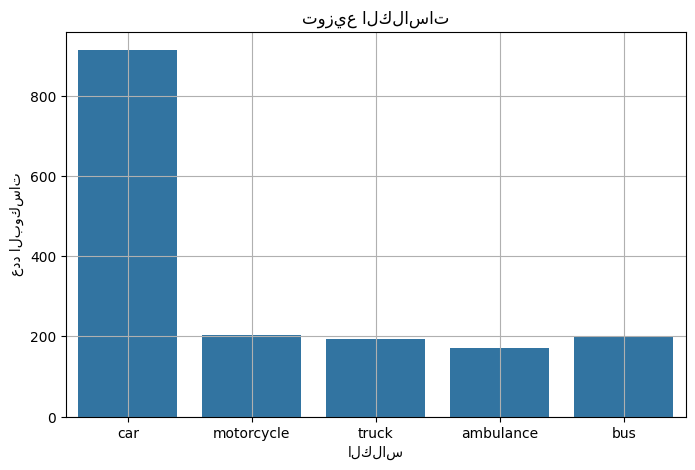

📊 النسب المئوية:
car: 914 (54.53%)
motorcycle: 202 (12.05%)
truck: 192 (11.46%)
ambulance: 170 (10.14%)
bus: 198 (11.81%)


In [ ]:
import os
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
import cv2

# المسارات
images_dir = '/content/vehicle_data/VehiclesDetectionDataset/train/images'
labels_dir = '/content/vehicle_data/VehiclesDetectionDataset/train/labels'

# إحصائيات
num_images = len([f for f in os.listdir(images_dir) if f.endswith(('.jpg', '.png', '.jpeg'))])
num_labels = len([f for f in os.listdir(labels_dir) if f.endswith('.txt')])

print(f"📷 عدد الصور: {num_images}")
print(f"📝 عدد ملفات : {num_labels}")

# تحليل عدد الكلاسات
class_counts = Counter()

for label_file in os.listdir(labels_dir):
    with open(os.path.join(labels_dir, label_file), 'r') as f:
        lines = f.readlines()
        for line in lines:
            class_id = int(line.strip().split()[0])
            class_counts[class_id] += 1

# أسماء الكلاسات (من ملف data.yaml أو من ترتيبك)
class_names = ['ambulance', 'bus', 'car', 'motorcycle', 'truck']
total_labels = sum(class_counts.values())

# رسم التوزيع
plt.figure(figsize=(8,5))
sns.barplot(x=[class_names[c] for c in class_counts.keys()], y=class_counts.values())
plt.title("توزيع الكلاسات")
plt.xlabel("الكلاس")
plt.ylabel("عدد البوكسات")
plt.grid(True)
plt.show()

# طباعة النسب
print("📊 النسب المئوية:")
for class_id, count in class_counts.items():
    percentage = (count / total_labels) * 100
    print(f"{class_names[class_id]}: {count} ({percentage:.2f}%)")


In [ ]:
!pip install albumentations



📊 توزيع الكلاسات الأصلي:
ambulance: 170
bus: 198
car: 914
motorcycle: 202
truck: 192


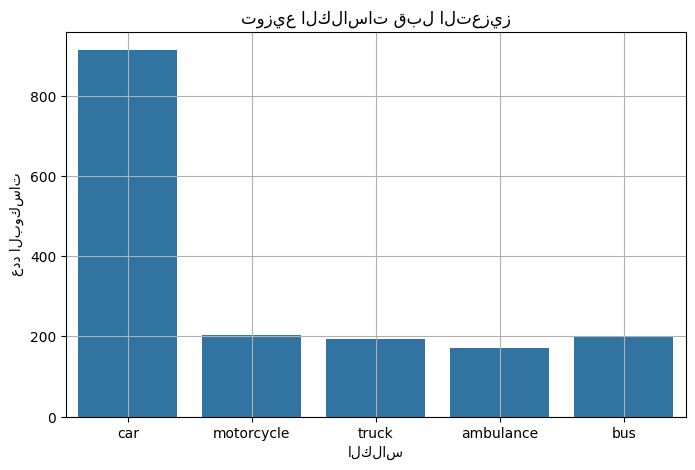


✅ تم إنشاء الصور المعززة في:
/content/augmented_dataset/images


In [ ]:
# تثبيت المكتبة
!pip install albumentations --quiet

# استيراد المكتبات
import os
import cv2
import random
import shutil
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
import albumentations as A

# إعداد المسارات
original_images_dir = '/content/vehicle_data/VehiclesDetectionDataset/train/images'
original_labels_dir = '/content/vehicle_data/VehiclesDetectionDataset/train/labels'
augmented_images_dir = '/content/augmented_dataset/images'
augmented_labels_dir = '/content/augmented_dataset/labels'

# إنشاء مجلدات جديدة
os.makedirs(augmented_images_dir, exist_ok=True)
os.makedirs(augmented_labels_dir, exist_ok=True)

# توزيع الكلاسات
class_counts = Counter()
class_names = ['ambulance', 'bus', 'car', 'motorcycle', 'truck']
target_count = 914  # عدد صور الكلاس الأكبر

# تحليل البيانات الأصلية
for label_file in os.listdir(original_labels_dir):
    with open(os.path.join(original_labels_dir, label_file), 'r') as f:
        for line in f.readlines():
            class_id = int(line.strip().split()[0])
            class_counts[class_id] += 1

print("📊 توزيع الكلاسات الأصلي:")
for cid in sorted(class_counts):
    print(f"{class_names[cid]}: {class_counts[cid]}")

# رسم التوزيع
plt.figure(figsize=(8,5))
sns.barplot(x=[class_names[c] for c in class_counts.keys()], y=class_counts.values())
plt.title("توزيع الكلاسات قبل التعزيز")
plt.xlabel("الكلاس")
plt.ylabel("عدد البوكسات")
plt.grid(True)
plt.show()

# إعداد التحويلات
transform = A.Compose([
    A.RandomBrightnessContrast(p=0.5),
    A.HorizontalFlip(p=0.5),
    A.Rotate(limit=15, p=0.5),
    A.RandomScale(scale_limit=0.2, p=0.3),
], bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels']))

# دالة لتوليد صور معززة
def augment_image(image_path, label_path, save_prefix, augment_count):
    img = cv2.imread(image_path)
    h, w = img.shape[:2]

    with open(label_path, 'r') as f:
        bboxes = []
        labels = []
        for line in f.readlines():
            parts = line.strip().split()
            class_id = int(parts[0])
            bbox = list(map(float, parts[1:]))
            bboxes.append(bbox)
            labels.append(class_id)

    for i in range(augment_count):
        transformed = transform(image=img, bboxes=bboxes, class_labels=labels)
        aug_img = transformed['image']
        aug_bboxes = transformed['bboxes']
        aug_labels = transformed['class_labels']

        # حفظ الصورة الجديدة
        new_img_name = f"{save_prefix}_aug{i}.jpg"
        cv2.imwrite(os.path.join(augmented_images_dir, new_img_name), aug_img)

        # حفظ الملف النصي الجديد
        with open(os.path.join(augmented_labels_dir, new_img_name.replace('.jpg', '.txt')), 'w') as f:
            for cls, bbox in zip(aug_labels, aug_bboxes):
                f.write(f"{cls} {' '.join(map(str, bbox))}\n")

# تطبيق التعزيز للكلاسات الضعيفة
for label_file in os.listdir(original_labels_dir):
    label_path = os.path.join(original_labels_dir, label_file)
    image_path = os.path.join(original_images_dir, label_file.replace('.txt', '.jpg'))

    with open(label_path, 'r') as f:
        lines = f.readlines()
        classes_in_file = [int(line.strip().split()[0]) for line in lines]

    for cls in set(classes_in_file):
        current_count = class_counts[cls]
        if current_count < target_count:
            extra_needed = target_count - current_count
            augment_times = min(extra_needed, 5)  # تعزيز محدود لكل صورة
            augment_image(image_path, label_path, label_file.replace('.txt', ''), augment_times)
            class_counts[cls] += augment_times

print("\n✅ تم إنشاء الصور المعززة في:")
print(augmented_images_dir)


📊 التوزيع بعد التعزيز:
ambulance: 850 (22.32%)
truck: 960 (25.20%)
bus: 990 (25.99%)
motorcycle: 1009 (26.49%)


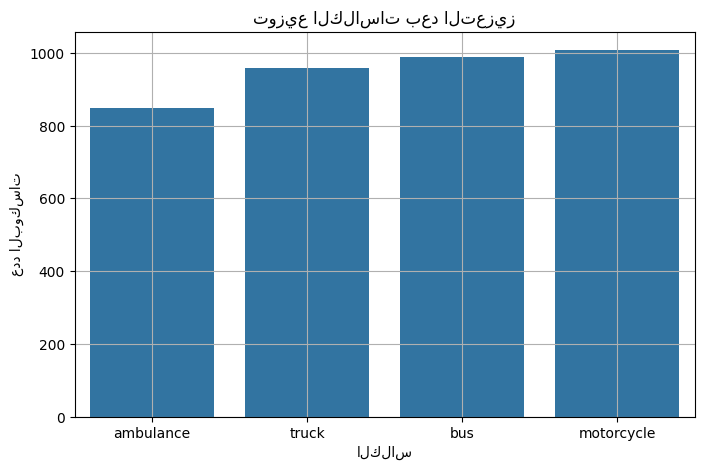

In [ ]:
import os
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter

# مسار ملفات اللابل الجديدة
augmented_labels_dir = '/content/augmented_dataset/labels'

# إعادة حساب التوزيع بعد التعزيز
augmented_class_counts = Counter()
class_names = ['ambulance', 'bus', 'car', 'motorcycle', 'truck']

for label_file in os.listdir(augmented_labels_dir):
    if not label_file.endswith('.txt'):
        continue
    with open(os.path.join(augmented_labels_dir, label_file), 'r') as f:
        for line in f.readlines():
            class_id = int(float(line.strip().split()[0]))
            augmented_class_counts[class_id] += 1

# حساب المجموع والنسب
total_labels_augmented = sum(augmented_class_counts.values())

# طباعة التوزيع بعد التعزيز
print("📊 التوزيع بعد التعزيز:")
for class_id, count in augmented_class_counts.items():
    percentage = (count / total_labels_augmented) * 100
    print(f"{class_names[class_id]}: {count} ({percentage:.2f}%)")

# رسم المخطط البياني
plt.figure(figsize=(8,5))
sns.barplot(
    x=[class_names[c] for c in augmented_class_counts.keys()],
    y=[augmented_class_counts[c] for c in augmented_class_counts.keys()]
)
plt.title("توزيع الكلاسات بعد التعزيز")
plt.xlabel("الكلاس")
plt.ylabel("عدد البوكسات")
plt.grid(True)
plt.show()


In [ ]:
with open("augmented_data.yaml", "w") as f:
    f.write(
        f"""
train: /content/augmented_dataset/images
val: /content/vehicle_data/VehiclesDetectionDataset/valid/images
test: /content/vehicle_data/VehiclesDetectionDataset/test/images

nc: 5
names: ['ambulance', 'bus', 'car', 'motorcycle', 'truck']
"""
)

In [ ]:
from ultralytics import YOLO

# تحميل النموذج المدرب مسبقًا
model = YOLO("yolov8n.pt")  # أو أي نموذج آخر من اختيارك


In [ ]:
from ultralytics import YOLO

# تحميل النموذج الأصلي
model = YOLO("yolov8n.pt")

# تغيير عدد الكلاسات إلى 5
model.yaml['nc'] = 5   # تحديث طبقة الكائنات لعدد الكلاسات الجديد

# حفظ النموذج المعدل إذا كنت تريد استخدامه لاحقًا
model.save("yolov8_custom.pt")



In [ ]:
# تدريب النموذج
model.train(data='/content/augmented_data.yaml', epochs=100, batch=32, imgsz=800, lr0=0.01)


Ultralytics 8.3.130 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/augmented_data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=800, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train5, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrain

train: Scanning /content/augmented_dataset/labels... 2550 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2550/2550 [00:01<00:00, 1626.31it/s]

train: New cache created: /content/augmented_dataset/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 836.5±430.1 MB/s, size: 32.0 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]


Plotting labels to runs/detect/train5/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 800 train, 800 val
Using 8 dataloader workers
Logging results to runs/detect/train5
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      5.96G      1.203      2.825      1.685         88        800: 100%|██████████| 80/80 [00:33<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]

                   all        250        454      0.654      0.276      0.321      0.157



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      7.39G      1.166      2.022      1.626         55        800: 100%|██████████| 80/80 [00:32<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]

                   all        250        454      0.352      0.335      0.225      0.094



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      5.96G      1.173      1.751      1.627         73        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.24it/s]

                   all        250        454      0.321      0.288      0.168     0.0754



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      7.38G      1.176      1.644      1.632         62        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.445      0.286      0.196      0.107



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      5.96G      1.147      1.474      1.598         51        800: 100%|██████████| 80/80 [00:32<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.32it/s]

                   all        250        454      0.591      0.188      0.178     0.0829



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      7.38G      1.083      1.303       1.54         66        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.33it/s]

                   all        250        454      0.556      0.341      0.279      0.147



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      5.93G      1.051      1.184      1.503         82        800: 100%|██████████| 80/80 [00:33<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.34it/s]

                   all        250        454      0.729      0.343      0.398      0.222



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      7.35G      1.018      1.117      1.483         79        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.35it/s]

                   all        250        454      0.412      0.367      0.342      0.208



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      7.35G     0.9747       1.04      1.453         83        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.302      0.291      0.269      0.177



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      7.35G     0.9493      1.002      1.416         73        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.38it/s]

                   all        250        454       0.69      0.321      0.349      0.188



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      7.35G     0.9243     0.9583      1.405         73        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.36it/s]

                   all        250        454      0.594      0.392        0.4      0.241



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      7.36G     0.9006     0.9146       1.39         75        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.34it/s]

                   all        250        454      0.409      0.429      0.408      0.249



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      7.38G     0.8766     0.8703      1.364         58        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.36it/s]

                   all        250        454      0.438      0.409      0.402      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      5.97G     0.8511     0.8243       1.34         80        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]

                   all        250        454      0.396      0.413      0.368        0.2



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      5.93G     0.8634     0.8246      1.344         59        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.33it/s]

                   all        250        454      0.412       0.29      0.325      0.215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      7.35G     0.8045      0.771      1.303         66        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]

                   all        250        454      0.405      0.399      0.424      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      7.36G     0.8058     0.7531      1.305         57        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.31it/s]

                   all        250        454      0.643       0.45      0.401      0.262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      7.38G     0.7795     0.7223      1.275         75        800: 100%|██████████| 80/80 [00:33<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.36it/s]

                   all        250        454      0.461      0.365      0.388      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      5.92G     0.7656     0.7125      1.267         79        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.34it/s]

                   all        250        454      0.377      0.349      0.367      0.249



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      7.34G     0.7677     0.7161      1.278         56        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.35it/s]

                   all        250        454       0.35      0.422      0.376       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      7.35G     0.7504     0.6842      1.255         84        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.33it/s]

                   all        250        454      0.432      0.375      0.339      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      7.35G     0.7436     0.6882      1.251         76        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.36it/s]

                   all        250        454      0.402       0.41      0.378       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      7.35G     0.7259     0.6731      1.241         82        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.36it/s]

                   all        250        454       0.39      0.416      0.368      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      7.35G     0.7215     0.6429      1.239         74        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.36it/s]

                   all        250        454      0.443      0.425       0.38      0.259



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      7.35G     0.6894      0.628      1.206         74        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.32it/s]

                   all        250        454      0.403      0.414      0.386      0.259



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      7.37G     0.6939     0.6353      1.222         68        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.33it/s]

                   all        250        454       0.45      0.381      0.358      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      7.39G      0.674     0.6064      1.204         79        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.32it/s]

                   all        250        454      0.455      0.423      0.432      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100         6G     0.6791     0.5859      1.202         69        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.37it/s]

                   all        250        454      0.448      0.336      0.384      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      5.96G     0.6639     0.5761      1.187         74        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]

                   all        250        454      0.417      0.383      0.372      0.238



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      7.38G     0.6543     0.5656      1.183         85        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.316      0.413      0.318      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      5.92G     0.6457     0.5682      1.175         72        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.39it/s]

                   all        250        454      0.485      0.449      0.454      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      7.34G     0.6312     0.5479      1.169         74        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.475      0.429      0.444      0.296



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      7.36G     0.6259      0.543      1.161         81        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.38it/s]

                   all        250        454       0.45      0.425       0.41      0.285



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      7.36G     0.6373      0.545      1.175         73        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.37it/s]

                   all        250        454      0.433      0.417      0.396       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      7.36G     0.6236     0.5396      1.161         78        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.456      0.363      0.413       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      7.38G     0.6137      0.523      1.156         72        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.463      0.476      0.463      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      5.99G     0.6034     0.5128      1.149         80        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.387      0.439      0.392      0.274



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      5.93G      0.601     0.5157      1.144         65        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.36it/s]

                   all        250        454      0.556      0.386      0.424      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      7.35G     0.5927     0.5093      1.136         70        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]

                   all        250        454      0.409      0.462      0.416      0.288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      7.35G     0.5904     0.4901       1.13         68        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]

                   all        250        454      0.442      0.399      0.383      0.271



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      7.35G     0.5709     0.4918       1.13         68        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.518      0.383      0.427       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      7.35G     0.5648     0.4759      1.127         76        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.508      0.336      0.398      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      7.35G     0.5725     0.4803      1.127         76        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.644      0.371       0.43      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      7.37G     0.5592     0.4766      1.119         72        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]

                   all        250        454      0.446      0.395      0.393      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      7.38G     0.5611     0.4593      1.123         86        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.397      0.428      0.402      0.276



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      5.93G     0.5587     0.4724      1.119         62        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.43it/s]

                   all        250        454      0.381      0.413      0.394      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      7.34G     0.5532     0.4619      1.109         76        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.34it/s]

                   all        250        454      0.508      0.398      0.426      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      7.36G     0.5557     0.4557      1.115         77        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.509      0.383      0.433      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      7.36G     0.5295     0.4418      1.099         62        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.515      0.394      0.416      0.291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      7.38G     0.5297     0.4399      1.092         69        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.482      0.474       0.42      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      5.99G     0.5316     0.4356      1.095         83        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.39it/s]

                   all        250        454      0.495      0.363      0.411      0.304



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100         6G     0.5462     0.4454      1.099         53        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.39it/s]

                   all        250        454      0.449      0.406      0.411      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100         6G     0.5225     0.4278       1.09         62        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.43it/s]

                   all        250        454      0.505      0.397      0.427      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      5.92G     0.5217     0.4276      1.083         70        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.43it/s]

                   all        250        454      0.456      0.426      0.415      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      7.34G      0.506     0.4183      1.084         64        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.418      0.447      0.443      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      7.34G     0.5074     0.4202      1.085         86        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]

                   all        250        454      0.466      0.433      0.421        0.3



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      7.34G     0.4987     0.4084      1.069         67        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.506      0.418      0.448      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      7.34G     0.4962     0.4023      1.067         69        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]

                   all        250        454      0.476      0.399      0.424      0.298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      7.34G     0.4851     0.3981      1.062         59        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454       0.52      0.349      0.397      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      7.34G     0.4814     0.3989      1.063         80        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.39it/s]

                   all        250        454      0.462      0.381      0.391      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      7.34G     0.4815     0.3995      1.067         91        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.43it/s]

                   all        250        454      0.416       0.47      0.422      0.309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      7.34G     0.4664     0.3773      1.052         65        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.44it/s]

                   all        250        454      0.492      0.343       0.39      0.297



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      7.34G     0.4724      0.382      1.055         77        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.39it/s]

                   all        250        454      0.506      0.396      0.453       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      7.34G     0.4695     0.3777      1.053         51        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.476      0.399        0.4      0.292



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      7.36G      0.464     0.3774      1.053         72        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.37it/s]

                   all        250        454      0.444      0.398      0.409      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      7.38G       0.46     0.3722       1.05         83        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.431      0.427      0.412      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      5.92G      0.455     0.3668      1.044         53        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.422      0.397      0.409      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      7.34G     0.4415     0.3557      1.031         83        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.39it/s]

                   all        250        454      0.492       0.38      0.433      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      7.34G     0.4441     0.3646      1.043         74        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]

                   all        250        454      0.526      0.366      0.406      0.298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      7.34G      0.447     0.3609      1.044         68        800: 100%|██████████| 80/80 [00:33<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.39it/s]

                   all        250        454       0.47      0.387      0.401      0.296



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      7.34G     0.4444     0.3593      1.038         69        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.458      0.433      0.436      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      7.34G     0.4371     0.3545      1.035         74        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.436      0.381      0.413      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      7.34G     0.4368     0.3499      1.031         65        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.405      0.451       0.42      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      7.34G     0.4358     0.3527      1.034         65        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.44it/s]

                   all        250        454      0.532      0.362      0.418      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      7.34G     0.4295      0.343      1.026         79        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.504      0.385      0.422      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      7.34G     0.4298     0.3422      1.027         62        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.39it/s]

                   all        250        454      0.402      0.425      0.399      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      7.34G     0.4168     0.3387      1.017         72        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.494      0.418      0.433      0.318



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      7.34G     0.4165     0.3318       1.02         65        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.542      0.334      0.392      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      7.34G     0.4135     0.3385      1.015         70        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.43it/s]

                   all        250        454      0.397      0.477      0.414      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      7.34G     0.4079     0.3292      1.012         74        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.38it/s]

                   all        250        454      0.471      0.399      0.426      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      7.34G      0.407     0.3246      1.012         78        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.44it/s]

                   all        250        454      0.476      0.382      0.395      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      7.34G     0.3939     0.3142      1.005         59        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.44it/s]

                   all        250        454      0.477       0.39      0.409      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      7.34G     0.3993     0.3226      1.014         73        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.44it/s]

                   all        250        454      0.451      0.401      0.412      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      7.34G     0.3932     0.3153      1.004         82        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.521      0.389      0.433      0.318



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      7.34G     0.3868      0.309      1.006         73        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.44it/s]

                   all        250        454      0.468      0.407      0.422      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      7.34G     0.3818     0.3079     0.9993         60        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.381      0.458      0.425      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      7.34G     0.3886     0.3138      1.001         62        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.417       0.42      0.407      0.298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      7.34G     0.3772     0.3051     0.9983         74        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.502      0.384      0.423      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      7.34G     0.3835     0.3111      1.002         66        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]

                   all        250        454      0.502      0.371      0.428      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      7.34G     0.3778      0.302     0.9952         87        800: 100%|██████████| 80/80 [00:33<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]

                   all        250        454      0.498      0.414      0.427      0.316


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      7.34G     0.3345     0.2574     0.9658         28        800: 100%|██████████| 80/80 [00:34<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.38it/s]

                   all        250        454      0.435      0.472      0.422      0.309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      7.36G     0.3221     0.2425     0.9552         29        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.38it/s]

                   all        250        454      0.462      0.474      0.444      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      7.38G     0.3114     0.2313     0.9492         25        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.44it/s]

                   all        250        454      0.467      0.478      0.442      0.319



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100       5.9G     0.3071     0.2313     0.9536         31        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]

                   all        250        454      0.434      0.451      0.431      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100       7.3G     0.3036     0.2301     0.9424         29        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.438      0.455      0.431      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100       7.3G     0.2994     0.2243     0.9403         36        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.43it/s]

                   all        250        454      0.444      0.461      0.441      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100       7.3G     0.2882     0.2169     0.9348         27        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]

                   all        250        454      0.512      0.405       0.43      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100       7.3G     0.2802     0.2166     0.9256         28        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.44it/s]

                   all        250        454      0.462       0.42      0.418      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100       7.3G     0.2833     0.2124     0.9303         33        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.42it/s]

                   all        250        454      0.493      0.418      0.426      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      7.31G     0.2803      0.213     0.9291         42        800: 100%|██████████| 80/80 [00:32<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.45it/s]

                   all        250        454      0.505       0.41      0.435      0.322



100 epochs completed in 0.974 hours.
Optimizer stripped from runs/detect/train5/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train5/weights/best.pt, 6.3MB

Validating runs/detect/train5/weights/best.pt...
Ultralytics 8.3.130 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.70it/s]


                   all        250        454      0.444      0.461      0.441      0.327
             ambulance         50         64      0.668      0.819      0.815      0.676
                   bus         30         46      0.579      0.565      0.634      0.524
                   car         90        238          0          0          0          0
            motorcycle         42         46      0.515      0.522      0.438      0.238
                 truck         38         60      0.459        0.4      0.318      0.197
Speed: 0.3ms preprocess, 3.6ms inference, 0.0ms loss, 2.4ms postprocess per image
Results saved to runs/detect/train5


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7aed4a005f90>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
import os
import shutil

# Define paths
images_dir = '/content/vehicle_data/VehiclesDetectionDataset/train/images'
labels_dir = '/content/vehicle_data/VehiclesDetectionDataset/train/labels'
augmented_images_dir = '/content/augmented_dataset/images'
augmented_labels_dir = '/content/augmented_dataset/labels'

# Ensure the augmented dataset directories exist
os.makedirs(augmented_images_dir, exist_ok=True)
os.makedirs(augmented_labels_dir, exist_ok=True)

# Loop through all label files and move car class images and labels
for label_file in os.listdir(labels_dir):
    label_path = os.path.join(labels_dir, label_file)

    # Only process text files (label files)
    if label_file.endswith('.txt'):
        with open(label_path, 'r') as f:
            lines = f.readlines()

        # Check if any line in the label file corresponds to the "car" class (class_id=2)
        for line in lines:
            class_id = int(line.strip().split()[0])
            if class_id == 2:  # "car" class is usually class_id 2 (verify if this is correct in your case)
                # Get the image file name from the label file
                image_name = label_file.replace('.txt', '.jpg')  # Assuming the image is in .jpg format

                # Define the image and label paths
                image_path = os.path.join(images_dir, image_name)
                new_image_path = os.path.join(augmented_images_dir, image_name)
                new_label_path = os.path.join(augmented_labels_dir, label_file)

                # Move the image and label file to the augmented dataset
                if os.path.exists(image_path):
                    shutil.move(image_path, new_image_path)
                    shutil.move(label_path, new_label_path)
                    print(f"Moved {image_name} and {label_file} to augmented dataset.")


Moved 7845ed5a26cb9fd4_jpg.rf.yC0A3ocskag7uNg55UcR.jpg and 7845ed5a26cb9fd4_jpg.rf.yC0A3ocskag7uNg55UcR.txt to augmented dataset.
Moved 53b558dba2201be2_jpg.rf.5MioCgNbDv3EtMDMsOJb.jpg and 53b558dba2201be2_jpg.rf.5MioCgNbDv3EtMDMsOJb.txt to augmented dataset.
Moved a6bae981a16ab9a6_jpg.rf.51773282f8cc4691c58f8f1929949c3b.jpg and a6bae981a16ab9a6_jpg.rf.51773282f8cc4691c58f8f1929949c3b.txt to augmented dataset.
Moved db8edd501003ee7d_jpg.rf.nQDmxqSL0xIOgOjfuZz0.jpg and db8edd501003ee7d_jpg.rf.nQDmxqSL0xIOgOjfuZz0.txt to augmented dataset.
Moved 27fed64f6e8e0fb1_jpg.rf.365f036b3c5c98218829c2b839a9bbe9.jpg and 27fed64f6e8e0fb1_jpg.rf.365f036b3c5c98218829c2b839a9bbe9.txt to augmented dataset.
Moved 0da0ba0e59845f96_jpg.rf.1e971f58853bc9f66b60785fd0a39791.jpg and 0da0ba0e59845f96_jpg.rf.1e971f58853bc9f66b60785fd0a39791.txt to augmented dataset.
Moved 4039b64d9f2b5291_jpg.rf.aYdrPQN4sX0ZiVKnT2gv.jpg and 4039b64d9f2b5291_jpg.rf.aYdrPQN4sX0ZiVKnT2gv.txt to augmented dataset.
Moved d19f3557d131

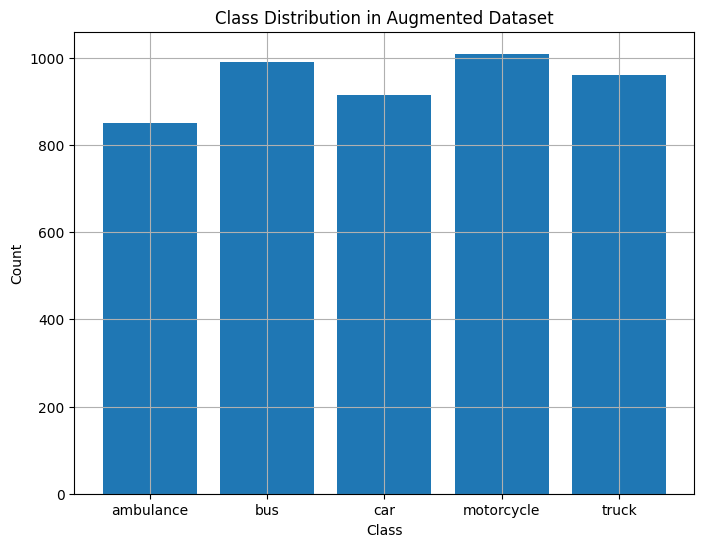

Class ambulance: 850 labels
Class truck: 960 labels
Class bus: 990 labels
Class motorcycle: 1009 labels
Class car: 914 labels


In [ ]:
import os
import matplotlib.pyplot as plt
from collections import Counter

# Path to the augmented labels directory
augmented_labels_dir = '/content/augmented_dataset/labels'

# Dictionary to store class counts
class_counts = Counter()

# Loop through all label files in the augmented dataset labels directory
for label_file in os.listdir(augmented_labels_dir):
    if label_file.endswith('.txt'):
        label_path = os.path.join(augmented_labels_dir, label_file)
        with open(label_path, 'r') as f:
            lines = f.readlines()
            for line in lines:
                # Handle potential float and convert to integer
                try:
                    class_id = int(float(line.strip().split()[0]))  # Convert to float first, then to int
                    class_counts[class_id] += 1
                except ValueError:
                    # Skip lines with invalid data
                    continue

# Define class names (adjust these based on your dataset classes)
class_names = ['ambulance', 'bus', 'car', 'motorcycle', 'truck']

# Plot the distribution of classes
plt.figure(figsize=(8, 6))
plt.bar(class_names, [class_counts.get(i, 0) for i in range(len(class_names))])
plt.title('Class Distribution in Augmented Dataset')
plt.xlabel('Class')
plt.ylabel('Count')
plt.grid(True)
plt.show()

# Print the count for each class
for class_id, count in class_counts.items():
    print(f"Class {class_names[class_id]}: {count} labels")


In [ ]:
with open("augmented_data.yaml", "w") as f:
    f.write(
        f"""
train: /content/augmented_dataset/images
val: /content/vehicle_data/VehiclesDetectionDataset/valid/images
test: /content/vehicle_data/VehiclesDetectionDataset/test/images

nc: 5
names: ['ambulance', 'bus', 'car', 'motorcycle', 'truck']
"""
)

In [ ]:
model.train(
    data='/content/augmented_data.yaml',
    epochs=100,
    batch=64,
    imgsz=800,
    lr0=0.0001,  # Starting learning rate
    lrf=0.1,  # Final learning rate (e.g., 0.1 for smaller learning rates at the end)
)


Ultralytics 8.3.130 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=64, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/augmented_data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=800, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.0001, lrf=0.1, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train52, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretra

train: Scanning /content/augmented_dataset/labels... 2918 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2918/2918 [00:01<00:00, 1572.11it/s]

train: New cache created: /content/augmented_dataset/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 333.4±259.3 MB/s, size: 32.0 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]


Plotting labels to runs/detect/train52/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 800 train, 800 val
Using 8 dataloader workers
Logging results to runs/detect/train52
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      11.7G     0.4587     0.7045       1.05        125        800: 100%|██████████| 46/46 [00:39<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.08it/s]

                   all        250        454      0.655      0.272      0.306      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      11.7G     0.5149      0.599      1.075        118        800: 100%|██████████| 46/46 [00:37<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.17it/s]

                   all        250        454      0.467      0.485       0.46      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      11.8G     0.5841     0.6233      1.123        131        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.07it/s]

                   all        250        454       0.53      0.487      0.451      0.274



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      11.2G     0.6345     0.6419      1.148        132        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.17it/s]

                   all        250        454      0.482      0.304      0.318      0.174



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      11.8G     0.6378     0.6147      1.155        126        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.11it/s]

                   all        250        454      0.418      0.418      0.341       0.22



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      11.4G     0.6374     0.6068      1.147        136        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.449      0.416      0.417      0.262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      11.7G      0.625     0.5868      1.144        137        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.424      0.406      0.383      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      11.7G     0.6411     0.6161      1.159        128        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454       0.57       0.39       0.41      0.261



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      11.7G     0.6258     0.5889      1.148        109        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.16it/s]

                   all        250        454      0.345      0.397      0.345      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      11.7G      0.638     0.5988      1.153        139        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.531      0.427      0.444       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      11.7G     0.6289     0.5771       1.15        137        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.482       0.48      0.437      0.291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      11.7G     0.6178     0.5636      1.135        124        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.506       0.45      0.409      0.276



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      11.7G     0.6033     0.5496      1.123        129        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.507      0.388      0.393      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      11.6G     0.6182     0.5464      1.138        131        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.17it/s]

                   all        250        454      0.621      0.402      0.428      0.277



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      11.7G     0.6027     0.5369      1.126        112        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.17it/s]

                   all        250        454      0.489      0.411      0.427      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      11.7G     0.6066     0.5414      1.125        122        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.17it/s]

                   all        250        454      0.622      0.418      0.455        0.3



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      11.7G     0.5988     0.5261      1.121        137        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.476      0.381      0.383      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      11.7G     0.5795      0.511      1.119        128        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.16it/s]

                   all        250        454      0.501      0.451       0.41       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      11.7G     0.5894      0.513      1.111        142        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.612      0.379      0.429      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      11.7G     0.5809     0.5132       1.11        124        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.515      0.445       0.44      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      11.7G     0.5731     0.4955      1.101        126        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.498      0.461      0.419      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      11.8G     0.5648     0.4909        1.1        134        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.07it/s]

                   all        250        454      0.454      0.532      0.482       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      11.3G     0.5562     0.4835      1.095        115        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.15it/s]

                   all        250        454      0.593      0.482      0.485      0.328



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      11.7G     0.5679     0.4778      1.095        103        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.535       0.42       0.43      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      11.8G      0.556     0.4836      1.095        114        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.06it/s]

                   all        250        454      0.557      0.427      0.452      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      11.2G     0.5518     0.4714      1.089        151        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.525      0.497      0.469      0.315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      11.8G     0.5445      0.468       1.08        120        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.09it/s]

                   all        250        454      0.643      0.411      0.456      0.302



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      11.3G     0.5456     0.4661      1.078        136        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.681      0.423      0.476      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      11.7G     0.5408     0.4638      1.081        115        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.531      0.545       0.49      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      11.7G     0.5374     0.4484      1.079        125        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.15it/s]

                   all        250        454      0.534      0.456      0.444      0.291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      11.7G     0.5333     0.4551      1.078        126        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.708      0.471      0.525      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      11.7G     0.5234      0.443      1.071        123        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.16it/s]

                   all        250        454      0.616      0.442      0.486      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      11.7G     0.5289     0.4402      1.072        132        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.651      0.362      0.408      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      11.7G     0.5239     0.4411      1.072        132        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.21it/s]

                   all        250        454       0.57      0.437      0.466      0.337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      11.7G     0.5162     0.4293      1.059        115        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.571      0.479      0.478      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      11.6G     0.5215      0.427      1.066        115        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.607      0.484      0.502      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      11.8G     0.5102     0.4351      1.066        103        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.06it/s]

                   all        250        454      0.676      0.464      0.517      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      11.2G      0.508     0.4246      1.059        121        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.455       0.52      0.473      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      11.8G     0.5055     0.4243      1.061        140        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.10it/s]

                   all        250        454      0.638      0.421      0.454      0.318



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      11.2G     0.5013     0.4173      1.059        160        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.513      0.448       0.46       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      11.7G      0.497      0.414      1.053        126        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454       0.51      0.513      0.465      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      11.7G     0.4912     0.4098      1.044        134        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.573      0.518      0.516      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      11.8G     0.4946     0.4061      1.048        139        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.07it/s]

                   all        250        454      0.578      0.401      0.441      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      11.2G     0.4898     0.4091      1.049        115        800: 100%|██████████| 46/46 [00:37<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.17it/s]

                   all        250        454      0.449      0.518      0.467      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      11.7G      0.484     0.4015      1.042        111        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454       0.61      0.506      0.516      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      11.8G     0.4873     0.4016      1.045        129        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.10it/s]

                   all        250        454      0.547      0.423      0.441      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      11.1G     0.4727     0.3908      1.037        120        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.558      0.439      0.426      0.302



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      11.8G     0.4831     0.3965       1.04        116        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.07it/s]

                   all        250        454      0.603      0.471      0.447      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      11.3G     0.4661     0.3858      1.032        128        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.647      0.449       0.48      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      11.7G      0.475     0.3809      1.035        141        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.653      0.506      0.518      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      11.8G      0.472     0.3873      1.035        157        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.07it/s]

                   all        250        454      0.599      0.468      0.501      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      11.2G     0.4678      0.383      1.036        125        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.681       0.48      0.519      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      11.8G     0.4611      0.375      1.032        139        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.06it/s]

                   all        250        454      0.633       0.48      0.517      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      11.3G     0.4501     0.3705      1.024        133        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.581      0.586      0.533       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      11.7G     0.4506     0.3695      1.026        129        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.635      0.467      0.499       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      11.7G     0.4521     0.3734       1.02        122        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.614      0.431      0.472      0.337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      11.7G     0.4495     0.3698      1.024        134        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.698      0.475      0.544      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      11.8G     0.4495     0.3643      1.022        133        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.07it/s]

                   all        250        454      0.596      0.512      0.519      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      11.2G     0.4344     0.3556      1.012        123        800: 100%|██████████| 46/46 [00:37<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.607      0.532      0.529      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      11.8G     0.4281     0.3504      1.009        129        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.11it/s]

                   all        250        454      0.548      0.531      0.509      0.378



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      11.3G     0.4358     0.3568      1.013        115        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.635      0.519      0.512       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      11.8G     0.4336     0.3569      1.014        106        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.07it/s]

                   all        250        454       0.55      0.525      0.526      0.391



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      11.3G     0.4341     0.3569      1.015        129        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.623       0.52      0.536      0.391



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      11.7G     0.4237     0.3511      1.009        133        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.15it/s]

                   all        250        454      0.729      0.475       0.53      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      11.7G     0.4278      0.346      1.009        117        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454       0.64      0.485      0.503      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      11.6G     0.4158     0.3333      1.004        145        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.21it/s]

                   all        250        454      0.632      0.516      0.532       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      11.7G     0.4268      0.341      1.003        133        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.726      0.481      0.529      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      11.7G     0.4198     0.3385      1.004        140        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.679      0.498      0.508      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      11.7G     0.4169     0.3351          1        129        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.586      0.507      0.528      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      11.7G     0.4122     0.3364          1        183        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454       0.64      0.489      0.531      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      11.7G     0.4068     0.3282     0.9929        120        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.693      0.434      0.497      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      11.7G     0.4073     0.3306          1        107        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.17it/s]

                   all        250        454      0.617      0.493      0.522      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      11.7G     0.4044     0.3257     0.9939        130        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454       0.66      0.527      0.549      0.399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      11.6G     0.4033     0.3269     0.9959        115        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.674      0.481      0.531      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      11.7G     0.3913     0.3163     0.9908        112        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.625      0.511       0.53      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      11.7G     0.3976     0.3187     0.9866        111        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.668      0.518      0.534      0.381



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      11.8G     0.3932     0.3136     0.9857        118        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.09it/s]

                   all        250        454       0.63       0.49      0.524       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      11.3G     0.3879     0.3117     0.9804        118        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.621      0.498       0.51      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      11.7G     0.3908     0.3149     0.9857        106        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.15it/s]

                   all        250        454        0.7      0.451      0.514      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      11.7G     0.3932     0.3167     0.9889        142        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.618      0.488      0.517      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      11.7G     0.3837     0.3139     0.9838        127        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.713      0.536      0.552      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      11.7G     0.3813     0.3096     0.9838        111        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.713       0.45      0.548      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      11.7G     0.3802     0.3073     0.9816        118        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.672       0.48      0.536      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      11.6G     0.3825     0.3015     0.9765        116        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.593      0.535       0.53      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      11.7G     0.3705     0.3028     0.9767        137        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.22it/s]

                   all        250        454      0.619      0.488      0.521      0.381



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      11.7G     0.3794     0.3044     0.9777        124        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.17it/s]

                   all        250        454       0.63      0.486      0.515      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      11.8G     0.3807     0.3092     0.9773        129        800: 100%|██████████| 46/46 [00:37<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.10it/s]

                   all        250        454      0.676      0.484      0.514      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      11.3G       0.37      0.298      0.975        157        800: 100%|██████████| 46/46 [00:37<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.655      0.522      0.546      0.398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      11.7G     0.3725     0.2995     0.9757        122        800: 100%|██████████| 46/46 [00:37<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.21it/s]

                   all        250        454      0.608      0.519      0.522      0.381



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      11.7G     0.3666     0.2922     0.9723        110        800: 100%|██████████| 46/46 [00:37<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.608      0.493      0.519      0.378


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      11.6G     0.3549      0.272     0.9599         63        800: 100%|██████████| 46/46 [00:40<00:00,  1.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.575      0.477      0.497      0.365



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      11.6G     0.3241     0.2431     0.9326         51        800: 100%|██████████| 46/46 [00:37<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.682       0.44      0.513       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      11.6G     0.3189     0.2388     0.9291         47        800: 100%|██████████| 46/46 [00:37<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.632      0.514      0.543      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      11.6G     0.3121     0.2306      0.926         57        800: 100%|██████████| 46/46 [00:37<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all        250        454      0.624      0.484      0.505      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      11.6G     0.3023     0.2259     0.9146         62        800: 100%|██████████| 46/46 [00:37<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.693      0.498      0.553      0.407



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      11.6G     0.2984     0.2228     0.9124         52        800: 100%|██████████| 46/46 [00:37<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all        250        454      0.597      0.519      0.549      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      11.7G     0.2918     0.2199     0.9168         60        800: 100%|██████████| 46/46 [00:37<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.17it/s]

                   all        250        454      0.674      0.529      0.549      0.407



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      11.6G     0.2948     0.2213     0.9174         50        800: 100%|██████████| 46/46 [00:37<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all        250        454      0.663      0.505      0.549      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      11.6G     0.2851     0.2172     0.9062         63        800: 100%|██████████| 46/46 [00:37<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.21it/s]

                   all        250        454      0.614      0.517       0.55      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      11.6G     0.2823     0.2148     0.9016         59        800: 100%|██████████| 46/46 [00:37<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.21it/s]

                   all        250        454      0.649      0.519      0.571      0.427



100 epochs completed in 1.110 hours.
Optimizer stripped from runs/detect/train52/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train52/weights/best.pt, 6.3MB

Validating runs/detect/train52/weights/best.pt...
Ultralytics 8.3.130 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.02it/s]


                   all        250        454      0.649       0.52       0.57      0.426
             ambulance         50         64      0.797       0.75      0.837      0.702
                   bus         30         46      0.725      0.696       0.71      0.572
                   car         90        238      0.472      0.513      0.441      0.298
            motorcycle         42         46      0.602      0.395      0.514      0.284
                 truck         38         60       0.65      0.248       0.35      0.277
Speed: 0.3ms preprocess, 4.2ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs/detect/train52


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7aeedefe1c90>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

part 6

freeze

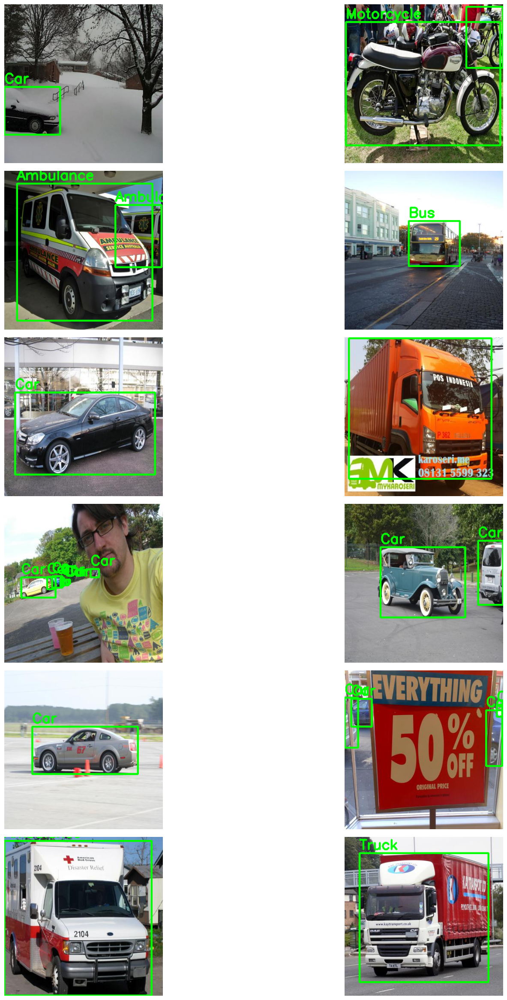

In [ ]:
from pathlib import Path

# Define dataset paths
base_path = Path('/content/vehicle_data/VehiclesDetectionDataset')
train_images = base_path / 'train/images'
train_labels = base_path / 'train/labels'
class_names = ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']

# Function to convert image filenames to label filenames
def JPG_Name_To_TXT(image_name):
    """Convert image filename to corresponding YOLO label filename."""
    return image_name.rsplit('.', 1)[0] + ".txt"

# Function to get image dimensions
def get_image_dimensions(img_path):
    """Returns height and width of an image."""
    img = cv2.imread(str(img_path))
    return img.shape[:2]  # (height, width)

# Function to convert YOLO TXT annotation to bounding box coordinates
def TXT_To_BBOX(txt_path, img_height, img_width):
    """Reads YOLO format TXT and converts it to (x_min, y_min, x_max, y_max, class_id)."""
    bboxes = []
    with open(txt_path, "r") as f:
        for line in f:
            parts = line.strip().split()
            class_id = int(parts[0])
            x_center, y_center, width, height = map(float, parts[1:])

            # Convert YOLO format to pixel coordinates
            x_min = int((x_center - width / 2) * img_width)
            y_min = int((y_center - height / 2) * img_height)
            x_max = int((x_center + width / 2) * img_width)
            y_max = int((y_center + height / 2) * img_height)

            bboxes.append((x_min, y_min, x_max, y_max, class_id))
    return bboxes

# Function to plot images with bounding boxes
def Plot_Random_Images():
    """Randomly selects images and plots them with their bounding boxes."""
    random_images = random.choices(list(train_images.iterdir()), k=12)

    plt.figure(figsize=(20, 30))  # Large figure size to make images bigger
    for i, img_path in enumerate(random_images, 1):
        plt.subplot(6, 2, i)  # 6 rows, 2 columns

        # Read the image
        img = cv2.imread(str(img_path))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Get the label path
        txt_name = JPG_Name_To_TXT(img_path.name)
        lbl_path = train_labels / txt_name

        if lbl_path.exists():  # Check if the label file exists
            img_height, img_width = get_image_dimensions(img_path)

            # Get bounding boxes
            bboxes = TXT_To_BBOX(lbl_path, img_height, img_width)

            # Draw bounding boxes
            for (x_min, y_min, x_max, y_max, class_id) in bboxes:
                color = (0, 255, 0)  # Green for bounding boxes
                cv2.rectangle(img, (x_min, y_min), (x_max, y_max), color, 3)
                cv2.putText(
                    img,
                    f"{class_names[class_id]}",
                    (x_min, y_min - 10),
                    cv2.FONT_HERSHEY_SIMPLEX,
                    1.2,
                    color,
                    3
                )

        plt.imshow(img)
        plt.axis('off')  # Hide axis for cleaner layout

    plt.subplots_adjust(wspace=0.05, hspace=0.05)  # Reduce space between images
    plt.show()

# Run the function
Plot_Random_Images()

In [ ]:
import yaml
# Define the dataset_path
dataset_path = '/content/vehicle_data/VehiclesDetectionDataset'

# Set the path to the YAML file
yaml_file_path = os.path.join(dataset_path, 'dataset.yaml')

# Load and print the contents of the YAML file
with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader=yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))

names:
- Ambulance
- Bus
- Car
- Motorcycle
- Truck
nc: 5
test: ../test/images
train: ../train/images
val: ../valid/images



In [ ]:
from PIL import Image

# Set paths for training and validation image sets
train_images_path = os.path.join(dataset_path, 'train', 'images')
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# Initialize counters for the number of images
num_train_images = 0
num_valid_images = 0

# Initialize sets to hold the unique sizes of images
train_image_sizes = set()
valid_image_sizes = set()

# Check train images sizes and count
for filename in os.listdir(train_images_path):
    if filename.endswith('.jpg'):
        num_train_images += 1
        image_path = os.path.join(train_images_path, filename)
        with Image.open(image_path) as img:
            train_image_sizes.add(img.size)

# Check validation images sizes and count
for filename in os.listdir(valid_images_path):
    if filename.endswith('.jpg'):
        num_valid_images += 1
        image_path = os.path.join(valid_images_path, filename)
        with Image.open(image_path) as img:
            valid_image_sizes.add(img.size)

# Print the results
print(f"Number of training images: {num_train_images}")
print(f"Number of validation images: {num_valid_images}")

# Check if all images in training set have the same size
if len(train_image_sizes) == 1:
    print(f"All training images have the same size: {train_image_sizes.pop()}")
else:
    print("Training images have varying sizes.")

# Check if all images in validation set have the same size
if len(valid_image_sizes) == 1:
    print(f"All validation images have the same size: {valid_image_sizes.pop()}")
else:
    print("Validation images have varying sizes.")

Number of training images: 878
Number of validation images: 250
All training images have the same size: (416, 416)
All validation images have the same size: (416, 416)


In [ ]:
from ultralytics import YOLO
model = YOLO("yolo11n.pt")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 5.35M/5.35M [00:00<00:00, 360MB/s]


In [ ]:
# Train the model on our custom dataset
results = model.train(
    data=yaml_file_path,     # Path to the dataset configuration file
    epochs=120,              # Number of epochs to train for
    imgsz=416,               # Size of input images as integer
    device=0,                # Device to run on, i.e. cuda device=0
    patience=150,             # Epochs to wait for no observable improvement for early stopping of training
    batch=32,                # Number of images per batch
    optimizer='auto',        # Optimizer to use, choices=[SGD, Adam, Adamax, AdamW, NAdam, RAdam, RMSProp, auto]
    lr0=0.001,              # Initial learning rate
    lrf=0.1,                 # Final learning rate (lr0 * lrf)
    dropout=0.3,             # Automatically restore best model# Use dropout regularization
    #freeze=20,               # first lets build from scrach
    seed=0                   # Random seed for reproducibility
)

Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/vehicle_data/VehiclesDetectionDataset/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.3, dynamic=False, embed=None, epochs=120, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=416, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.1, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=150, perspective=0.0, plot

100%|██████████| 755k/755k [00:00<00:00, 93.0MB/s]

Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True]           
  7                  -1  1    295424  ultralytics

YOLO11n summary: 181 layers, 2,590,815 parameters, 2,590,799 gradients, 6.4 GFLOPs

Transferred 448/499 items from pretrained weights
Freezing layer 'model.23.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 238.9±126.7 MB/s, size: 29.7 KB)


train: Scanning /content/vehicle_data/VehiclesDetectionDataset/train/labels... 878 images, 0 backgrounds, 0 corrupt: 100%|██████████| 878/878 [00:00<00:00, 1717.20it/s]

train: New cache created: /content/vehicle_data/VehiclesDetectionDataset/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 17.5±11.7 MB/s, size: 33.0 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<00:00, 714.75it/s]

val: New cache created: /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 416 train, 416 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 120 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/120      1.91G      1.101      3.229      1.293         56        416: 100%|██████████| 28/28 [00:10<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.34it/s]

                   all        250        454    0.00544      0.869       0.26      0.178



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/120      2.27G      1.195      2.482      1.365         53        416: 100%|██████████| 28/28 [00:07<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.83it/s]

                   all        250        454      0.751     0.0644      0.284      0.181



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/120      2.29G      1.235      2.124      1.377         46        416: 100%|██████████| 28/28 [00:07<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.83it/s]

                   all        250        454       0.33      0.155      0.146     0.0745



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/120       2.3G      1.235      2.023      1.361         40        416: 100%|██████████| 28/28 [00:08<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.65it/s]

                   all        250        454      0.215       0.28      0.216      0.148



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/120      2.32G      1.248      1.932       1.37         48        416: 100%|██████████| 28/28 [00:08<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.76it/s]

                   all        250        454      0.185      0.254      0.196      0.109



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/120      2.33G      1.259      1.917      1.387         49        416: 100%|██████████| 28/28 [00:08<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.48it/s]

                   all        250        454      0.256      0.336      0.187      0.125



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/120      2.35G      1.231      1.801      1.356         49        416: 100%|██████████| 28/28 [00:07<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.91it/s]

                   all        250        454       0.32      0.323      0.238      0.149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/120      2.36G      1.195      1.741       1.33         58        416: 100%|██████████| 28/28 [00:07<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.88it/s]

                   all        250        454      0.428      0.303      0.245       0.16



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/120      2.38G      1.194       1.66      1.325         69        416: 100%|██████████| 28/28 [00:08<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.88it/s]

                   all        250        454      0.466      0.407      0.364      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/120      2.39G      1.176      1.614       1.31         45        416: 100%|██████████| 28/28 [00:08<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.71it/s]

                   all        250        454       0.41      0.346      0.343      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/120       2.4G      1.112      1.542      1.275         47        416: 100%|██████████| 28/28 [00:08<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]

                   all        250        454      0.362      0.372      0.281      0.177



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/120      2.42G       1.13      1.507      1.281         49        416: 100%|██████████| 28/28 [00:07<00:00,  3.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.44it/s]

                   all        250        454      0.393      0.368      0.324      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/120      2.43G      1.102      1.473      1.261         56        416: 100%|██████████| 28/28 [00:08<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.83it/s]

                   all        250        454      0.613      0.402      0.451      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/120      2.45G      1.093      1.425      1.259         64        416: 100%|██████████| 28/28 [00:08<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.87it/s]

                   all        250        454      0.368      0.277      0.307       0.18



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/120      2.46G      1.078      1.397      1.256         50        416: 100%|██████████| 28/28 [00:08<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.68it/s]

                   all        250        454      0.677      0.367      0.447      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/120      2.48G      1.063      1.389      1.244         55        416: 100%|██████████| 28/28 [00:07<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.83it/s]

                   all        250        454      0.657      0.396      0.491      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/120      2.49G      1.059      1.332      1.249         58        416: 100%|██████████| 28/28 [00:07<00:00,  3.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.92it/s]

                   all        250        454      0.574      0.392       0.45      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/120      2.51G      1.038      1.294      1.232         66        416: 100%|██████████| 28/28 [00:08<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.79it/s]

                   all        250        454       0.47      0.482      0.453       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/120      2.52G      1.034      1.257      1.226         46        416: 100%|██████████| 28/28 [00:08<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.72it/s]

                   all        250        454      0.607      0.391      0.407       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/120      2.54G      1.029      1.284      1.232         42        416: 100%|██████████| 28/28 [00:08<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.49it/s]

                   all        250        454       0.62      0.422      0.479      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/120      2.55G      0.993      1.199      1.207         57        416: 100%|██████████| 28/28 [00:07<00:00,  3.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.97it/s]

                   all        250        454      0.519      0.466      0.471      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/120      2.57G      1.033      1.228      1.214         54        416: 100%|██████████| 28/28 [00:07<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.81it/s]

                   all        250        454      0.575      0.458      0.476      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/120      2.58G      1.006      1.185      1.209         56        416: 100%|██████████| 28/28 [00:08<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.74it/s]

                   all        250        454       0.65       0.44      0.496      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/120       2.6G      1.007      1.156      1.199         53        416: 100%|██████████| 28/28 [00:08<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.81it/s]

                   all        250        454      0.507      0.448      0.421      0.288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/120      2.61G      0.975      1.107      1.191         62        416: 100%|██████████| 28/28 [00:07<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.95it/s]

                   all        250        454      0.668      0.405      0.469      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/120      2.62G      0.967      1.121      1.188         65        416: 100%|██████████| 28/28 [00:07<00:00,  3.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.63it/s]

                   all        250        454      0.683      0.449      0.496      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/120      2.64G     0.9779      1.118      1.184         63        416: 100%|██████████| 28/28 [00:08<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.76it/s]

                   all        250        454      0.635      0.463      0.471      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/120      2.65G     0.9624      1.065      1.177         45        416: 100%|██████████| 28/28 [00:08<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.91it/s]

                   all        250        454      0.586      0.426      0.445      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/120      2.67G     0.9478      1.056      1.175         51        416: 100%|██████████| 28/28 [00:08<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.39it/s]

                   all        250        454       0.53      0.484      0.452      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/120      2.68G     0.9299      1.017      1.161         50        416: 100%|██████████| 28/28 [00:07<00:00,  3.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.66it/s]

                   all        250        454      0.464      0.422      0.401      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/120       2.7G     0.9235      1.039      1.163         39        416: 100%|██████████| 28/28 [00:08<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.96it/s]

                   all        250        454      0.558      0.561      0.536       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/120      2.71G     0.9211     0.9965       1.15         40        416: 100%|██████████| 28/28 [00:08<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.85it/s]

                   all        250        454      0.595      0.494      0.507      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/120      2.73G     0.9259      1.031      1.159         35        416: 100%|██████████| 28/28 [00:08<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.89it/s]

                   all        250        454      0.513       0.52      0.526      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/120      2.74G     0.9155     0.9888      1.158         39        416: 100%|██████████| 28/28 [00:07<00:00,  3.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.20it/s]

                   all        250        454      0.442      0.516      0.465      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/120      2.76G     0.9089     0.9815      1.143         32        416: 100%|██████████| 28/28 [00:07<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.58it/s]

                   all        250        454      0.526      0.529      0.512       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/120      2.77G     0.8987     0.9488      1.151         50        416: 100%|██████████| 28/28 [00:08<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.80it/s]

                   all        250        454      0.699      0.377      0.489      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/120      2.79G     0.8965     0.9937      1.146         55        416: 100%|██████████| 28/28 [00:08<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.95it/s]

                   all        250        454      0.501      0.559      0.522      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/120       2.8G     0.8886     0.9391      1.133         53        416: 100%|██████████| 28/28 [00:07<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.93it/s]

                   all        250        454      0.594      0.468      0.508      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/120      2.82G     0.9043     0.9191      1.133         66        416: 100%|██████████| 28/28 [00:07<00:00,  3.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.98it/s]

                   all        250        454      0.482      0.365       0.38      0.237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/120      2.83G     0.8769     0.9002      1.129         58        416: 100%|██████████| 28/28 [00:08<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.98it/s]

                   all        250        454      0.642      0.496      0.559      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/120      2.85G     0.8485     0.8864      1.113         71        416: 100%|██████████| 28/28 [00:08<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.50it/s]

                   all        250        454      0.731      0.413      0.519      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/120      2.86G     0.8646     0.8975       1.13         43        416: 100%|██████████| 28/28 [00:07<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.77it/s]

                   all        250        454      0.748      0.471      0.506      0.352



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/120      2.88G     0.8568     0.8915      1.126         61        416: 100%|██████████| 28/28 [00:07<00:00,  3.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.88it/s]

                   all        250        454      0.602      0.465      0.494      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/120      2.89G     0.8456     0.8656      1.109         53        416: 100%|██████████| 28/28 [00:09<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.40it/s]

                   all        250        454      0.566      0.498      0.511      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/120       2.9G     0.8647     0.8641      1.114         39        416: 100%|██████████| 28/28 [00:08<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.70it/s]

                   all        250        454      0.635      0.464      0.535      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/120      2.92G     0.8217      0.843      1.107         53        416: 100%|██████████| 28/28 [00:08<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.89it/s]

                   all        250        454      0.581      0.488      0.505      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/120      2.94G     0.8249     0.8261      1.096         48        416: 100%|██████████| 28/28 [00:07<00:00,  3.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]

                   all        250        454      0.576      0.526       0.53      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/120      2.95G      0.833     0.8116      1.099         58        416: 100%|██████████| 28/28 [00:08<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.83it/s]

                   all        250        454       0.63      0.439      0.499      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/120      2.96G     0.8224     0.8303      1.094         57        416: 100%|██████████| 28/28 [00:08<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.85it/s]

                   all        250        454      0.504      0.565      0.517      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/120      2.98G     0.8343     0.8514      1.103         52        416: 100%|██████████| 28/28 [00:08<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.81it/s]

                   all        250        454      0.666      0.568      0.578      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/120      2.99G     0.8095     0.8037      1.085         54        416: 100%|██████████| 28/28 [00:07<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.87it/s]

                   all        250        454      0.638      0.521      0.565      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/120      3.01G     0.8227     0.8242      1.093         61        416: 100%|██████████| 28/28 [00:07<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.88it/s]

                   all        250        454      0.662      0.449      0.516      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/120      3.02G     0.8215     0.7961      1.085         48        416: 100%|██████████| 28/28 [00:08<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.87it/s]

                   all        250        454      0.706      0.446      0.519      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/120      3.04G      0.796      0.765       1.08         50        416: 100%|██████████| 28/28 [00:08<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.94it/s]

                   all        250        454      0.746      0.448      0.562      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/120      3.05G     0.7906     0.7821       1.07         45        416: 100%|██████████| 28/28 [00:08<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.69it/s]

                   all        250        454       0.59      0.504      0.531      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/120      3.07G     0.7998     0.7476      1.078         53        416: 100%|██████████| 28/28 [00:07<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]

                   all        250        454      0.657      0.547      0.565      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/120      3.08G     0.7829     0.7357       1.07         55        416: 100%|██████████| 28/28 [00:08<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.92it/s]

                   all        250        454       0.63      0.488      0.531      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/120       3.1G     0.7747     0.7544      1.068         45        416: 100%|██████████| 28/28 [00:08<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.90it/s]

                   all        250        454      0.561      0.455      0.465      0.349



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/120      3.11G     0.7797     0.7688      1.069         44        416: 100%|██████████| 28/28 [00:08<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.91it/s]

                   all        250        454      0.701      0.424       0.46      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/120      3.13G      0.775     0.7368      1.074         53        416: 100%|██████████| 28/28 [00:08<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.91it/s]

                   all        250        454      0.574      0.496      0.506      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/120      3.14G     0.7646     0.7234      1.068         56        416: 100%|██████████| 28/28 [00:07<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.78it/s]

                   all        250        454      0.563      0.566      0.559      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/120      3.16G     0.7649     0.7155       1.07         45        416: 100%|██████████| 28/28 [00:08<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.82it/s]

                   all        250        454      0.663      0.499      0.546      0.421



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/120      3.17G     0.7605      0.724      1.066         50        416: 100%|██████████| 28/28 [00:08<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.96it/s]

                   all        250        454      0.629      0.515      0.542      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/120      3.19G     0.7303     0.6912       1.05         45        416: 100%|██████████| 28/28 [00:08<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.81it/s]

                   all        250        454      0.563      0.475      0.508      0.399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/120       3.2G     0.7389     0.7007      1.055         60        416: 100%|██████████| 28/28 [00:07<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.88it/s]

                   all        250        454      0.574      0.548      0.571      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/120      3.21G     0.7425     0.6942      1.054         41        416: 100%|██████████| 28/28 [00:07<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.89it/s]

                   all        250        454       0.66      0.524       0.54      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/120      3.23G     0.7501     0.6977      1.049         61        416: 100%|██████████| 28/28 [00:08<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.81it/s]

                   all        250        454      0.585      0.535      0.544      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/120      3.24G     0.7304     0.6706      1.047         44        416: 100%|██████████| 28/28 [00:08<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.79it/s]

                   all        250        454      0.674      0.504      0.564      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/120      3.26G     0.7357     0.6764      1.046         50        416: 100%|██████████| 28/28 [00:08<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.70it/s]

                   all        250        454      0.514      0.563      0.521      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/120      3.28G     0.7202     0.6576      1.045         54        416: 100%|██████████| 28/28 [00:08<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.81it/s]

                   all        250        454      0.617      0.513      0.544        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/120      3.29G     0.7467       0.69       1.05         50        416: 100%|██████████| 28/28 [00:07<00:00,  3.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.77it/s]

                   all        250        454      0.683      0.496      0.546      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/120       3.3G     0.7169     0.6433      1.039         46        416: 100%|██████████| 28/28 [00:08<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.94it/s]

                   all        250        454      0.665      0.532      0.558      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/120      3.32G     0.7278      0.665      1.034         42        416: 100%|██████████| 28/28 [00:08<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.90it/s]

                   all        250        454      0.516      0.559      0.511      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/120      3.33G     0.7194     0.6465      1.032         38        416: 100%|██████████| 28/28 [00:08<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.87it/s]

                   all        250        454      0.747      0.511      0.573      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/120      3.35G     0.7012     0.6379      1.037         59        416: 100%|██████████| 28/28 [00:07<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.82it/s]

                   all        250        454      0.555      0.544      0.534      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/120      3.36G     0.6884     0.6266      1.026         64        416: 100%|██████████| 28/28 [00:07<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.81it/s]

                   all        250        454      0.629      0.542      0.563      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/120      3.38G     0.6684     0.6216      1.027         48        416: 100%|██████████| 28/28 [00:08<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.92it/s]

                   all        250        454       0.62      0.583       0.58      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/120      3.39G     0.6857     0.6189       1.03         55        416: 100%|██████████| 28/28 [00:08<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.92it/s]

                   all        250        454       0.63      0.508      0.552      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/120      3.41G     0.6725     0.6129      1.028         65        416: 100%|██████████| 28/28 [00:08<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.38it/s]

                   all        250        454      0.601      0.558       0.56      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/120      3.42G      0.694     0.6137      1.018         54        416: 100%|██████████| 28/28 [00:07<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.15it/s]

                   all        250        454      0.655      0.514      0.551      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/120      3.44G     0.6686     0.6067      1.022         63        416: 100%|██████████| 28/28 [00:08<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.84it/s]

                   all        250        454      0.669      0.494      0.572      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/120      3.45G     0.6563     0.5938      1.008         60        416: 100%|██████████| 28/28 [00:08<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.84it/s]

                   all        250        454      0.694      0.443      0.513      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/120      3.47G     0.6806      0.617      1.031         52        416: 100%|██████████| 28/28 [00:08<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.69it/s]

                   all        250        454      0.611      0.577      0.556      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/120      3.48G     0.6685     0.6083      1.019         51        416: 100%|██████████| 28/28 [00:08<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]

                   all        250        454      0.582      0.496       0.52      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/120       3.5G     0.6444     0.5959      1.007         45        416: 100%|██████████| 28/28 [00:07<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.79it/s]

                   all        250        454      0.683      0.468      0.536       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/120      3.51G     0.6814      0.597      1.014         58        416: 100%|██████████| 28/28 [00:08<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.65it/s]

                   all        250        454      0.596      0.544      0.536      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/120      3.53G      0.655     0.5862      1.005         55        416: 100%|██████████| 28/28 [00:08<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.58it/s]

                   all        250        454      0.606      0.537      0.562      0.421



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/120      3.54G      0.653     0.5631      1.006         63        416: 100%|██████████| 28/28 [00:08<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.88it/s]

                   all        250        454      0.662      0.537      0.582       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/120      3.55G     0.6423     0.5686     0.9992         54        416: 100%|██████████| 28/28 [00:07<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.66it/s]

                   all        250        454      0.736       0.54      0.578      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/120      3.57G     0.6299     0.5573     0.9955         58        416: 100%|██████████| 28/28 [00:07<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.90it/s]

                   all        250        454       0.64      0.526      0.552      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/120      3.58G     0.6308     0.5559      1.006         52        416: 100%|██████████| 28/28 [00:08<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.83it/s]

                   all        250        454      0.725      0.519      0.574      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/120       3.6G     0.6121     0.5341     0.9903         46        416: 100%|██████████| 28/28 [00:08<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.88it/s]

                   all        250        454      0.582      0.549      0.552      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/120      3.62G     0.6468     0.5539      1.001         51        416: 100%|██████████| 28/28 [00:08<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.83it/s]

                   all        250        454      0.738      0.492      0.561      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/120      3.63G     0.6296      0.552     0.9994         51        416: 100%|██████████| 28/28 [00:07<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.82it/s]

                   all        250        454      0.574      0.522      0.526       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/120      3.64G     0.6167     0.5285     0.9855         50        416: 100%|██████████| 28/28 [00:07<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.10it/s]

                   all        250        454      0.629      0.527      0.539      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/120      3.66G     0.6196     0.5412     0.9948         35        416: 100%|██████████| 28/28 [00:09<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.79it/s]

                   all        250        454      0.557      0.573      0.565      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/120      3.67G     0.6228     0.5477     0.9952         59        416: 100%|██████████| 28/28 [00:09<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.86it/s]

                   all        250        454       0.67      0.508      0.542      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/120      3.69G     0.6237     0.5315     0.9917         66        416: 100%|██████████| 28/28 [00:08<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.84it/s]

                   all        250        454      0.584      0.596      0.557      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/120       3.7G     0.6157     0.5424     0.9889         46        416: 100%|██████████| 28/28 [00:07<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]

                   all        250        454      0.676      0.492      0.557      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/120      3.72G       0.59     0.5216     0.9903         39        416: 100%|██████████| 28/28 [00:08<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.93it/s]

                   all        250        454      0.694      0.503      0.564      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/120      3.73G      0.591     0.5149     0.9807         56        416: 100%|██████████| 28/28 [00:08<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.89it/s]

                   all        250        454      0.656      0.528       0.58      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/120      3.75G      0.596      0.524     0.9843         55        416: 100%|██████████| 28/28 [00:08<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.84it/s]

                   all        250        454        0.7      0.533      0.586      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/120      3.76G     0.5975      0.522     0.9918         40        416: 100%|██████████| 28/28 [00:08<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.92it/s]

                   all        250        454      0.603      0.556      0.577       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/120      3.78G      0.587      0.519      0.987         45        416: 100%|██████████| 28/28 [00:07<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.90it/s]

                   all        250        454      0.623      0.551      0.578      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/120      3.79G     0.5784     0.5075     0.9812         74        416: 100%|██████████| 28/28 [00:08<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.96it/s]

                   all        250        454      0.619      0.589      0.589      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/120      3.81G     0.5763     0.4985     0.9756         52        416: 100%|██████████| 28/28 [00:09<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.88it/s]

                   all        250        454      0.691      0.515       0.59      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/120      3.82G     0.5939     0.5083     0.9849         24        416: 100%|██████████| 28/28 [00:08<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.59it/s]

                   all        250        454      0.634       0.53      0.558      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/120      3.84G     0.5618     0.4823      0.969         47        416: 100%|██████████| 28/28 [00:07<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.82it/s]

                   all        250        454       0.71      0.524      0.571      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/120      3.85G     0.5713     0.4861     0.9772         46        416: 100%|██████████| 28/28 [00:07<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.90it/s]

                   all        250        454      0.608      0.588      0.589      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/120      3.87G     0.5641     0.4815     0.9771         55        416: 100%|██████████| 28/28 [00:08<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.85it/s]

                   all        250        454      0.658      0.525      0.576      0.445


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/120      3.88G     0.5099      0.414     0.9293         24        416: 100%|██████████| 28/28 [00:10<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.89it/s]

                   all        250        454       0.63       0.55      0.554      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/120      3.89G     0.4858      0.368     0.8991         26        416: 100%|██████████| 28/28 [00:08<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.86it/s]

                   all        250        454      0.647      0.551      0.524      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/120      3.91G     0.4636     0.3576     0.9034         21        416: 100%|██████████| 28/28 [00:07<00:00,  3.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.82it/s]

                   all        250        454      0.644      0.559      0.541      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/120      3.92G     0.4704     0.3607     0.9044         32        416: 100%|██████████| 28/28 [00:07<00:00,  3.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.99it/s]

                   all        250        454      0.637      0.591      0.565      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/120      3.94G     0.4726     0.3553     0.8997         32        416: 100%|██████████| 28/28 [00:08<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.00it/s]

                   all        250        454      0.599      0.572      0.544      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/120      3.96G     0.4589      0.346     0.8949         34        416: 100%|██████████| 28/28 [00:08<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.03it/s]

                   all        250        454      0.686      0.512      0.558      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/120      3.97G      0.444     0.3375      0.887         19        416: 100%|██████████| 28/28 [00:07<00:00,  3.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.90it/s]

                   all        250        454       0.64       0.55       0.56      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/120      3.99G     0.4412     0.3382     0.8976         24        416: 100%|██████████| 28/28 [00:07<00:00,  3.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.86it/s]

                   all        250        454      0.682      0.531       0.57      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/120         4G     0.4383     0.3307     0.8827         27        416: 100%|██████████| 28/28 [00:08<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.98it/s]

                   all        250        454      0.722      0.548      0.586      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/120      4.02G     0.4269     0.3264     0.8761         32        416: 100%|██████████| 28/28 [00:08<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.93it/s]

                   all        250        454      0.635      0.568      0.582      0.448



120 epochs completed in 0.344 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 5.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,583,127 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.02s/it]


                   all        250        454       0.69      0.515      0.591      0.455
             Ambulance         50         64      0.799       0.75      0.856      0.779
                   Bus         30         46      0.754      0.667      0.723      0.583
                   Car         90        238      0.707      0.412      0.486      0.333
            Motorcycle         42         46       0.67      0.478      0.544       0.33
                 Truck         38         60      0.521      0.267      0.343       0.25
Speed: 0.1ms preprocess, 1.9ms inference, 0.0ms loss, 3.8ms postprocess per image
Results saved to runs/detect/train


In [ ]:
post_training_files_path = '/content/runs/detect/train'

In [ ]:
# Define a function to plot learning curves for loss values
def plot_learning_curve(df, train_loss_col, val_loss_col, title):
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=df, x='epoch', y=train_loss_col, label='Train Loss', color='navy', linestyle='-', linewidth=2)
    sns.lineplot(data=df, x='epoch', y=val_loss_col, label='Validation Loss', color='orange', linestyle='--', linewidth=2)
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

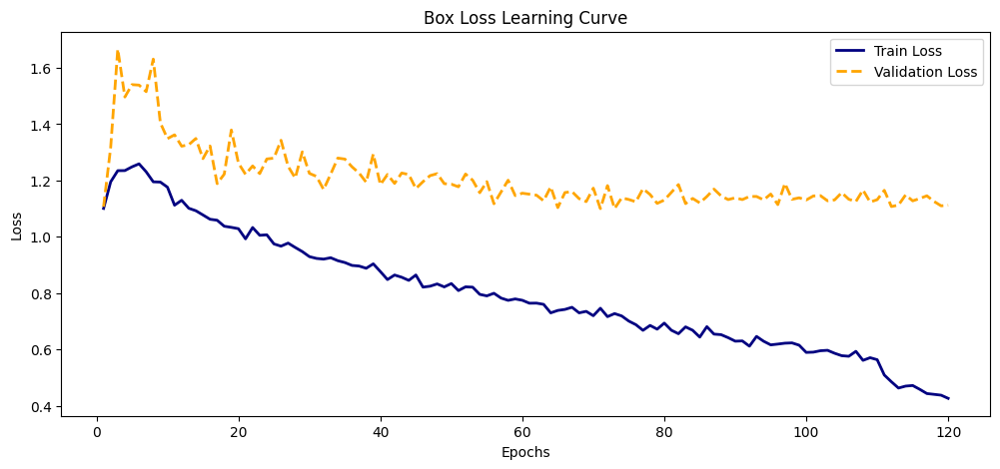

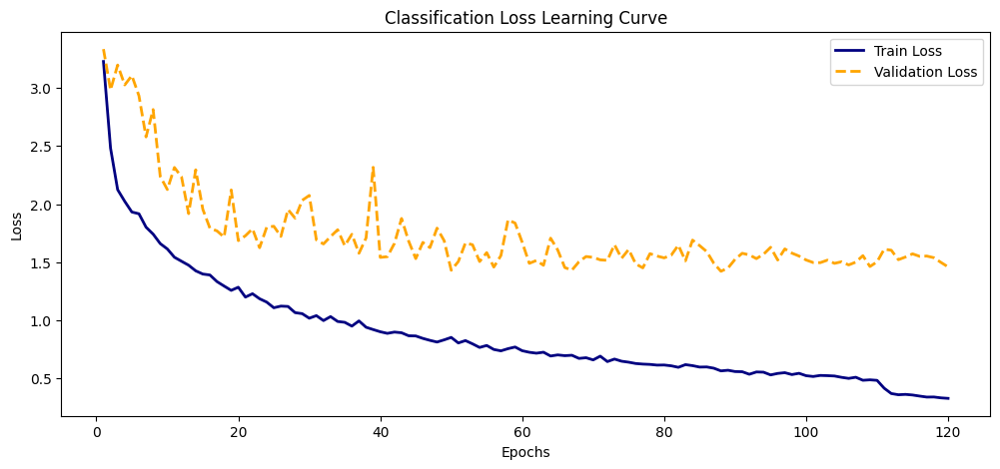

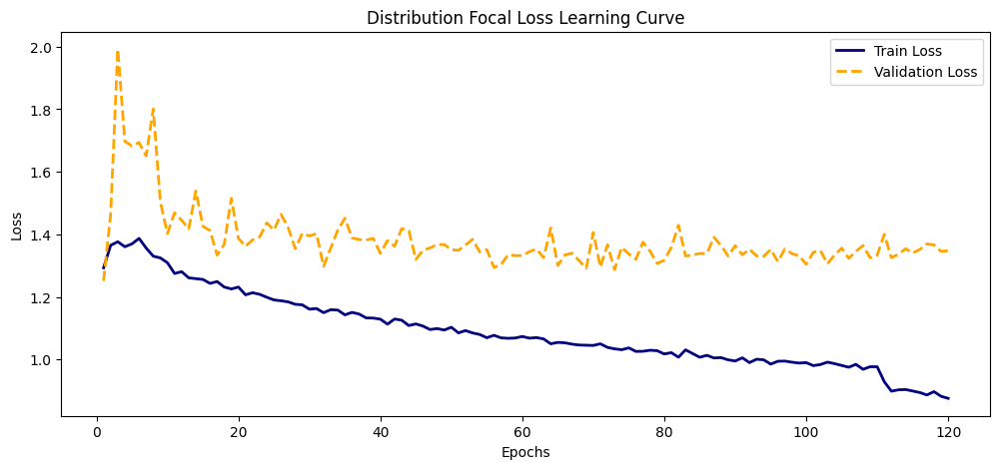

In [ ]:
import pandas as pd

# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

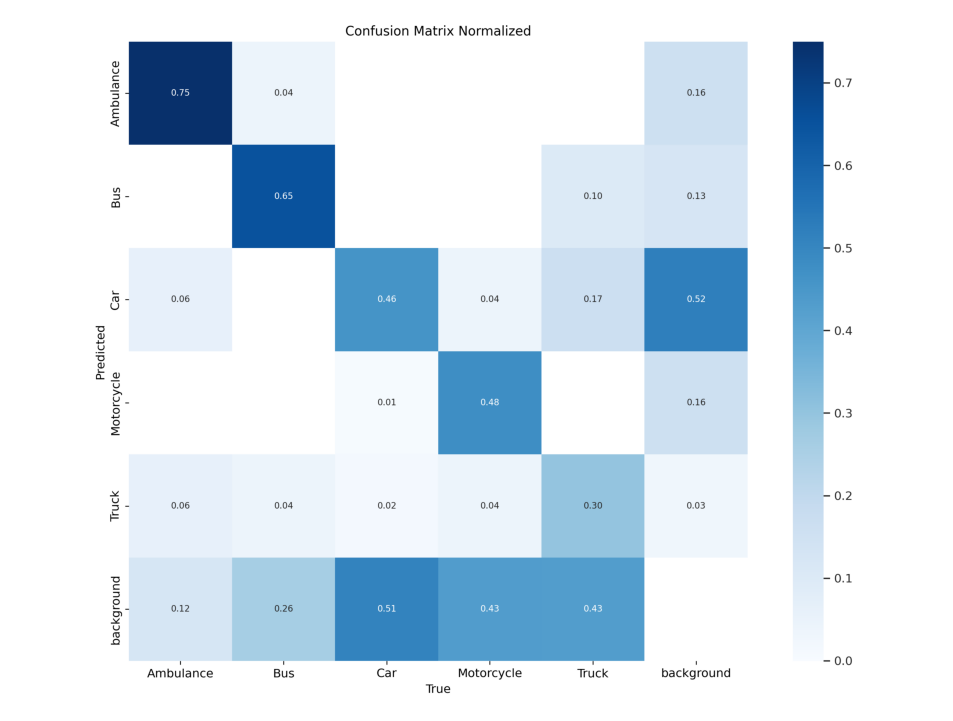

In [ ]:
# Construct the path to the normalized confusion matrix image
confusion_matrix_path = os.path.join(post_training_files_path, 'confusion_matrix_normalized.png')

# Read the image using cv2
cm_img = cv2.imread(confusion_matrix_path)

# Convert the image from BGR to RGB color space for accurate color representation with matplotlib
cm_img = cv2.cvtColor(cm_img, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(10, 10), dpi=120)
plt.imshow(cm_img)
plt.axis('off')
plt.show()

In [ ]:
# Construct the path to the best model weights file using os.path.join
best_model_path_yolo_detect = os.path.join(post_training_files_path, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model_yolo_detect = YOLO(best_model_path_yolo_detect)

# Validate the best model using the validation set with default parameters
metrics_yolo_detect = best_model_yolo_detect.val(split='val')

Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,583,127 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 595.1±233.2 MB/s, size: 31.0 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.73it/s]


                   all        250        454      0.691      0.515       0.59      0.455
             Ambulance         50         64      0.799       0.75      0.855      0.779
                   Bus         30         46      0.754      0.667      0.724      0.584
                   Car         90        238      0.708      0.412      0.486      0.333
            Motorcycle         42         46      0.671      0.478      0.543       0.33
                 Truck         38         60      0.522      0.267      0.343      0.248
Speed: 1.7ms preprocess, 4.3ms inference, 0.0ms loss, 2.5ms postprocess per image
Results saved to runs/detect/val


In [ ]:
model = YOLO("yolo11m.pt")

100%|██████████| 38.8M/38.8M [00:00<00:00, 287MB/s]


In [ ]:
# Train the model on our custom dataset
results = model.train(
    data=yaml_file_path,     # Path to the dataset configuration file
    epochs=120,              # Number of epochs to train for
    imgsz=416,               # Size of input images as integer
    device=0,                # Device to run on, i.e. cuda device=0
    patience=150,             # Epochs to wait for no observable improvement for early stopping of training
    batch=8,                # Number of images per batch
    optimizer='auto',        # Optimizer to use, choices=[SGD, Adam, Adamax, AdamW, NAdam, RAdam, RMSProp, auto]
    lr0=0.0001,              # Initial learning rate
    lrf=0.1,                 # Final learning rate (lr0 * lrf)
    dropout=0.3,             # Automatically restore best model# Use dropout regularization
    freeze=15,               # lets freeze the first 15 layers to use its original weight
    seed=0                   # Random seed for reproducibility
)

Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/vehicle_data/VehiclesDetectionDataset/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.3, dynamic=False, embed=None, epochs=120, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=15, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=416, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.0001, lrf=0.1, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=150, perspective=0.0, plots

train: Scanning /content/vehicle_data/VehiclesDetectionDataset/train/labels.cache... 878 images, 0 backgrounds, 0 corrupt: 100%|██████████| 878/878 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 282.8±37.9 MB/s, size: 33.0 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 106 weight(decay=0.0), 113 weight(decay=0.0005), 112 bias(decay=0.0)
Image sizes 416 train, 416 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 120 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/120      1.36G      1.071       1.78      1.308         28        416: 100%|██████████| 110/110 [00:17<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.00it/s]


                   all        250        454      0.603      0.562      0.598      0.395

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/120       1.7G      1.205      1.535      1.367         25        416: 100%|██████████| 110/110 [00:16<00:00,  6.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.45it/s]

                   all        250        454      0.538      0.495      0.575      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/120      1.91G      1.182       1.43      1.349         24        416: 100%|██████████| 110/110 [00:14<00:00,  7.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.43it/s]

                   all        250        454      0.728      0.553      0.614      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/120      1.91G      1.161      1.351      1.332         17        416: 100%|██████████| 110/110 [00:14<00:00,  7.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.72it/s]

                   all        250        454       0.63      0.652      0.659       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/120      1.91G      1.157      1.317      1.317         16        416: 100%|██████████| 110/110 [00:14<00:00,  7.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.55it/s]

                   all        250        454      0.571      0.638      0.639      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/120      1.91G      1.121      1.265      1.312         17        416: 100%|██████████| 110/110 [00:14<00:00,  7.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.21it/s]

                   all        250        454      0.682       0.61      0.667      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/120      1.91G      1.067      1.174      1.272         24        416: 100%|██████████| 110/110 [00:14<00:00,  7.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.57it/s]

                   all        250        454      0.673      0.635      0.702      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/120      1.91G      1.023      1.152      1.257         11        416: 100%|██████████| 110/110 [00:14<00:00,  7.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.38it/s]

                   all        250        454        0.6      0.703      0.639      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/120      1.91G      1.012      1.127      1.245         21        416: 100%|██████████| 110/110 [00:14<00:00,  7.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.53it/s]

                   all        250        454      0.662      0.591      0.651       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/120      1.91G     0.9857      1.058      1.237         20        416: 100%|██████████| 110/110 [00:14<00:00,  7.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.31it/s]

                   all        250        454      0.652        0.7      0.717      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/120      1.91G     0.9471      1.033      1.217         13        416: 100%|██████████| 110/110 [00:14<00:00,  7.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.52it/s]

                   all        250        454      0.612      0.683      0.701      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/120      1.91G     0.9459      1.022      1.206         26        416: 100%|██████████| 110/110 [00:14<00:00,  7.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.55it/s]

                   all        250        454      0.601      0.697      0.659      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/120      1.91G     0.9531       1.03      1.189         36        416: 100%|██████████| 110/110 [00:14<00:00,  7.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.44it/s]

                   all        250        454      0.688      0.663      0.676      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/120      1.91G     0.8897     0.9221      1.179         21        416: 100%|██████████| 110/110 [00:14<00:00,  7.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.45it/s]

                   all        250        454      0.661      0.667      0.687      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/120      1.91G     0.9073     0.9725      1.182         30        416: 100%|██████████| 110/110 [00:14<00:00,  7.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.51it/s]

                   all        250        454      0.707      0.661       0.69      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/120      1.91G     0.8962     0.9241      1.172         17        416: 100%|██████████| 110/110 [00:14<00:00,  7.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.20it/s]

                   all        250        454      0.723      0.694      0.712      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/120      1.91G     0.8657     0.9042      1.151         29        416: 100%|██████████| 110/110 [00:15<00:00,  7.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.63it/s]

                   all        250        454       0.66      0.652        0.7      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/120      1.91G     0.8639     0.8883      1.155         29        416: 100%|██████████| 110/110 [00:13<00:00,  7.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.56it/s]

                   all        250        454      0.725       0.59      0.685      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/120      1.91G     0.8475     0.8639       1.13         29        416: 100%|██████████| 110/110 [00:13<00:00,  7.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  5.89it/s]

                   all        250        454      0.642      0.621      0.656      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/120      1.91G     0.8057     0.8665       1.12         20        416: 100%|██████████| 110/110 [00:13<00:00,  7.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.42it/s]

                   all        250        454      0.619      0.744        0.7      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/120      1.91G     0.7973     0.7987      1.115         27        416: 100%|██████████| 110/110 [00:13<00:00,  7.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.35it/s]

                   all        250        454      0.708      0.653      0.681      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/120      1.91G     0.8269     0.8157      1.125         12        416: 100%|██████████| 110/110 [00:14<00:00,  7.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.29it/s]

                   all        250        454      0.669      0.669      0.687      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/120      1.91G     0.8143     0.8049      1.123         29        416: 100%|██████████| 110/110 [00:14<00:00,  7.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.49it/s]

                   all        250        454      0.754      0.583      0.695      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/120      1.91G     0.8006     0.8117      1.128         21        416: 100%|██████████| 110/110 [00:13<00:00,  7.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.58it/s]

                   all        250        454      0.665      0.668      0.671      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/120      1.91G      0.747     0.7685      1.087         44        416: 100%|██████████| 110/110 [00:13<00:00,  7.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.61it/s]

                   all        250        454      0.632      0.702      0.684      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/120      1.91G      0.775     0.7827      1.109         29        416: 100%|██████████| 110/110 [00:14<00:00,  7.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.54it/s]

                   all        250        454      0.649      0.699       0.69      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/120      1.91G     0.7504     0.7454      1.086         19        416: 100%|██████████| 110/110 [00:13<00:00,  7.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.64it/s]

                   all        250        454      0.672      0.729      0.732      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/120      1.91G     0.7341     0.7232      1.082         21        416: 100%|██████████| 110/110 [00:14<00:00,  7.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.15it/s]

                   all        250        454      0.744      0.632      0.683      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/120      1.91G     0.7493      0.725      1.083         26        416: 100%|██████████| 110/110 [00:14<00:00,  7.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.40it/s]

                   all        250        454      0.712      0.664      0.724      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/120      1.91G     0.7497     0.7135      1.085         22        416: 100%|██████████| 110/110 [00:14<00:00,  7.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.30it/s]

                   all        250        454      0.697      0.637      0.702      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/120      1.91G     0.7231     0.7223      1.083         20        416: 100%|██████████| 110/110 [00:14<00:00,  7.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.49it/s]

                   all        250        454      0.663      0.684      0.705      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/120      1.91G     0.7149     0.6845       1.07         25        416: 100%|██████████| 110/110 [00:15<00:00,  7.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.28it/s]

                   all        250        454      0.706      0.662      0.709      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/120      1.91G     0.7118     0.6789      1.071         25        416: 100%|██████████| 110/110 [00:14<00:00,  7.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.36it/s]

                   all        250        454      0.636      0.729      0.692       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/120      1.91G     0.7161     0.6612      1.062         11        416: 100%|██████████| 110/110 [00:14<00:00,  7.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  5.96it/s]

                   all        250        454      0.726      0.696      0.713      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/120      1.91G     0.7077     0.6718      1.073         16        416: 100%|██████████| 110/110 [00:14<00:00,  7.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.44it/s]

                   all        250        454      0.641      0.767      0.715      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/120      1.91G     0.7033     0.6632      1.057         14        416: 100%|██████████| 110/110 [00:14<00:00,  7.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.48it/s]

                   all        250        454      0.673      0.693        0.7      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/120      1.91G     0.6982     0.6578      1.058         27        416: 100%|██████████| 110/110 [00:14<00:00,  7.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  5.86it/s]

                   all        250        454      0.778      0.625      0.714      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/120      1.91G     0.6868     0.6569      1.048         25        416: 100%|██████████| 110/110 [00:14<00:00,  7.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.40it/s]

                   all        250        454      0.748      0.645      0.702      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/120      1.91G     0.6972     0.6557      1.059         25        416: 100%|██████████| 110/110 [00:14<00:00,  7.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.51it/s]

                   all        250        454      0.726      0.647       0.69      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/120      1.91G     0.6585     0.6232       1.04         18        416: 100%|██████████| 110/110 [00:14<00:00,  7.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  5.71it/s]

                   all        250        454      0.739       0.65      0.705      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/120      1.91G     0.6831     0.6418      1.055         10        416: 100%|██████████| 110/110 [00:14<00:00,  7.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.34it/s]

                   all        250        454      0.655       0.69       0.69      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/120      1.91G     0.6781     0.6492      1.054         12        416: 100%|██████████| 110/110 [00:14<00:00,  7.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.47it/s]

                   all        250        454      0.637       0.68      0.685      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/120      1.91G     0.6523     0.6106       1.04         18        416: 100%|██████████| 110/110 [00:14<00:00,  7.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  5.74it/s]

                   all        250        454      0.757      0.677       0.71      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/120      1.91G     0.6448     0.5981      1.036         34        416: 100%|██████████| 110/110 [00:14<00:00,  7.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.32it/s]

                   all        250        454      0.624      0.674      0.671      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/120      1.91G      0.656     0.6077      1.037         16        416: 100%|██████████| 110/110 [00:14<00:00,  7.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.44it/s]

                   all        250        454      0.655      0.713      0.719      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/120      1.91G      0.653     0.6035      1.024         27        416: 100%|██████████| 110/110 [00:16<00:00,  6.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.05it/s]

                   all        250        454      0.624       0.78      0.727       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/120      1.91G     0.6403     0.5896      1.031         22        416: 100%|██████████| 110/110 [00:14<00:00,  7.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.52it/s]

                   all        250        454      0.789      0.648      0.726      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/120      1.91G     0.6249     0.5752      1.027         19        416: 100%|██████████| 110/110 [00:14<00:00,  7.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.45it/s]

                   all        250        454      0.729      0.703      0.743      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/120      1.91G     0.6301     0.5934      1.033         17        416: 100%|██████████| 110/110 [00:14<00:00,  7.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.64it/s]

                   all        250        454      0.667       0.68      0.697      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/120      1.91G     0.6006     0.5586      1.013         20        416: 100%|██████████| 110/110 [00:14<00:00,  7.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.43it/s]

                   all        250        454      0.745      0.637      0.722      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/120      1.91G     0.6179     0.5813      1.029         21        416: 100%|██████████| 110/110 [00:14<00:00,  7.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.41it/s]

                   all        250        454      0.702      0.684      0.701      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/120      1.91G     0.6137     0.5647      1.011         35        416: 100%|██████████| 110/110 [00:14<00:00,  7.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.14it/s]

                   all        250        454      0.676      0.704      0.699      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/120      1.91G     0.6105     0.5553      1.008         26        416: 100%|██████████| 110/110 [00:14<00:00,  7.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.47it/s]

                   all        250        454      0.677      0.702      0.703       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/120      1.91G     0.5873     0.5387     0.9973         17        416: 100%|██████████| 110/110 [00:14<00:00,  7.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.51it/s]

                   all        250        454      0.744      0.596       0.69      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/120      1.91G     0.6084     0.5524      1.008         26        416: 100%|██████████| 110/110 [00:15<00:00,  7.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.74it/s]

                   all        250        454      0.651      0.614      0.649       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/120      1.91G     0.6009     0.5459      1.007         20        416: 100%|██████████| 110/110 [00:14<00:00,  7.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.42it/s]

                   all        250        454      0.603      0.731      0.687      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/120      1.91G     0.5634     0.5208     0.9889         29        416: 100%|██████████| 110/110 [00:14<00:00,  7.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.55it/s]

                   all        250        454      0.661      0.696      0.705       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/120      1.91G     0.6055     0.5533      1.008         16        416: 100%|██████████| 110/110 [00:14<00:00,  7.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.65it/s]

                   all        250        454      0.708      0.629      0.685      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/120      1.91G     0.5817       0.54     0.9978         21        416: 100%|██████████| 110/110 [00:14<00:00,  7.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.60it/s]

                   all        250        454      0.593      0.686      0.668      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/120      1.91G      0.582     0.5359      1.003         22        416: 100%|██████████| 110/110 [00:14<00:00,  7.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.46it/s]

                   all        250        454      0.705      0.679      0.721      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/120      1.91G     0.5866     0.5245      1.006         31        416: 100%|██████████| 110/110 [00:16<00:00,  6.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.49it/s]

                   all        250        454      0.649      0.682      0.695      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/120      1.91G     0.5859       0.52      1.004         34        416: 100%|██████████| 110/110 [00:14<00:00,  7.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.57it/s]

                   all        250        454      0.615      0.699      0.693       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/120      1.91G     0.5704     0.5148     0.9988         23        416: 100%|██████████| 110/110 [00:14<00:00,  7.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.10it/s]

                   all        250        454      0.659      0.657      0.696      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/120      1.91G     0.5671     0.5087     0.9904         36        416: 100%|██████████| 110/110 [00:15<00:00,  7.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.37it/s]

                   all        250        454       0.63      0.755      0.723      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/120      1.91G     0.5496     0.5006     0.9873         22        416: 100%|██████████| 110/110 [00:14<00:00,  7.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.51it/s]

                   all        250        454      0.735      0.593      0.707      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/120      1.91G     0.5614     0.5034     0.9919         29        416: 100%|██████████| 110/110 [00:14<00:00,  7.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.16it/s]

                   all        250        454      0.668      0.673      0.717      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/120      1.91G     0.5634     0.5131     0.9935         24        416: 100%|██████████| 110/110 [00:14<00:00,  7.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.37it/s]

                   all        250        454      0.636      0.653      0.669      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/120      1.91G      0.554     0.4949     0.9853         33        416: 100%|██████████| 110/110 [00:14<00:00,  7.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.45it/s]

                   all        250        454      0.688      0.657      0.692       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/120      1.91G     0.5695     0.4901       0.99         17        416: 100%|██████████| 110/110 [00:14<00:00,  7.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.24it/s]

                   all        250        454      0.649      0.728      0.715      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/120      1.91G     0.5596     0.4882     0.9886         18        416: 100%|██████████| 110/110 [00:14<00:00,  7.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.39it/s]

                   all        250        454      0.649      0.752      0.716      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/120      1.91G     0.5483       0.49     0.9793         17        416: 100%|██████████| 110/110 [00:14<00:00,  7.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.41it/s]

                   all        250        454      0.653      0.732      0.716      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/120      1.91G     0.5485     0.4879     0.9883         19        416: 100%|██████████| 110/110 [00:14<00:00,  7.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.36it/s]

                   all        250        454      0.663      0.702      0.701      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/120      1.91G     0.5548     0.4916     0.9814         13        416: 100%|██████████| 110/110 [00:14<00:00,  7.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.87it/s]

                   all        250        454      0.724      0.664      0.701      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/120      1.91G     0.5317     0.4852     0.9792         21        416: 100%|██████████| 110/110 [00:14<00:00,  7.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.42it/s]

                   all        250        454      0.678      0.716      0.728      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/120      1.91G     0.5237     0.4684     0.9749         22        416: 100%|██████████| 110/110 [00:15<00:00,  7.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.19it/s]

                   all        250        454      0.684       0.67      0.691      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/120      1.91G     0.5184     0.4736       0.98         26        416: 100%|██████████| 110/110 [00:14<00:00,  7.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.37it/s]

                   all        250        454      0.619       0.68      0.689      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/120      1.91G     0.5297     0.4808     0.9763         27        416: 100%|██████████| 110/110 [00:14<00:00,  7.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.63it/s]

                   all        250        454      0.697      0.666      0.712      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/120      1.91G     0.5364     0.4896     0.9792         21        416: 100%|██████████| 110/110 [00:13<00:00,  7.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.59it/s]

                   all        250        454      0.725      0.657      0.696      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/120      1.91G     0.5078     0.4545     0.9664         21        416: 100%|██████████| 110/110 [00:14<00:00,  7.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.97it/s]

                   all        250        454      0.725      0.647      0.713      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/120      1.91G     0.5212     0.4706     0.9756         22        416: 100%|██████████| 110/110 [00:13<00:00,  7.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.59it/s]

                   all        250        454      0.619      0.751      0.704      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/120      1.91G     0.5142      0.461     0.9657         31        416: 100%|██████████| 110/110 [00:13<00:00,  7.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.46it/s]

                   all        250        454      0.732      0.693      0.722      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/120      1.91G     0.5246     0.4573     0.9718         23        416: 100%|██████████| 110/110 [00:13<00:00,  7.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  5.61it/s]

                   all        250        454       0.68      0.727      0.691      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/120      1.91G     0.5131      0.452     0.9625         24        416: 100%|██████████| 110/110 [00:14<00:00,  7.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.57it/s]

                   all        250        454      0.708      0.666      0.732      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/120      1.91G     0.5134     0.4558     0.9651         18        416: 100%|██████████| 110/110 [00:13<00:00,  7.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.58it/s]

                   all        250        454       0.73      0.626      0.712      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/120      1.91G     0.5083     0.4479     0.9682         10        416: 100%|██████████| 110/110 [00:14<00:00,  7.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.52it/s]

                   all        250        454      0.678      0.714      0.725       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/120      1.91G     0.5039     0.4454     0.9666         26        416: 100%|██████████| 110/110 [00:13<00:00,  7.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.56it/s]

                   all        250        454      0.675      0.758      0.726      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/120      1.91G     0.5033     0.4457      0.971         29        416: 100%|██████████| 110/110 [00:14<00:00,  7.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.64it/s]

                   all        250        454      0.691      0.684      0.714      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/120      1.91G     0.4949     0.4306     0.9581         24        416: 100%|██████████| 110/110 [00:13<00:00,  7.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.37it/s]

                   all        250        454      0.696      0.664      0.696      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/120      1.91G     0.4889     0.4409      0.961         16        416: 100%|██████████| 110/110 [00:14<00:00,  7.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.61it/s]

                   all        250        454      0.681      0.673      0.703      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/120      1.91G     0.4846     0.4228     0.9557         20        416: 100%|██████████| 110/110 [00:15<00:00,  7.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.59it/s]

                   all        250        454      0.691      0.683      0.712      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/120      1.91G     0.4854     0.4235     0.9606         17        416: 100%|██████████| 110/110 [00:13<00:00,  7.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.44it/s]

                   all        250        454      0.714      0.669      0.712      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/120      1.91G     0.4716     0.4155     0.9489         31        416: 100%|██████████| 110/110 [00:13<00:00,  7.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  5.56it/s]

                   all        250        454       0.75      0.653      0.718      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/120      1.91G     0.4896     0.4226     0.9538         21        416: 100%|██████████| 110/110 [00:14<00:00,  7.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.57it/s]

                   all        250        454      0.638      0.721      0.704      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/120      1.91G     0.4778     0.4253     0.9562         32        416: 100%|██████████| 110/110 [00:14<00:00,  7.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.36it/s]

                   all        250        454      0.652      0.709      0.701      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/120      1.91G     0.4877     0.4245     0.9569         22        416: 100%|██████████| 110/110 [00:14<00:00,  7.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.03it/s]

                   all        250        454      0.721       0.66      0.715      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/120      1.91G     0.4653     0.4075     0.9529         28        416: 100%|██████████| 110/110 [00:13<00:00,  7.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.52it/s]

                   all        250        454      0.743      0.638      0.696      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/120      1.91G     0.4633     0.4024     0.9484         27        416: 100%|██████████| 110/110 [00:14<00:00,  7.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.55it/s]

                   all        250        454      0.727       0.67      0.702      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/120      1.91G     0.4745     0.4127     0.9533         22        416: 100%|██████████| 110/110 [00:14<00:00,  7.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.02it/s]

                   all        250        454      0.617      0.739      0.697       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/120      1.91G     0.4583     0.4053     0.9426         14        416: 100%|██████████| 110/110 [00:14<00:00,  7.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.47it/s]

                   all        250        454       0.65      0.739      0.705      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/120      1.91G     0.4709     0.3914     0.9504         24        416: 100%|██████████| 110/110 [00:13<00:00,  7.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.63it/s]

                   all        250        454      0.619      0.764       0.73      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/120      1.91G     0.4492     0.3966     0.9504         19        416: 100%|██████████| 110/110 [00:14<00:00,  7.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.00it/s]

                   all        250        454      0.657      0.703      0.716      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/120      1.91G     0.4761     0.4079     0.9551         19        416: 100%|██████████| 110/110 [00:14<00:00,  7.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.33it/s]

                   all        250        454      0.652       0.74      0.722      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/120      1.91G     0.4595     0.3963     0.9448         19        416: 100%|██████████| 110/110 [00:14<00:00,  7.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.46it/s]

                   all        250        454      0.658      0.723      0.713      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/120      1.91G     0.4753     0.4048      0.951         27        416: 100%|██████████| 110/110 [00:14<00:00,  7.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  5.96it/s]

                   all        250        454      0.706      0.645      0.714      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/120      1.91G     0.4641     0.3948     0.9485         24        416: 100%|██████████| 110/110 [00:14<00:00,  7.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.47it/s]

                   all        250        454       0.69      0.673      0.693       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/120      1.91G     0.4417     0.3803     0.9382         12        416: 100%|██████████| 110/110 [00:14<00:00,  7.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.51it/s]

                   all        250        454      0.634       0.74      0.696      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/120      1.91G     0.4417     0.3805     0.9392         12        416: 100%|██████████| 110/110 [00:14<00:00,  7.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.65it/s]

                   all        250        454      0.654      0.753      0.728      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/120      1.91G     0.4487     0.3889     0.9391         27        416: 100%|██████████| 110/110 [00:14<00:00,  7.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.40it/s]

                   all        250        454      0.753      0.664      0.724      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/120      1.91G     0.4448     0.3909     0.9408         23        416: 100%|██████████| 110/110 [00:14<00:00,  7.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.43it/s]

                   all        250        454      0.657      0.728      0.722      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/120      1.91G     0.4487     0.3908     0.9419         20        416: 100%|██████████| 110/110 [00:14<00:00,  7.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.39it/s]

                   all        250        454      0.734       0.65       0.71      0.537


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/120      1.91G     0.3539      0.273     0.8762         14        416: 100%|██████████| 110/110 [00:14<00:00,  7.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.39it/s]

                   all        250        454      0.741      0.657      0.693      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/120      1.91G     0.3558     0.2618     0.8669         12        416: 100%|██████████| 110/110 [00:13<00:00,  8.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.44it/s]

                   all        250        454      0.746      0.649      0.691      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/120      1.91G     0.3336     0.2525     0.8582          9        416: 100%|██████████| 110/110 [00:13<00:00,  8.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.61it/s]

                   all        250        454      0.753      0.665      0.695       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/120      1.91G     0.3429     0.2546     0.8656         12        416: 100%|██████████| 110/110 [00:13<00:00,  8.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.57it/s]

                   all        250        454      0.659      0.705      0.687      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/120      1.91G     0.3293     0.2489     0.8618         16        416: 100%|██████████| 110/110 [00:14<00:00,  7.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.10it/s]

                   all        250        454      0.635      0.706      0.693      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/120      1.91G     0.3289     0.2454     0.8699         14        416: 100%|██████████| 110/110 [00:13<00:00,  8.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.32it/s]

                   all        250        454      0.674      0.695      0.694       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/120      1.91G     0.3267     0.2455     0.8661         10        416: 100%|██████████| 110/110 [00:14<00:00,  7.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.44it/s]

                   all        250        454      0.673      0.705      0.703      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/120      1.91G     0.3324     0.2451      0.863         14        416: 100%|██████████| 110/110 [00:14<00:00,  7.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  5.81it/s]

                   all        250        454      0.673      0.712      0.708      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/120      1.91G     0.3184     0.2436     0.8662         13        416: 100%|██████████| 110/110 [00:14<00:00,  7.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  5.99it/s]

                   all        250        454      0.638      0.714      0.706      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/120      1.91G     0.3142     0.2316     0.8554          8        416: 100%|██████████| 110/110 [00:13<00:00,  8.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.35it/s]

                   all        250        454       0.64      0.701      0.702      0.545



120 epochs completed in 0.575 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 40.5MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 40.5MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11m summary (fused): 125 layers, 20,033,887 parameters, 0 gradients, 67.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:03<00:00,  4.14it/s]


                   all        250        454      0.652      0.753      0.728      0.558
             Ambulance         50         64      0.748      0.875       0.92      0.808
                   Bus         30         46      0.621       0.87      0.802      0.675
                   Car         90        238      0.566      0.605      0.586      0.408
            Motorcycle         42         46      0.775      0.913      0.802      0.502
                 Truck         38         60      0.551        0.5      0.532      0.398
Speed: 0.3ms preprocess, 5.7ms inference, 0.0ms loss, 2.9ms postprocess per image
Results saved to runs/detect/train2


In [ ]:
# Define the path to the directory
post_training_files_path = '/content/runs/detect/train2'

# List the files in the directory
!ls {post_training_files_path}

args.yaml			 R_curve.png	       train_batch2.jpg
confusion_matrix_normalized.png  results.csv	       val_batch0_labels.jpg
confusion_matrix.png		 results.png	       val_batch0_pred.jpg
F1_curve.png			 train_batch0.jpg      val_batch1_labels.jpg
labels_correlogram.jpg		 train_batch12100.jpg  val_batch1_pred.jpg
labels.jpg			 train_batch12101.jpg  val_batch2_labels.jpg
P_curve.png			 train_batch12102.jpg  val_batch2_pred.jpg
PR_curve.png			 train_batch1.jpg      weights


In [ ]:
# Define a function to plot learning curves for loss values
def plot_learning_curve(df, train_loss_col, val_loss_col, title):
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=df, x='epoch', y=train_loss_col, label='Train Loss', color='navy', linestyle='-', linewidth=2)
    sns.lineplot(data=df, x='epoch', y=val_loss_col, label='Validation Loss', color='green', linestyle='--', linewidth=2)
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

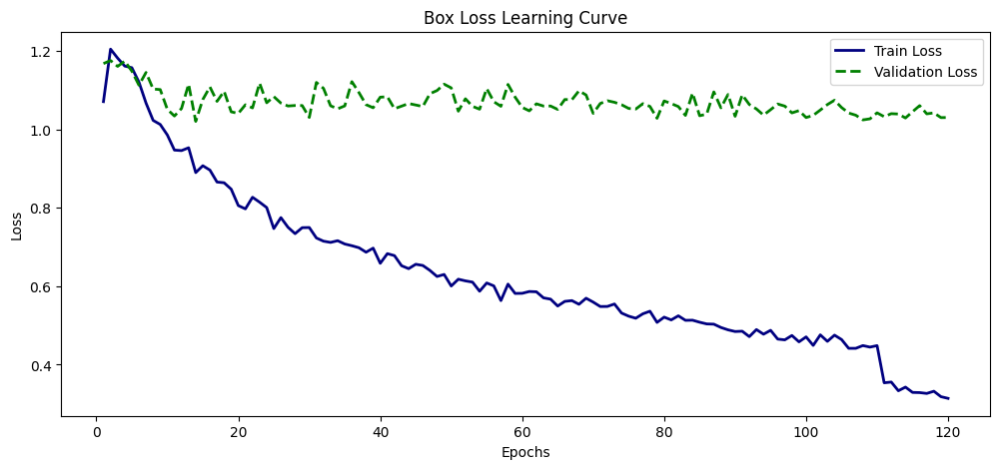

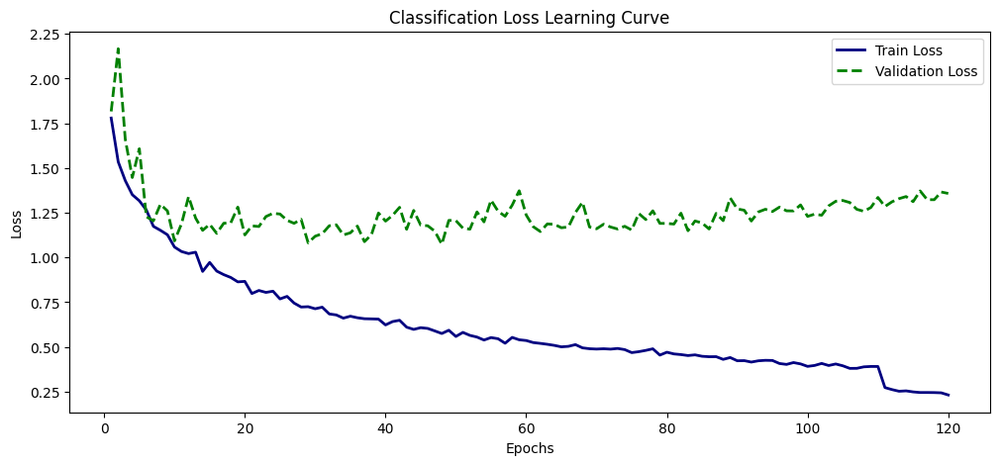

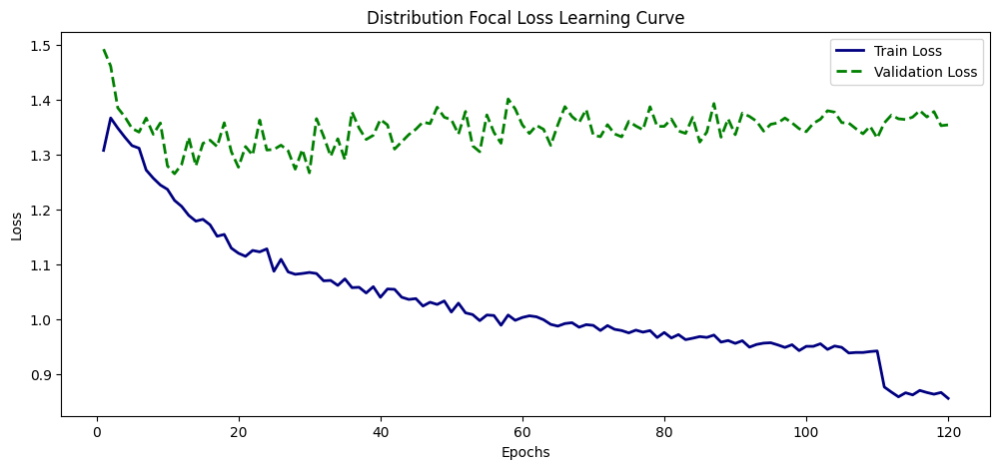

In [ ]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

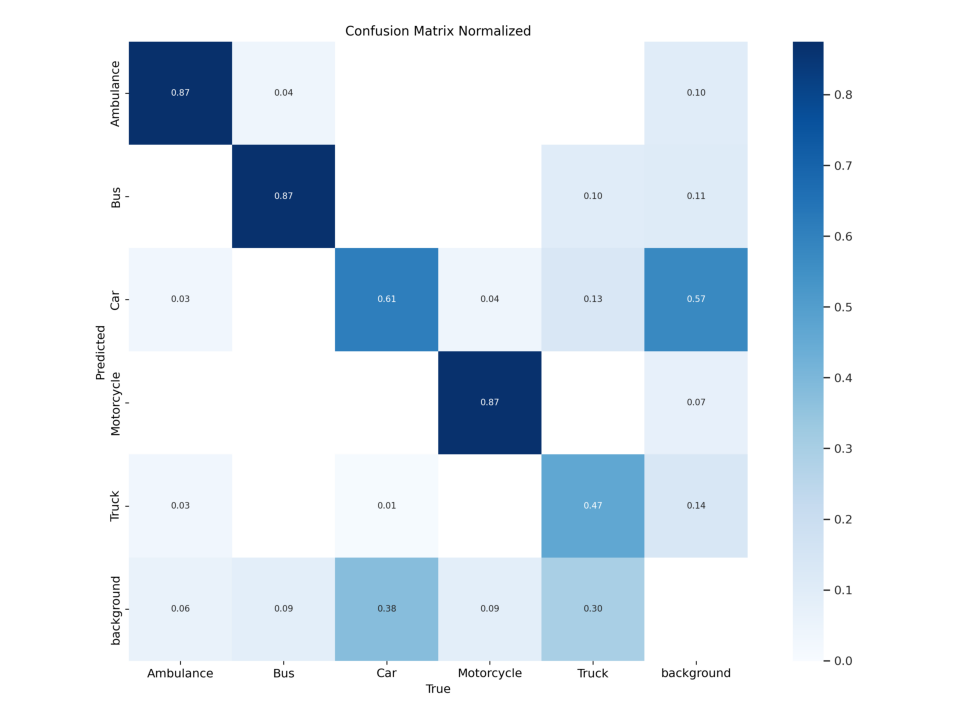

In [ ]:
# Construct the path to the normalized confusion matrix image
confusion_matrix_path = os.path.join(post_training_files_path, 'confusion_matrix_normalized.png')

# Read the image using cv2
cm_img = cv2.imread(confusion_matrix_path)

# Convert the image from BGR to RGB color space for accurate color representation with matplotlib
cm_img = cv2.cvtColor(cm_img, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(10, 10), dpi=120)
plt.imshow(cm_img)
plt.axis('off')
plt.show()

In [ ]:
# Construct the path to the best model weights file using os.path.join
best_model_path_yolo_detect = os.path.join(post_training_files_path, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model_yolo_detect = YOLO(best_model_path_yolo_detect)

# Validate the best model using the validation set with default parameters
metrics_yolo_detect = best_model_yolo_detect.val(split='val')

Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11m summary (fused): 125 layers, 20,033,887 parameters, 0 gradients, 67.7 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 595.3±314.7 MB/s, size: 31.0 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:05<00:00,  3.01it/s]


                   all        250        454      0.653      0.753      0.728      0.559
             Ambulance         50         64      0.747      0.875       0.92       0.81
                   Bus         30         46      0.622       0.87      0.802      0.675
                   Car         90        238      0.571      0.605      0.583      0.407
            Motorcycle         42         46      0.773      0.913      0.802      0.503
                 Truck         38         60       0.55        0.5      0.531      0.398
Speed: 1.0ms preprocess, 12.5ms inference, 0.0ms loss, 2.3ms postprocess per image
Results saved to runs/detect/val2



image 1/1 /content/vehicle_data/VehiclesDetectionDataset/test/images/a3cffcdbff959432_jpg.rf.4MQ1NmvMx33nwLe9QSvu.jpg: 416x416 1 Car, 1 Truck, 21.6ms
Speed: 1.4ms preprocess, 21.6ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /content/vehicle_data/VehiclesDetectionDataset/test/images/a3cffcdbff959432_jpg.rf.1f1f8cfcdfe052a8ec72e63b11889b66.jpg: 416x416 1 Car, 1 Truck, 21.7ms
Speed: 1.2ms preprocess, 21.7ms inference, 2.2ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /content/vehicle_data/VehiclesDetectionDataset/test/images/a7674f15d9b1f35f_jpg.rf.pL09u0Oz8DRvTB3AnBXT.jpg: 416x416 1 Ambulance, 22.2ms
Speed: 1.5ms preprocess, 22.2ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /content/vehicle_data/VehiclesDetectionDataset/test/images/aed83d879a22a6c4_jpg.rf.ada6c87c88d32689f79e3a03c9ebd314.jpg: 416x416 1 Ambulance, 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 1.7ms postprocess per image at shape (1, 3, 

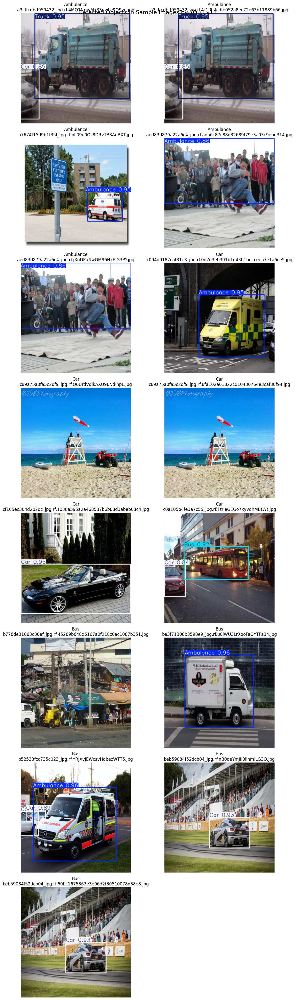

In [ ]:
# Load the trained YOLO v11 segmentation model
best_model = YOLO("/content/runs/detect/train2/weights/best.pt")  # Update with your model path

# Path to the test image folder
test_images_path = Path("/content/vehicle_data/VehiclesDetectionDataset/test/images")

# Define class mapping based on the first letter in filenames
class_mapping = {
    "A": "Ambulance",
    "C": "Car",
    "M": "Motorcycle",
    "B": "Bus",
    "T": "Truck"
}

# Collect images by class
image_classes = {cls: [] for cls in class_mapping.keys()}

# Ensure the directory exists
if not test_images_path.exists():
    raise FileNotFoundError(f"Error: The path {test_images_path} does not exist!")

# Iterate through images and categorize them
for img_name in os.listdir(test_images_path):
    if img_name.endswith(('.jpg', '.png', '.jpeg')):
        class_letter = img_name[0].upper()  # Convert to uppercase
        if class_letter in image_classes:
            image_classes[class_letter].append(img_name)

# Select 5 images per class
selected_images = []
for class_letter, img_list in image_classes.items():
    selected_images.extend([(class_letter, img) for img in img_list[:5]])

# ✅ Prevent crash if no images were found
if not selected_images:
    raise ValueError("No images were found matching the class mapping criteria. Check your filenames.")

# Set up figure with 2 vertical columns
num_images = len(selected_images)
num_rows = max(1, (num_images + 1) // 2)  # Ensure at least 1 row

fig, axes = plt.subplots(num_rows, 2, figsize=(12, 5 * num_rows))

# Flatten axes if more than one image
axes = axes.flatten() if num_images > 1 else [axes]

# Loop through selected images and display them
for idx, (class_letter, img_name) in enumerate(selected_images):
    img_path = test_images_path / img_name

    # Perform inference
    results = best_model.predict(source=str(img_path), imgsz=416, conf=0.7)
    annotated_img = results[0].plot(line_width=2)

    # Convert BGR to RGB
    annotated_img = cv2.cvtColor(annotated_img, cv2.COLOR_BGR2RGB)

    # Display image
    axes[idx].imshow(annotated_img)
    axes[idx].set_title(f"{class_mapping[class_letter]}\n{img_name}", fontsize=12)
    axes[idx].axis("off")

# Remove extra subplots if images are not exactly even
for i in range(idx + 1, len(axes)):
    fig.delaxes(axes[i])

plt.suptitle("Detected Objects in Sample Images by YOLO v11", fontsize=16)
plt.tight_layout()
plt.show()

In [ ]:
import cv2
import os
import supervision as sv
from ultralytics import YOLO
from IPython.display import Video

# Load YOLO model
model = YOLO("/content/runs/detect/train2/weights/best.pt")

# Annotators
bounding_box_annotator = sv.BoundingBoxAnnotator()
label_annotator = sv.LabelAnnotator()

# Video paths
video_path = "/content/vehicle_data/TestVideo/TrafficPolice.mp4"
output_path = "/content/output_TrafficPolice.mp4"
compressed_output_path = "/content/compressed_output_TrafficPolice.mp4"

# Open video
cap = cv2.VideoCapture(video_path)
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))
fps = int(cap.get(cv2.CAP_PROP_FPS))

# Jump to frame 0 (start of video)
cap.set(cv2.CAP_PROP_POS_FRAMES, 0)

# Calculate the number of frames for 30 seconds
max_frames = int(fps * 30)  # Stop after 30 seconds

# Video writer
out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))

frame_count = 0

# Process only 30 seconds of video
while cap.isOpened() and frame_count < max_frames:
    ret, frame = cap.read()
    if not ret:
        break  # Exit if video ends

    results = model(frame, conf=0.5, verbose=False)[0]
    detections = sv.Detections.from_ultralytics(results)

    # Annotate frame
    annotated_frame = bounding_box_annotator.annotate(scene=frame, detections=detections)
    annotated_frame = label_annotator.annotate(scene=annotated_frame, detections=detections)

    out.write(annotated_frame)
    frame_count += 1  # Keep track of processed frames

cap.release()
out.release()

# 🔹 Compress only the 10-second clip using FFmpeg
os.system(f"ffmpeg -y -t 30 -i {output_path} -vcodec libx264 -crf 30 {compressed_output_path}")

# 🔹 Display the compressed video preview
Video(compressed_output_path, embed=True)

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


In [ ]:
from google.colab import files
files.download('/content/runs/detect/train2/weights/best.pt')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from ultralytics import YOLO

model = YOLO("/content/yolo11m.pt")  # أو استخدم مسار المودل الخاص بك

model.train(
    data="/content/vehicle_data/VehiclesDetectionDataset/dataset.yaml",    # ملف بياناتك YAML
    epochs=80,
    imgsz=416,
    batch=16,
    device=0,
    patience=20,
    optimizer="AdamW",
    lr0=0.0003,
    lrf=0.01,
    dropout=0.4,
    weight_decay=0.0005,
    freeze=10,
    seed=42,
    hsv_h=0.015,
    hsv_s=0.7,
    hsv_v=0.4,
    degrees=5.0,
    translate=0.1,
    scale=0.5,
    shear=0.0,
    perspective=0.0,
    flipud=0.0,
    fliplr=0.5,
    mosaic=1.0,
    mixup=0.2,
    copy_paste=0.1,
    iou=0.2,
    box=0.1,

)

Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=0.1, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.1, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/vehicle_data/VehiclesDetectionDataset/dataset.yaml, degrees=5.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.4, dynamic=False, embed=None, epochs=80, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=10, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=416, int8=False, iou=0.2, keras=False, kobj=1.0, line_width=None, lr0=0.0003, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.2, mode=train, model=/content/yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train4, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, patience=20, perspective=

train: Scanning /content/vehicle_data/VehiclesDetectionDataset/train/labels.cache... 878 images, 0 backgrounds, 0 corrupt: 100%|██████████| 878/878 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 268.3±114.3 MB/s, size: 32.1 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]


Plotting labels to runs/detect/train4/labels.jpg... 
optimizer: AdamW(lr=0.0003, momentum=0.937) with parameter groups 106 weight(decay=0.0), 113 weight(decay=0.0005), 112 bias(decay=0.0)
Image sizes 416 train, 416 val
Using 2 dataloader workers
Logging results to runs/detect/train4
Starting training for 80 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/80      1.95G    0.01661      2.024      1.433         53        416: 100%|██████████| 55/55 [00:13<00:00,  4.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]

                   all        250        454      0.383      0.549      0.444      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/80      2.67G    0.01665      1.514      1.454         59        416: 100%|██████████| 55/55 [00:13<00:00,  4.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.79it/s]

                   all        250        454      0.667       0.61       0.67      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/80      2.67G     0.0163      1.442      1.444         56        416: 100%|██████████| 55/55 [00:12<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.83it/s]

                   all        250        454      0.464      0.682      0.609      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/80      2.69G    0.01614       1.36      1.446         74        416: 100%|██████████| 55/55 [00:11<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.84it/s]

                   all        250        454      0.718      0.628      0.653      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/80      2.74G    0.01573      1.282      1.405         61        416: 100%|██████████| 55/55 [00:11<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.73it/s]

                   all        250        454      0.709      0.641      0.686      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/80      2.74G    0.01569      1.269      1.398         80        416: 100%|██████████| 55/55 [00:12<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.55it/s]

                   all        250        454      0.704      0.692      0.686      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/80      2.74G    0.01528      1.245      1.411         61        416: 100%|██████████| 55/55 [00:11<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.11it/s]

                   all        250        454      0.746      0.693       0.72      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/80      2.74G    0.01485      1.175      1.365         65        416: 100%|██████████| 55/55 [00:11<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.83it/s]

                   all        250        454      0.743      0.643      0.695       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/80      2.74G    0.01433      1.122      1.325         68        416: 100%|██████████| 55/55 [00:11<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.87it/s]

                   all        250        454      0.772      0.612       0.69      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/80      2.74G    0.01435      1.095      1.349         56        416: 100%|██████████| 55/55 [00:11<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.86it/s]

                   all        250        454      0.721      0.666      0.699       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/80      2.75G    0.01407      1.086      1.337         68        416: 100%|██████████| 55/55 [00:11<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]

                   all        250        454      0.767      0.701      0.741      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/80      2.79G    0.01394      1.043      1.334         58        416: 100%|██████████| 55/55 [00:11<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.88it/s]

                   all        250        454      0.663      0.661      0.665      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/80      2.79G    0.01413      1.032      1.334         76        416: 100%|██████████| 55/55 [00:11<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.57it/s]

                   all        250        454      0.698      0.616      0.646      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/80      2.85G    0.01392      1.014      1.328         67        416: 100%|██████████| 55/55 [00:11<00:00,  4.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.00it/s]

                   all        250        454      0.685      0.578      0.642      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/80      2.85G    0.01347     0.9639      1.294         73        416: 100%|██████████| 55/55 [00:11<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.60it/s]

                   all        250        454      0.736      0.652      0.678      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/80      2.85G    0.01308     0.9476      1.295         54        416: 100%|██████████| 55/55 [00:12<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.81it/s]

                   all        250        454      0.627      0.666      0.676      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/80      2.85G    0.01327     0.9609      1.303         69        416: 100%|██████████| 55/55 [00:13<00:00,  4.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.77it/s]

                   all        250        454      0.646      0.668      0.663      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/80      2.85G    0.01314     0.9665        1.3         74        416: 100%|██████████| 55/55 [00:12<00:00,  4.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]

                   all        250        454      0.716      0.625      0.646      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/80      2.85G    0.01309     0.9197      1.258         80        416: 100%|██████████| 55/55 [00:12<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]

                   all        250        454       0.66      0.669      0.667      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/80      2.85G    0.01313     0.9257      1.284         49        416: 100%|██████████| 55/55 [00:12<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.37it/s]

                   all        250        454      0.717      0.605       0.68      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/80      2.85G    0.01256     0.8928      1.265         65        416: 100%|██████████| 55/55 [00:11<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.06it/s]

                   all        250        454      0.648      0.645      0.658      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/80      2.85G    0.01282     0.8768      1.268         59        416: 100%|██████████| 55/55 [00:11<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.85it/s]

                   all        250        454      0.623      0.639      0.628      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/80      2.85G    0.01228      0.857      1.233         82        416: 100%|██████████| 55/55 [00:11<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.80it/s]

                   all        250        454      0.578      0.675      0.648      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/80      2.85G    0.01243     0.8378      1.244         56        416: 100%|██████████| 55/55 [00:11<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]

                   all        250        454      0.628      0.614      0.632      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/80      2.85G    0.01216      0.828      1.237         63        416: 100%|██████████| 55/55 [00:11<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.80it/s]

                   all        250        454       0.68       0.63      0.662      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/80      2.85G    0.01248     0.8509      1.256         65        416: 100%|██████████| 55/55 [00:11<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.80it/s]

                   all        250        454       0.71      0.633      0.672      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/80      2.85G    0.01219     0.8043      1.226         79        416: 100%|██████████| 55/55 [00:11<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.28it/s]

                   all        250        454      0.656      0.642      0.665      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/80      2.85G    0.01177     0.8085      1.218         60        416: 100%|██████████| 55/55 [00:11<00:00,  4.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.36it/s]

                   all        250        454      0.677      0.592      0.647      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/80      2.85G    0.01208     0.8116      1.235         53        416: 100%|██████████| 55/55 [00:11<00:00,  4.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.82it/s]

                   all        250        454      0.611       0.72      0.684      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/80      2.85G    0.01182     0.7938      1.223         42        416: 100%|██████████| 55/55 [00:11<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.82it/s]

                   all        250        454      0.624      0.688      0.659        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/80      2.85G    0.01163     0.7813       1.22         52        416: 100%|██████████| 55/55 [00:11<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.79it/s]

                   all        250        454      0.742      0.649      0.703      0.523
EarlyStopping: Training stopped early as no improvement observed in last 20 epochs. Best results observed at epoch 11, best model saved as best.pt.
To update EarlyStopping(patience=20) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



31 epochs completed in 0.128 hours.
Optimizer stripped from runs/detect/train4/weights/last.pt, 40.5MB
Optimizer stripped from runs/detect/train4/weights/best.pt, 40.5MB

Validating runs/detect/train4/weights/best.pt...
Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11m summary (fused): 125 layers, 20,033,887 parameters, 0 gradients, 67.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]


                   all        250        454      0.767      0.704      0.741      0.542
             Ambulance         50         64      0.862      0.782      0.918      0.781
                   Bus         30         46      0.683      0.783      0.806      0.662
                   Car         90        238      0.729      0.597       0.63      0.447
            Motorcycle         42         46      0.729      0.826      0.697      0.367
                 Truck         38         60      0.831      0.533      0.654      0.454
Speed: 0.1ms preprocess, 5.0ms inference, 0.0ms loss, 2.6ms postprocess per image
Results saved to runs/detect/train4


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7dfb2c39c790>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
# Define the path to the directory
post_training_files_path = '/content/runs/detect/train3'

# List the files in the directory
!ls {post_training_files_path}

args.yaml			 PR_curve.png	   val_batch0_labels.jpg
confusion_matrix_normalized.png  R_curve.png	   val_batch0_pred.jpg
confusion_matrix.png		 results.csv	   val_batch1_labels.jpg
F1_curve.png			 results.png	   val_batch1_pred.jpg
labels_correlogram.jpg		 train_batch0.jpg  val_batch2_labels.jpg
labels.jpg			 train_batch1.jpg  val_batch2_pred.jpg
P_curve.png			 train_batch2.jpg  weights


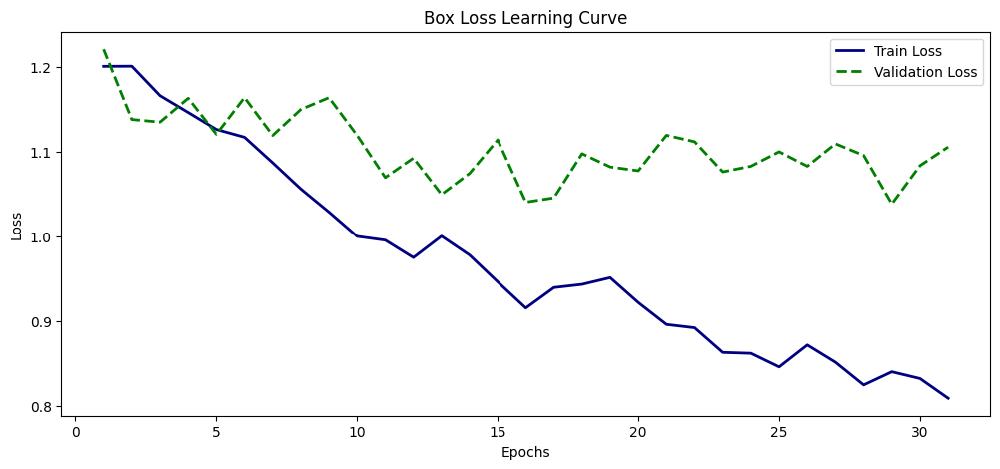

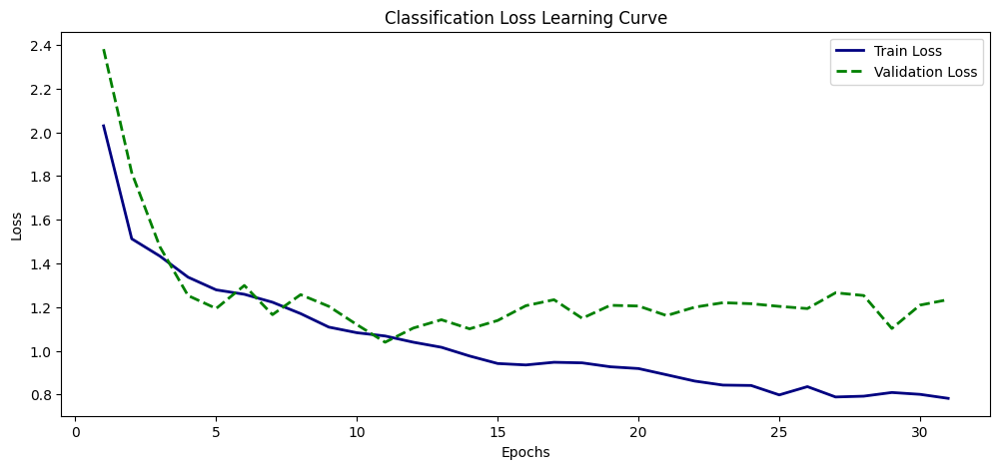

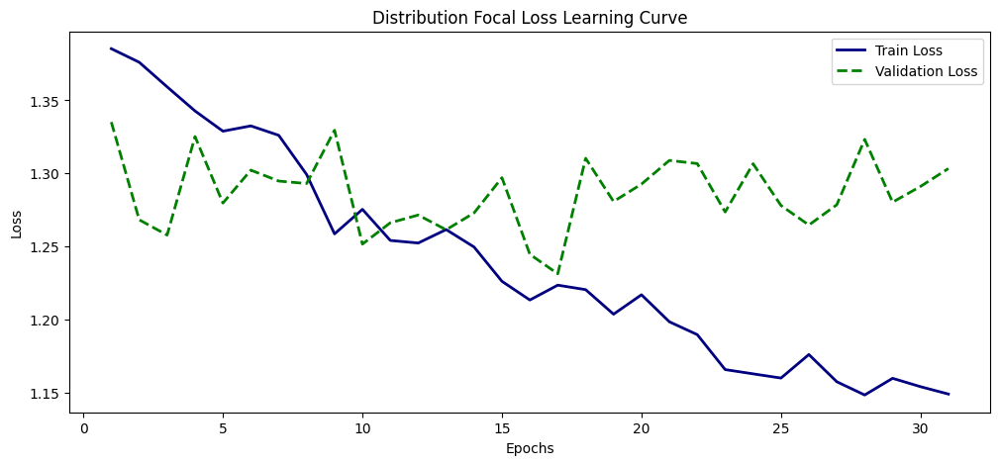

In [ ]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# قراءة الملف
results = pd.read_csv("/content/runs/detect/train/results.csv")

# تنظيف أسماء الأعمدة
results.columns = results.columns.str.strip()

# عرض الأعمدة لتتأكد من الأسماء الصحيحة
print(results.columns.tolist())


['epoch', 'time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss', 'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)', 'metrics/mAP50-95(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss', 'lr/pg0', 'lr/pg1', 'lr/pg2']


In [ ]:
print(results.columns.tolist())


['epoch', 'time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss', 'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)', 'metrics/mAP50-95(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss', 'lr/pg0', 'lr/pg1', 'lr/pg2']


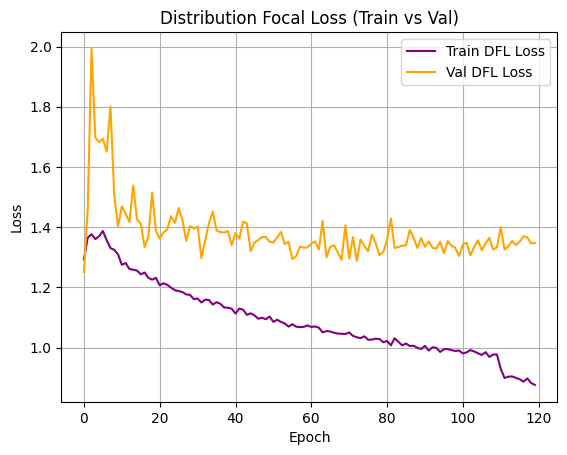

In [ ]:
plt.plot(results["train/dfl_loss"], label="Train DFL Loss", color='purple')
plt.plot(results["val/dfl_loss"], label="Val DFL Loss", color='orange')
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Distribution Focal Loss (Train vs Val)")
plt.legend()
plt.grid(True)
plt.show()


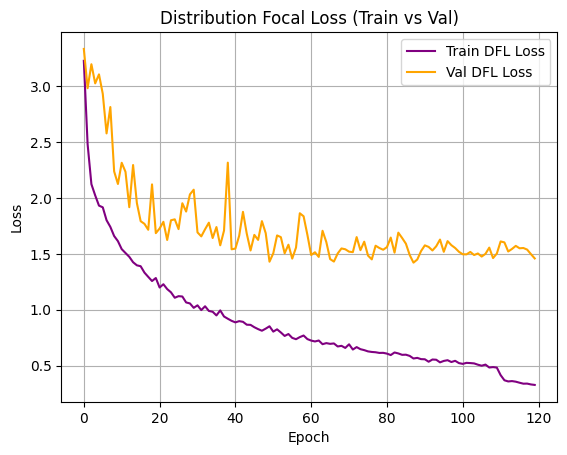

In [ ]:
plt.plot(results["train/cls_loss"], label="Train DFL Loss", color='purple')
plt.plot(results["val/cls_loss"], label="Val DFL Loss", color='orange')
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Distribution Focal Loss (Train vs Val)")
plt.legend()
plt.grid(True)
plt.show()


In [ ]:
from ultralytics import YOLO

model = YOLO("/content/yolo11m.pt")  # أو استخدم مسار المودل الخاص بك

model.train(
    data="/content/vehicle_data/VehiclesDetectionDataset/dataset.yaml",
    epochs=80,
    imgsz=416,
    batch=16,
    device=0,
    patience=30,
    optimizer="AdamW",
    lr0=0.0001,
    lrf=0.01,
    dropout=0.4,
    weight_decay=0.0007,
    freeze=15,
    seed=42,
    hsv_h=0.015,
    hsv_s=0.7,
    hsv_v=0.4,
    degrees=5.0,
    translate=0.1,
    scale=0.5,
    shear=0.0,
    perspective=0.0,
    flipud=0.0,
    fliplr=0.5,
    mosaic=1.0,
    mixup=0.2,
    copy_paste=0.1,
    iou=0.2,
    box=0.1,
    augment=False
)


Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=0.1, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.1, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/vehicle_data/VehiclesDetectionDataset/dataset.yaml, degrees=5.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.4, dynamic=False, embed=None, epochs=80, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=15, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=416, int8=False, iou=0.2, keras=False, kobj=1.0, line_width=None, lr0=0.0001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.2, mode=train, model=/content/yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train5, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, patience=30, perspective=

train: Scanning /content/vehicle_data/VehiclesDetectionDataset/train/labels.cache... 878 images, 0 backgrounds, 0 corrupt: 100%|██████████| 878/878 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 199.1±47.8 MB/s, size: 32.1 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]


Plotting labels to runs/detect/train5/labels.jpg... 
optimizer: AdamW(lr=0.0001, momentum=0.937) with parameter groups 106 weight(decay=0.0), 113 weight(decay=0.0007), 112 bias(decay=0.0)
Image sizes 416 train, 416 val
Using 2 dataloader workers
Logging results to runs/detect/train5
Starting training for 80 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/80      1.79G    0.01586      2.008      1.366         53        416: 100%|██████████| 55/55 [00:13<00:00,  4.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.41it/s]

                   all        250        454      0.388      0.521      0.513      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/80      2.71G    0.01591      1.463      1.354         59        416: 100%|██████████| 55/55 [00:11<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.69it/s]

                   all        250        454      0.574      0.665      0.653      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/80      2.71G    0.01507      1.365      1.328         56        416: 100%|██████████| 55/55 [00:11<00:00,  4.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]

                   all        250        454      0.639      0.719      0.692      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/80      2.71G    0.01479      1.286      1.307         74        416: 100%|██████████| 55/55 [00:10<00:00,  5.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.17it/s]

                   all        250        454       0.67      0.713      0.688      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/80      2.71G    0.01451      1.246      1.312         61        416: 100%|██████████| 55/55 [00:10<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.15it/s]

                   all        250        454      0.647      0.728      0.715       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/80      2.74G    0.01488      1.238      1.322         80        416: 100%|██████████| 55/55 [00:11<00:00,  4.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.62it/s]

                   all        250        454      0.647      0.696      0.696      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/80      2.78G    0.01436      1.194        1.3         61        416: 100%|██████████| 55/55 [00:11<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]

                   all        250        454      0.656      0.716      0.705      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/80      2.78G    0.01413      1.163       1.29         65        416: 100%|██████████| 55/55 [00:11<00:00,  4.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.86it/s]

                   all        250        454      0.662        0.7      0.689      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/80      2.78G     0.0139      1.118      1.263         68        416: 100%|██████████| 55/55 [00:11<00:00,  4.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.86it/s]

                   all        250        454      0.652      0.606      0.667      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/80      2.78G    0.01386      1.122      1.287         56        416: 100%|██████████| 55/55 [00:11<00:00,  4.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.90it/s]

                   all        250        454      0.629      0.731      0.691      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/80      2.78G    0.01347      1.099      1.267         68        416: 100%|██████████| 55/55 [00:11<00:00,  4.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]

                   all        250        454      0.679      0.684      0.716       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/80      2.78G    0.01347      1.091      1.259         58        416: 100%|██████████| 55/55 [00:11<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.86it/s]

                   all        250        454      0.655      0.666      0.691      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/80      2.78G    0.01384      1.075      1.263         76        416: 100%|██████████| 55/55 [00:11<00:00,  4.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.85it/s]

                   all        250        454      0.602      0.718       0.68      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/80      2.78G     0.0135      1.053      1.258         67        416: 100%|██████████| 55/55 [00:11<00:00,  4.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.45it/s]

                   all        250        454      0.627      0.682      0.687      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/80      2.78G    0.01341      1.003      1.244         73        416: 100%|██████████| 55/55 [00:10<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.08it/s]

                   all        250        454      0.646       0.73      0.715      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/80      2.78G    0.01293      1.006      1.235         54        416: 100%|██████████| 55/55 [00:11<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.67it/s]

                   all        250        454      0.613      0.712      0.671      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/80      2.78G    0.01334      1.024      1.253         69        416: 100%|██████████| 55/55 [00:11<00:00,  4.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.82it/s]

                   all        250        454      0.645      0.686      0.688      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/80      2.78G    0.01322      1.005      1.252         74        416: 100%|██████████| 55/55 [00:11<00:00,  4.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.86it/s]

                   all        250        454      0.661      0.698      0.648      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/80      2.78G     0.0134     0.9952      1.238         80        416: 100%|██████████| 55/55 [00:11<00:00,  4.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.75it/s]

                   all        250        454      0.691       0.69      0.695      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/80      2.78G    0.01311     0.9802      1.247         49        416: 100%|██████████| 55/55 [00:11<00:00,  4.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.87it/s]

                   all        250        454       0.75      0.671      0.705      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/80      2.78G     0.0128      0.948      1.225         65        416: 100%|██████████| 55/55 [00:11<00:00,  4.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.80it/s]

                   all        250        454      0.713      0.658      0.686      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/80      2.78G    0.01293     0.9394      1.226         59        416: 100%|██████████| 55/55 [00:11<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.90it/s]

                   all        250        454       0.66        0.7      0.701      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/80      2.78G    0.01272     0.9213      1.216         82        416: 100%|██████████| 55/55 [00:11<00:00,  4.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.86it/s]

                   all        250        454      0.707      0.639       0.67      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/80      2.78G    0.01264     0.9173      1.216         56        416: 100%|██████████| 55/55 [00:11<00:00,  4.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.89it/s]

                   all        250        454      0.577      0.661      0.621      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/80      2.78G    0.01242     0.8917      1.202         63        416: 100%|██████████| 55/55 [00:10<00:00,  5.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.51it/s]

                   all        250        454      0.709      0.632       0.67       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/80      2.78G    0.01283     0.9189      1.225         65        416: 100%|██████████| 55/55 [00:10<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.99it/s]

                   all        250        454      0.698       0.62      0.656      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/80      2.78G    0.01266     0.8935       1.21         79        416: 100%|██████████| 55/55 [00:10<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.21it/s]

                   all        250        454      0.628      0.711      0.681      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/80      2.78G     0.0125     0.8793      1.201         60        416: 100%|██████████| 55/55 [00:11<00:00,  4.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.86it/s]

                   all        250        454      0.687      0.704      0.692       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/80      2.78G    0.01255     0.9099      1.202         53        416: 100%|██████████| 55/55 [00:11<00:00,  4.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.88it/s]

                   all        250        454      0.712      0.653      0.705      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/80      2.78G    0.01233     0.8766      1.191         42        416: 100%|██████████| 55/55 [00:12<00:00,  4.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.81it/s]

                   all        250        454      0.664      0.632       0.66      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/80      2.78G    0.01216     0.8695      1.195         52        416: 100%|██████████| 55/55 [00:11<00:00,  4.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.90it/s]

                   all        250        454      0.618      0.689      0.657      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/80      2.78G    0.01208     0.8564      1.184         94        416: 100%|██████████| 55/55 [00:11<00:00,  4.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.86it/s]

                   all        250        454      0.692      0.693      0.684      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/80      2.78G    0.01254     0.8756      1.205         54        416: 100%|██████████| 55/55 [00:11<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.80it/s]

                   all        250        454      0.648      0.684      0.679       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/80      2.78G    0.01208     0.8493       1.19         75        416: 100%|██████████| 55/55 [00:11<00:00,  4.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.44it/s]

                   all        250        454      0.626      0.721      0.695      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/80      2.78G    0.01221     0.8447      1.186         66        416: 100%|██████████| 55/55 [00:11<00:00,  4.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.77it/s]

                   all        250        454      0.675      0.697      0.698      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/80      2.78G    0.01207     0.8387       1.18         59        416: 100%|██████████| 55/55 [00:10<00:00,  5.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.43it/s]

                   all        250        454      0.696        0.7      0.714      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/80      2.78G    0.01232      0.847      1.205         80        416: 100%|██████████| 55/55 [00:10<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.05it/s]

                   all        250        454      0.614      0.735      0.678      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/80      2.78G    0.01218      0.845      1.192         63        416: 100%|██████████| 55/55 [00:10<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.31it/s]

                   all        250        454       0.64       0.69      0.667      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/80      2.78G     0.0118      0.812      1.184         72        416: 100%|██████████| 55/55 [00:11<00:00,  4.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.67it/s]

                   all        250        454      0.685      0.659      0.678      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/80      2.78G    0.01186     0.7932      1.181         88        416: 100%|██████████| 55/55 [00:11<00:00,  4.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.88it/s]

                   all        250        454      0.738      0.606      0.687      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/80      2.78G    0.01194     0.7861      1.174         39        416: 100%|██████████| 55/55 [00:10<00:00,  5.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.60it/s]

                   all        250        454       0.67      0.705      0.675      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/80      2.78G    0.01194     0.8068      1.178         59        416: 100%|██████████| 55/55 [00:11<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.85it/s]

                   all        250        454      0.683      0.675      0.672      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/80      2.78G    0.01161     0.7898      1.168         68        416: 100%|██████████| 55/55 [00:11<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.18it/s]

                   all        250        454      0.672      0.679      0.698      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/80      2.78G    0.01158     0.7818      1.167         55        416: 100%|██████████| 55/55 [00:11<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.84it/s]

                   all        250        454      0.657      0.649      0.693       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/80      2.78G    0.01195     0.8202      1.187         55        416: 100%|██████████| 55/55 [00:11<00:00,  4.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.80it/s]

                   all        250        454      0.607      0.694      0.672       0.51
EarlyStopping: Training stopped early as no improvement observed in last 30 epochs. Best results observed at epoch 15, best model saved as best.pt.
To update EarlyStopping(patience=30) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



45 epochs completed in 0.176 hours.
Optimizer stripped from runs/detect/train5/weights/last.pt, 40.5MB
Optimizer stripped from runs/detect/train5/weights/best.pt, 40.5MB

Validating runs/detect/train5/weights/best.pt...
Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11m summary (fused): 125 layers, 20,033,887 parameters, 0 gradients, 67.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.16it/s]


                   all        250        454      0.647       0.73      0.715      0.557
             Ambulance         50         64       0.68      0.812      0.851      0.717
                   Bus         30         46      0.668      0.787      0.825      0.659
                   Car         90        238       0.53      0.639      0.598       0.45
            Motorcycle         42         46      0.676      0.913      0.794      0.598
                 Truck         38         60      0.679        0.5      0.507      0.363
Speed: 0.1ms preprocess, 5.1ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to runs/detect/train5


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7dfaa4dd4050>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
# Define the path to the directory
post_training_files_path = '/content/runs/detect/train5'

# List the files in the directory
!ls {post_training_files_path}

args.yaml			 PR_curve.png	   val_batch0_labels.jpg
confusion_matrix_normalized.png  R_curve.png	   val_batch0_pred.jpg
confusion_matrix.png		 results.csv	   val_batch1_labels.jpg
F1_curve.png			 results.png	   val_batch1_pred.jpg
labels_correlogram.jpg		 train_batch0.jpg  val_batch2_labels.jpg
labels.jpg			 train_batch1.jpg  val_batch2_pred.jpg
P_curve.png			 train_batch2.jpg  weights


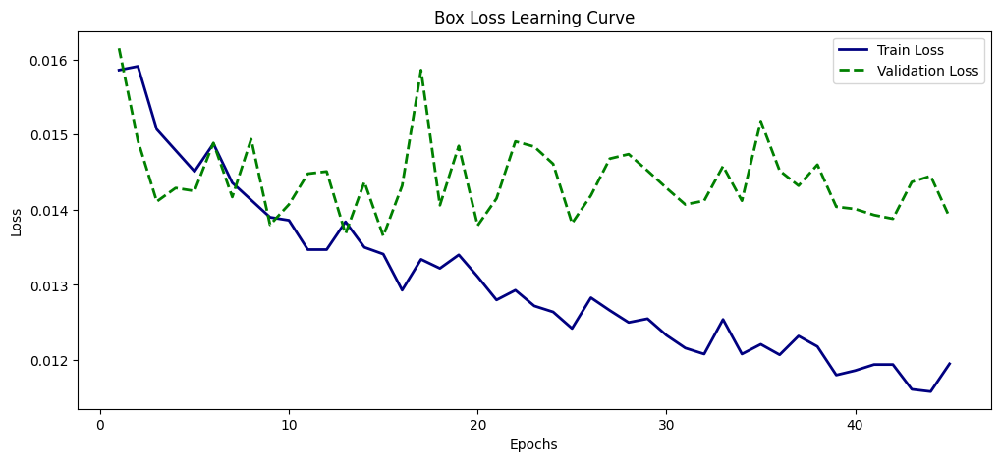

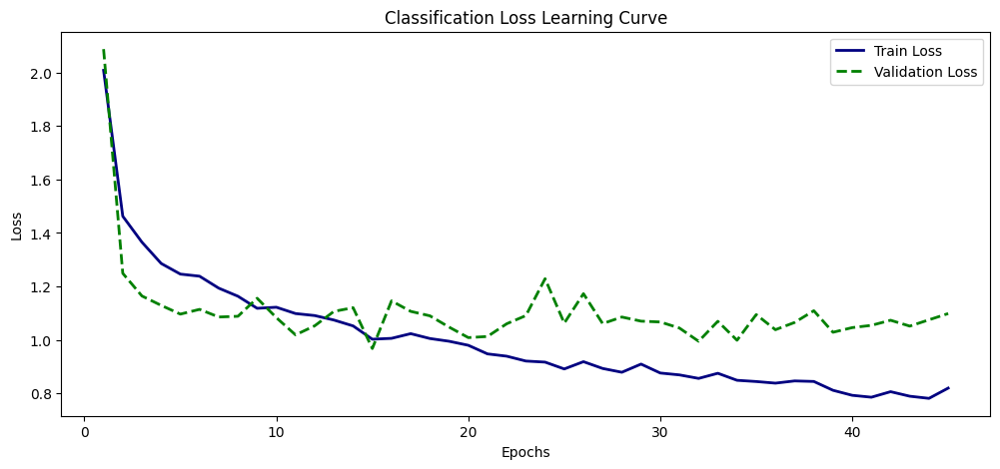

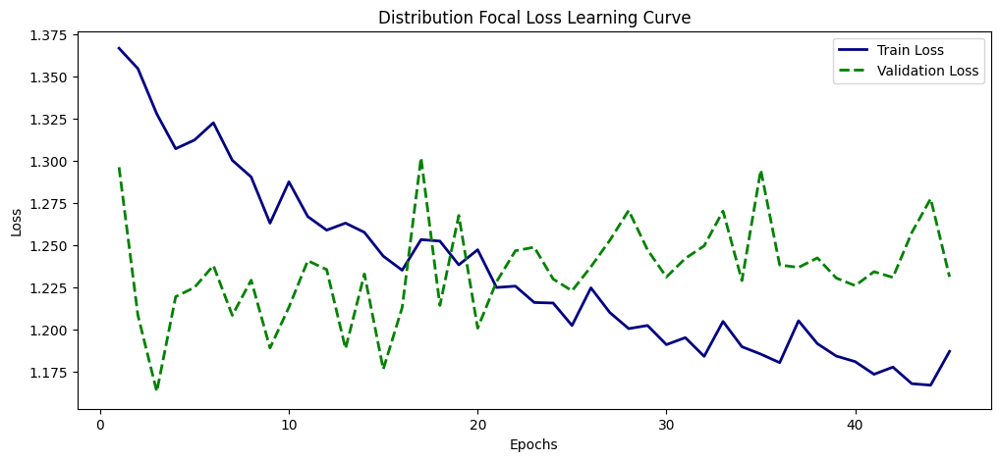

In [ ]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

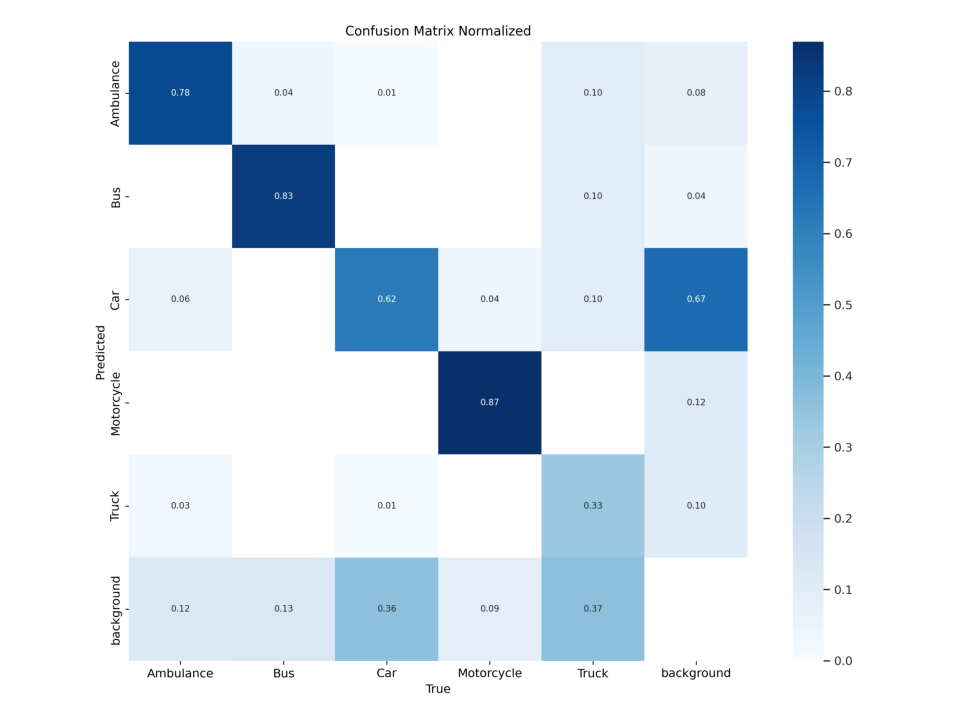

In [ ]:
# Construct the path to the normalized confusion matrix image
confusion_matrix_path = os.path.join(post_training_files_path, 'confusion_matrix_normalized.png')

# Read the image using cv2
cm_img = cv2.imread(confusion_matrix_path)

# Convert the image from BGR to RGB color space for accurate color representation with matplotlib
cm_img = cv2.cvtColor(cm_img, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(10, 10), dpi=120)
plt.imshow(cm_img)
plt.axis('off')
plt.show()

In [ ]:
# Construct the path to the best model weights file using os.path.join
best_model_path_yolo_detect = os.path.join(post_training_files_path, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model_yolo_detect = YOLO(best_model_path_yolo_detect)

# Validate the best model using the validation set with default parameters
metrics_yolo_detect = best_model_yolo_detect.val(split='val')

Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11m summary (fused): 125 layers, 20,033,887 parameters, 0 gradients, 67.7 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 952.1±246.4 MB/s, size: 31.0 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.26it/s]


                   all        250        454      0.692      0.725      0.755      0.574
             Ambulance         50         64      0.748      0.938      0.937      0.773
                   Bus         30         46      0.746      0.783       0.82      0.653
                   Car         90        238      0.579      0.624      0.629      0.465
            Motorcycle         42         46      0.716      0.877      0.838      0.595
                 Truck         38         60      0.669      0.405      0.549      0.383
Speed: 0.7ms preprocess, 12.3ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to runs/detect/val4


addd more data to **valid**

In [ ]:
import os
import random
import shutil

# المسارات
base_dir = "/content/vehicle_data/VehiclesDetectionDataset"
train_images_dir = os.path.join(base_dir, "train/images")
train_labels_dir = os.path.join(base_dir, "train/labels")

valid_images_dir = os.path.join(base_dir, "valid/images")
valid_labels_dir = os.path.join(base_dir, "valid/labels")

# إنشاء مجلدات valid إن لم تكن موجودة
os.makedirs(valid_images_dir, exist_ok=True)
os.makedirs(valid_labels_dir, exist_ok=True)

# الحصول على أسماء الملفات (بدون الامتداد)
image_files = [f for f in os.listdir(train_images_dir) if f.endswith(".jpg")]
image_names = [os.path.splitext(f)[0] for f in image_files]

# خلط وتقسيم
random.seed(42)
random.shuffle(image_names)
split_idx = int(len(image_names) * 0.25)  # 25% للتحقق

val_names = image_names[:split_idx]  # نأخذ 25% من training للـ validation

# نقل الملفات
for name in val_names:
    img_src = os.path.join(train_images_dir, name + ".jpg")
    lbl_src = os.path.join(train_labels_dir, name + ".txt")

    img_dst = os.path.join(valid_images_dir, name + ".jpg")
    lbl_dst = os.path.join(valid_labels_dir, name + ".txt")

    if os.path.exists(img_src) and os.path.exists(lbl_src):
        shutil.move(img_src, img_dst)
        shutil.move(lbl_src, lbl_dst)

print(f"✅ تم نقل {len(val_names)} صورة إلى مجلد valid.")


✅ تم نقل 219 صورة إلى مجلد valid.


In [ ]:
from PIL import Image

# Set paths for training and validation image sets
train_images_path = os.path.join(dataset_path, 'train', 'images')
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# Initialize counters for the number of images
num_train_images = 0
num_valid_images = 0

# Initialize sets to hold the unique sizes of images
train_image_sizes = set()
valid_image_sizes = set()

# Check train images sizes and count
for filename in os.listdir(train_images_path):
    if filename.endswith('.jpg'):
        num_train_images += 1
        image_path = os.path.join(train_images_path, filename)
        with Image.open(image_path) as img:
            train_image_sizes.add(img.size)

# Check validation images sizes and count
for filename in os.listdir(valid_images_path):
    if filename.endswith('.jpg'):
        num_valid_images += 1
        image_path = os.path.join(valid_images_path, filename)
        with Image.open(image_path) as img:
            valid_image_sizes.add(img.size)

# Print the results
print(f"Number of training images: {num_train_images}")
print(f"Number of validation images: {num_valid_images}")

# Check if all images in training set have the same size
if len(train_image_sizes) == 1:
    print(f"All training images have the same size: {train_image_sizes.pop()}")
else:
    print("Training images have varying sizes.")

# Check if all images in validation set have the same size
if len(valid_image_sizes) == 1:
    print(f"All validation images have the same size: {valid_image_sizes.pop()}")
else:
    print("Validation images have varying sizes.")

Number of training images: 659
Number of validation images: 469
All training images have the same size: (416, 416)
All validation images have the same size: (416, 416)


In [ ]:
import os
import yaml

# Define the dataset_path
dataset_path = '/content/vehicle_data/VehiclesDetectionDataset'

# Set the path to the YAML file
yaml_file_path = os.path.join(dataset_path, 'dataset.yaml')

# Load and print the contents of the YAML file
with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader=yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))


names:
- Ambulance
- Bus
- Car
- Motorcycle
- Truck
nc: 5
test: ../test/images
train: ../train/images
val: ../valid/images



In [ ]:
from ultralytics import YOLO

model = YOLO("/content/yolo11m.pt")

model.train(
    data="/content/vehicle_data/VehiclesDetectionDataset/dataset.yaml",
    epochs=80,
    imgsz=416,
    batch=16,
    device=0,
    patience=20,
    optimizer="AdamW",
    lr0=0.001,
    lrf=0.01,
    dropout=0.5,
    weight_decay=0.0007,
    freeze=20,
    seed=42,
    hsv_h=0.005,
    hsv_s=0.3,
    hsv_v=0.3,
    degrees=2.0,
    translate=0.05,
    scale=0.3,
    shear=0.0,
    perspective=0.0,
    flipud=0.0,
    fliplr=0.3,
    mosaic=0.3,
    mixup=0.0,
    copy_paste=0.0,
    iou=0.2,
    box=0.1
)


Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=0.1, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/vehicle_data/VehiclesDetectionDataset/dataset.yaml, degrees=2.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.5, dynamic=False, embed=None, epochs=80, erasing=0.4, exist_ok=False, fliplr=0.3, flipud=0.0, format=torchscript, fraction=1.0, freeze=20, half=False, hsv_h=0.005, hsv_s=0.3, hsv_v=0.3, imgsz=416, int8=False, iou=0.2, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/yolo11m.pt, momentum=0.937, mosaic=0.3, multi_scale=False, name=train7, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, overlap_mask=True, patience=20, perspective=0

train: Scanning /content/vehicle_data/VehiclesDetectionDataset/train/labels... 659 images, 0 backgrounds, 0 corrupt: 100%|██████████| 659/659 [00:00<00:00, 2236.83it/s]


train: New cache created: /content/vehicle_data/VehiclesDetectionDataset/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 324.4±310.4 MB/s, size: 33.5 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels... 469 images, 0 backgrounds, 0 corrupt: 100%|██████████| 469/469 [00:00<00:00, 863.23it/s]

val: New cache created: /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache


Plotting labels to runs/detect/train7/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 106 weight(decay=0.0), 113 weight(decay=0.0007), 112 bias(decay=0.0)
Image sizes 416 train, 416 val
Using 2 dataloader workers
Logging results to runs/detect/train7
Starting training for 80 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/80      1.37G    0.01372      1.806      1.264          4        416: 100%|██████████| 42/42 [00:09<00:00,  4.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.64it/s]

                   all        469        851      0.586      0.667      0.616      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/80      2.47G    0.01486      1.388      1.302          6        416: 100%|██████████| 42/42 [00:07<00:00,  5.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.70it/s]

                   all        469        851      0.586      0.661      0.643      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/80      2.47G    0.01466      1.265      1.311          5        416: 100%|██████████| 42/42 [00:07<00:00,  5.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.78it/s]


                   all        469        851      0.624      0.604      0.662      0.429

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/80      2.47G    0.01511      1.174      1.321          8        416: 100%|██████████| 42/42 [00:07<00:00,  5.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.72it/s]


                   all        469        851      0.601       0.65      0.661      0.473

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/80      2.47G    0.01419      1.169      1.281          7        416: 100%|██████████| 42/42 [00:06<00:00,  6.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.42it/s]


                   all        469        851      0.695      0.682      0.711      0.519

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/80      2.47G    0.01375      1.072      1.263         13        416: 100%|██████████| 42/42 [00:06<00:00,  6.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.38it/s]

                   all        469        851       0.72      0.715      0.751      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/80      2.47G    0.01321      1.021      1.238          3        416: 100%|██████████| 42/42 [00:06<00:00,  6.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.34it/s]

                   all        469        851      0.687      0.728      0.731      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/80       2.5G    0.01302      1.013      1.233          5        416: 100%|██████████| 42/42 [00:06<00:00,  6.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.56it/s]

                   all        469        851      0.728      0.721      0.742      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/80      2.52G    0.01339      1.029      1.242          5        416: 100%|██████████| 42/42 [00:06<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.78it/s]


                   all        469        851      0.735      0.731      0.769       0.57

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/80      2.52G    0.01274     0.9475      1.225         11        416: 100%|██████████| 42/42 [00:07<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.80it/s]

                   all        469        851      0.694      0.725       0.75      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/80      2.52G    0.01265     0.9426      1.218         12        416: 100%|██████████| 42/42 [00:07<00:00,  5.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.81it/s]


                   all        469        851      0.723      0.707      0.742      0.551

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/80      2.52G    0.01303     0.9306      1.232         11        416: 100%|██████████| 42/42 [00:07<00:00,  5.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.83it/s]


                   all        469        851      0.726      0.757      0.768      0.573

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/80      2.52G    0.01281     0.9092      1.201         10        416: 100%|██████████| 42/42 [00:07<00:00,  5.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.86it/s]

                   all        469        851      0.764      0.754      0.773      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/80      2.52G    0.01194     0.8771      1.187         12        416: 100%|██████████| 42/42 [00:07<00:00,  5.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.82it/s]


                   all        469        851      0.753      0.714      0.755      0.579

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/80      2.52G    0.01185     0.8179      1.161          7        416: 100%|██████████| 42/42 [00:07<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.70it/s]

                   all        469        851      0.789      0.719      0.786      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/80      2.52G     0.0118     0.8243       1.17          9        416: 100%|██████████| 42/42 [00:06<00:00,  6.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.42it/s]

                   all        469        851      0.755      0.733      0.759      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/80      2.52G    0.01175      0.812      1.167          7        416: 100%|██████████| 42/42 [00:06<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.29it/s]


                   all        469        851      0.776      0.737       0.78      0.599

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/80      2.52G     0.0114     0.7787      1.156          4        416: 100%|██████████| 42/42 [00:06<00:00,  6.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.30it/s]

                   all        469        851      0.751      0.695      0.758      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/80      2.52G    0.01185     0.8372      1.161          9        416: 100%|██████████| 42/42 [00:06<00:00,  6.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.46it/s]

                   all        469        851      0.756      0.757       0.78      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/80      2.52G    0.01158       0.79       1.16          5        416: 100%|██████████| 42/42 [00:06<00:00,  6.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.78it/s]

                   all        469        851      0.787      0.741      0.788      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/80      2.52G    0.01113     0.7901      1.135          6        416: 100%|██████████| 42/42 [00:06<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.83it/s]


                   all        469        851      0.787      0.716      0.758      0.585

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/80      2.52G    0.01146      0.765      1.143         11        416: 100%|██████████| 42/42 [00:07<00:00,  5.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.82it/s]

                   all        469        851      0.782      0.746      0.781      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/80      2.52G    0.01147      0.746      1.154          9        416: 100%|██████████| 42/42 [00:07<00:00,  5.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.85it/s]

                   all        469        851       0.78      0.741      0.779      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/80      2.52G    0.01117      0.772      1.128         11        416: 100%|██████████| 42/42 [00:07<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.76it/s]

                   all        469        851      0.803      0.741      0.778      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/80      2.52G    0.01098     0.7374      1.126          6        416: 100%|██████████| 42/42 [00:07<00:00,  5.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.81it/s]

                   all        469        851      0.785      0.754      0.784       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/80      2.52G    0.01063     0.7172      1.112         11        416: 100%|██████████| 42/42 [00:07<00:00,  5.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.78it/s]

                   all        469        851      0.755      0.779      0.803      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/80      2.52G    0.01057     0.7037      1.112          8        416: 100%|██████████| 42/42 [00:06<00:00,  6.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.43it/s]


                   all        469        851      0.778      0.767      0.795      0.608

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/80      2.52G    0.01064     0.7111      1.113          8        416: 100%|██████████| 42/42 [00:06<00:00,  6.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.28it/s]

                   all        469        851      0.819       0.75      0.801      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/80      2.52G    0.01037     0.6765        1.1          5        416: 100%|██████████| 42/42 [00:06<00:00,  6.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.27it/s]

                   all        469        851       0.84       0.72       0.79      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/80      2.52G    0.01053     0.6986      1.094         10        416: 100%|██████████| 42/42 [00:06<00:00,  6.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.45it/s]

                   all        469        851      0.859       0.73      0.804      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/80      2.52G    0.01054      0.663      1.106          6        416: 100%|██████████| 42/42 [00:06<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.57it/s]

                   all        469        851      0.807      0.755      0.806      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/80      2.52G    0.01049      0.694      1.113          5        416: 100%|██████████| 42/42 [00:06<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.79it/s]


                   all        469        851      0.779      0.772      0.797      0.631

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/80      2.52G     0.0107     0.7113      1.109          5        416: 100%|██████████| 42/42 [00:07<00:00,  5.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.80it/s]

                   all        469        851        0.8       0.77      0.816      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/80      2.52G    0.01013     0.6382      1.081          4        416: 100%|██████████| 42/42 [00:07<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.90it/s]

                   all        469        851      0.825      0.759      0.807      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/80      2.52G    0.01035     0.6431      1.097          8        416: 100%|██████████| 42/42 [00:07<00:00,  5.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.81it/s]


                   all        469        851      0.804      0.759      0.811      0.625

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/80      2.52G   0.009863     0.6266      1.075          3        416: 100%|██████████| 42/42 [00:07<00:00,  5.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.82it/s]

                   all        469        851      0.808      0.735      0.815      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/80      2.52G    0.01006     0.6631      1.081         10        416: 100%|██████████| 42/42 [00:07<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.80it/s]

                   all        469        851      0.797      0.763       0.81      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/80      2.52G   0.009756     0.6429      1.076         11        416: 100%|██████████| 42/42 [00:07<00:00,  5.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.64it/s]

                   all        469        851      0.812      0.749      0.806      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/80      2.52G    0.00995     0.6381      1.079          6        416: 100%|██████████| 42/42 [00:06<00:00,  6.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.44it/s]


                   all        469        851      0.802      0.722      0.787      0.618

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/80      2.52G   0.009618     0.6179       1.06         10        416: 100%|██████████| 42/42 [00:06<00:00,  6.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.35it/s]


                   all        469        851      0.773      0.769      0.804      0.645

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/80      2.52G   0.009514     0.6178      1.062          7        416: 100%|██████████| 42/42 [00:06<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.43it/s]

                   all        469        851      0.828       0.75      0.811      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/80      2.52G   0.009408     0.6154      1.063          3        416: 100%|██████████| 42/42 [00:06<00:00,  6.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.60it/s]

                   all        469        851      0.827      0.762      0.821      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/80      2.52G   0.009679     0.6283      1.065          9        416: 100%|██████████| 42/42 [00:06<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.76it/s]


                   all        469        851      0.806      0.791      0.814      0.636

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/80      2.52G     0.0095     0.5926      1.063          4        416: 100%|██████████| 42/42 [00:07<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.71it/s]

                   all        469        851      0.805      0.759      0.819      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/80      2.52G   0.009751     0.6268      1.079          4        416: 100%|██████████| 42/42 [00:07<00:00,  5.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.82it/s]


                   all        469        851      0.882      0.743      0.829      0.663

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/80      2.52G   0.009351     0.5867      1.048          7        416: 100%|██████████| 42/42 [00:07<00:00,  5.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.77it/s]


                   all        469        851      0.846      0.734      0.813      0.646

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/80      2.52G    0.00937     0.5791      1.046          9        416: 100%|██████████| 42/42 [00:07<00:00,  5.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.83it/s]


                   all        469        851      0.867      0.744      0.827      0.658

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/80      2.52G   0.009226     0.5528      1.042          3        416: 100%|██████████| 42/42 [00:07<00:00,  5.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.80it/s]


                   all        469        851      0.811      0.782      0.821       0.65

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/80      2.52G   0.009225     0.5667       1.05          6        416: 100%|██████████| 42/42 [00:07<00:00,  5.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.82it/s]

                   all        469        851      0.851      0.745      0.821      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/80      2.52G   0.009596        0.6      1.073         14        416: 100%|██████████| 42/42 [00:06<00:00,  6.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.46it/s]

                   all        469        851      0.825       0.77      0.823      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      51/80      2.52G   0.009416     0.5842      1.058          8        416: 100%|██████████| 42/42 [00:06<00:00,  6.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.28it/s]

                   all        469        851      0.774      0.801      0.823       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      52/80      2.52G   0.009197     0.5848      1.045          7        416: 100%|██████████| 42/42 [00:06<00:00,  6.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.34it/s]

                   all        469        851      0.805      0.764      0.812       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      53/80      2.52G   0.009483     0.5711      1.065          6        416: 100%|██████████| 42/42 [00:06<00:00,  6.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.39it/s]

                   all        469        851      0.801      0.762      0.808       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      54/80      2.52G   0.009227     0.5734      1.044          7        416: 100%|██████████| 42/42 [00:06<00:00,  6.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.66it/s]

                   all        469        851      0.831      0.763      0.828      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      55/80      2.52G    0.00952     0.5968      1.057          6        416: 100%|██████████| 42/42 [00:07<00:00,  5.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.74it/s]

                   all        469        851      0.804       0.77      0.828       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      56/80      2.52G   0.009123      0.565      1.037          5        416: 100%|██████████| 42/42 [00:07<00:00,  5.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.81it/s]

                   all        469        851      0.866      0.737      0.827      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      57/80      2.52G   0.008998     0.5692      1.028          8        416: 100%|██████████| 42/42 [00:07<00:00,  5.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.83it/s]

                   all        469        851       0.86      0.741      0.835      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      58/80      2.52G    0.00887     0.5463      1.045          7        416: 100%|██████████| 42/42 [00:07<00:00,  5.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.76it/s]

                   all        469        851      0.796      0.795      0.836      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      59/80      2.52G    0.00908     0.5499      1.034          5        416: 100%|██████████| 42/42 [00:07<00:00,  5.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.81it/s]

                   all        469        851      0.865      0.738      0.827      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      60/80      2.52G   0.008796      0.555      1.035          8        416: 100%|██████████| 42/42 [00:07<00:00,  5.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.79it/s]


                   all        469        851      0.862      0.737      0.831      0.676

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      61/80      2.52G   0.008834     0.5452      1.027          9        416: 100%|██████████| 42/42 [00:06<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.54it/s]


                   all        469        851      0.815      0.769      0.827      0.673

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      62/80      2.52G   0.008888     0.5535       1.03          6        416: 100%|██████████| 42/42 [00:06<00:00,  6.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.40it/s]

                   all        469        851      0.801      0.783      0.826      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      63/80      2.52G   0.008646     0.5196      1.011          5        416: 100%|██████████| 42/42 [00:06<00:00,  6.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.40it/s]


                   all        469        851      0.792       0.79       0.83      0.684

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      64/80      2.52G   0.008867     0.5499      1.037         11        416: 100%|██████████| 42/42 [00:06<00:00,  6.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.31it/s]

                   all        469        851       0.81      0.758      0.824      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      65/80      2.52G   0.008786     0.5378      1.036         12        416: 100%|██████████| 42/42 [00:06<00:00,  6.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.54it/s]

                   all        469        851      0.874       0.73      0.828      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      66/80      2.52G   0.008287     0.4925      1.016          5        416: 100%|██████████| 42/42 [00:06<00:00,  6.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.82it/s]


                   all        469        851      0.853      0.755      0.832      0.681

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      67/80      2.52G   0.008655     0.5174      1.024          7        416: 100%|██████████| 42/42 [00:07<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.54it/s]


                   all        469        851       0.81      0.784      0.835      0.683

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      68/80      2.52G   0.008663     0.5277      1.021          3        416: 100%|██████████| 42/42 [00:07<00:00,  5.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.85it/s]


                   all        469        851      0.849      0.756      0.833      0.677

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      69/80      2.52G   0.008222     0.5135      1.008         10        416: 100%|██████████| 42/42 [00:07<00:00,  5.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.80it/s]

                   all        469        851      0.872      0.744      0.838      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      70/80      2.52G   0.008531     0.5191      1.021          6        416: 100%|██████████| 42/42 [00:07<00:00,  5.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.80it/s]


                   all        469        851      0.828       0.77      0.839      0.679
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      71/80      2.52G   0.006744     0.3586     0.9302          4        416: 100%|██████████| 42/42 [00:08<00:00,  4.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.77it/s]


                   all        469        851      0.872      0.753      0.834      0.678

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      72/80      2.52G   0.006889     0.3617     0.9272          3        416: 100%|██████████| 42/42 [00:07<00:00,  5.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.82it/s]


                   all        469        851      0.848      0.767      0.837      0.682

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      73/80      2.52G   0.006763     0.3592     0.9331          9        416: 100%|██████████| 42/42 [00:07<00:00,  5.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.76it/s]

                   all        469        851      0.843      0.768      0.837      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      74/80      2.52G   0.006817     0.3661     0.9308          3        416: 100%|██████████| 42/42 [00:06<00:00,  6.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.51it/s]

                   all        469        851      0.846      0.764      0.829      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      75/80      2.52G   0.006765     0.3592     0.9257          9        416: 100%|██████████| 42/42 [00:06<00:00,  6.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.30it/s]


                   all        469        851      0.869      0.745      0.832      0.678

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      76/80      2.52G    0.00682     0.3616     0.9292          4        416: 100%|██████████| 42/42 [00:06<00:00,  6.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.33it/s]

                   all        469        851      0.867       0.75      0.833      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      77/80      2.52G    0.00675     0.3548     0.9349          3        416: 100%|██████████| 42/42 [00:06<00:00,  6.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.49it/s]

                   all        469        851      0.874      0.745      0.833      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      78/80      2.52G   0.006735     0.3678      0.929          3        416: 100%|██████████| 42/42 [00:06<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.73it/s]

                   all        469        851      0.859      0.749      0.832      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      79/80      2.52G   0.006572      0.354     0.9151          6        416: 100%|██████████| 42/42 [00:07<00:00,  5.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.80it/s]


                   all        469        851      0.893      0.727      0.834      0.688

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      80/80      2.52G   0.006617     0.3501     0.9321          3        416: 100%|██████████| 42/42 [00:07<00:00,  5.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.88it/s]

                   all        469        851      0.888      0.728      0.834      0.685



80 epochs completed in 0.262 hours.
Optimizer stripped from runs/detect/train7/weights/last.pt, 40.5MB
Optimizer stripped from runs/detect/train7/weights/best.pt, 40.5MB

Validating runs/detect/train7/weights/best.pt...
Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11m summary (fused): 125 layers, 20,033,887 parameters, 0 gradients, 67.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:06<00:00,  2.48it/s]


                   all        469        851      0.893      0.727      0.834      0.688
             Ambulance         78         97       0.92      0.814      0.924      0.826
                   Bus         68         99      0.916      0.899      0.917      0.823
                   Car        172        443      0.864      0.596      0.741      0.577
            Motorcycle         75        106      0.911      0.773      0.835      0.633
                 Truck         76        106      0.855      0.555      0.754       0.58
Speed: 0.1ms preprocess, 4.8ms inference, 0.0ms loss, 2.4ms postprocess per image
Results saved to runs/detect/train7


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7dfb2d12b990>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
# Define the path to the directory
post_training_files_path = '/content/runs/detect/train7'

# List the files in the directory
!ls {post_training_files_path}

args.yaml			 R_curve.png	      train_batch2.jpg
confusion_matrix_normalized.png  results.csv	      val_batch0_labels.jpg
confusion_matrix.png		 results.png	      val_batch0_pred.jpg
F1_curve.png			 train_batch0.jpg     val_batch1_labels.jpg
labels_correlogram.jpg		 train_batch1.jpg     val_batch1_pred.jpg
labels.jpg			 train_batch2940.jpg  val_batch2_labels.jpg
P_curve.png			 train_batch2941.jpg  val_batch2_pred.jpg
PR_curve.png			 train_batch2942.jpg  weights


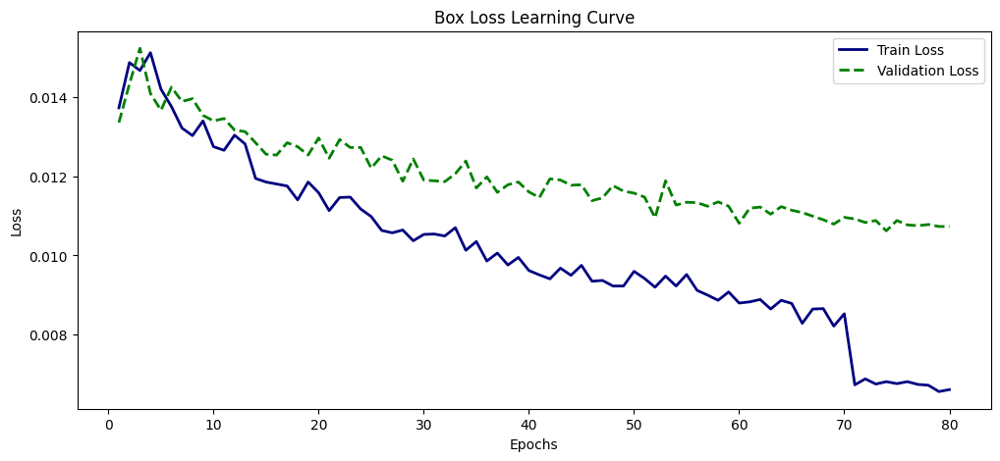

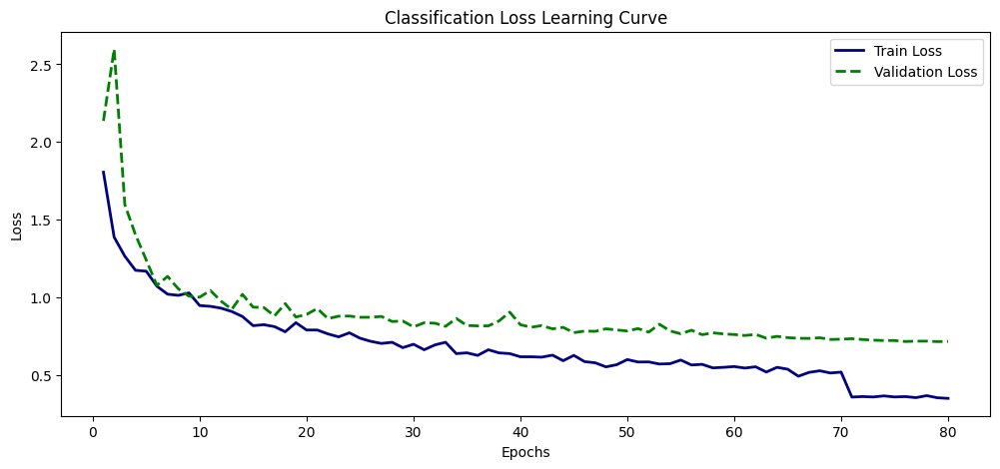

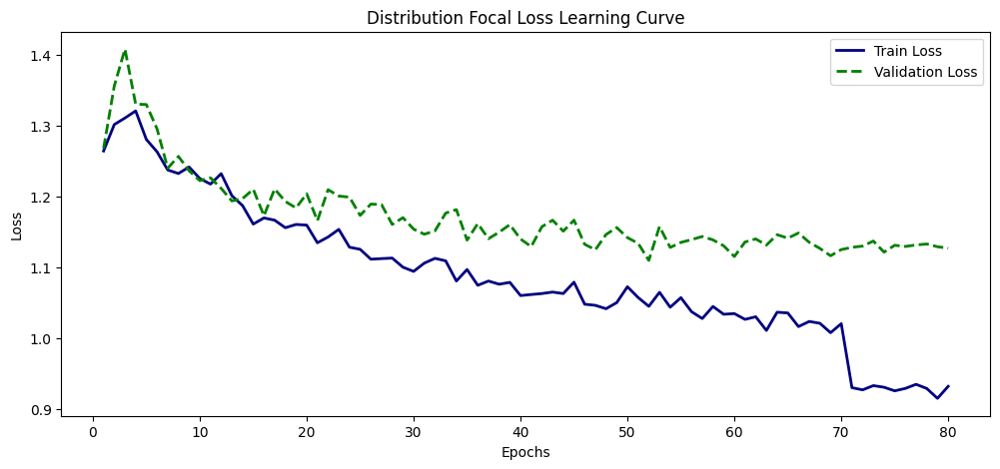

In [ ]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

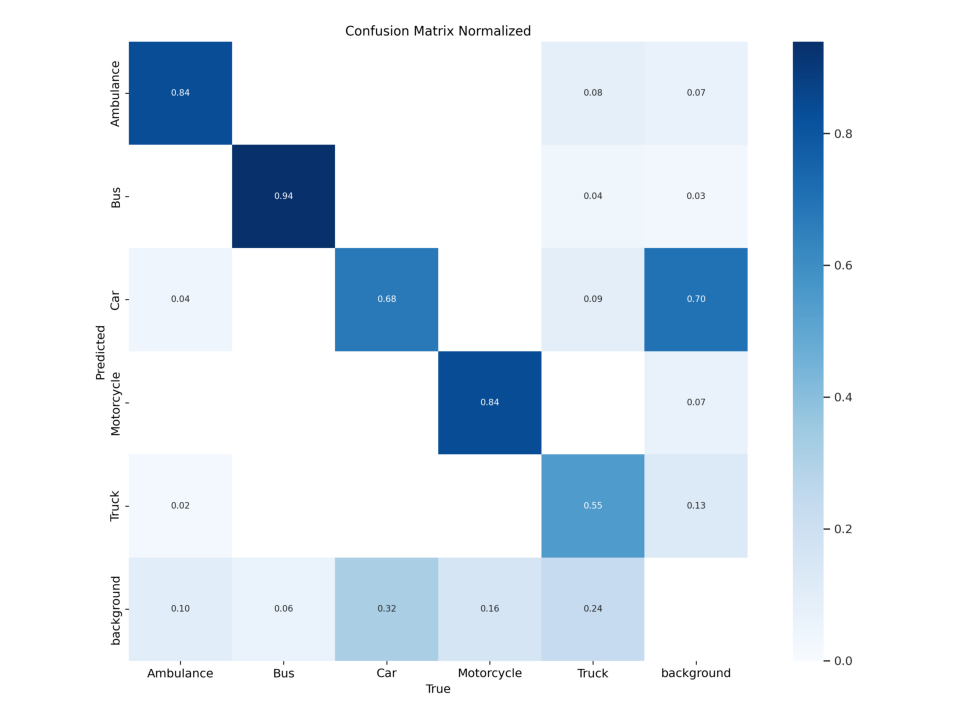

In [ ]:
# Construct the path to the normalized confusion matrix image
confusion_matrix_path = os.path.join(post_training_files_path, 'confusion_matrix_normalized.png')

# Read the image using cv2
cm_img = cv2.imread(confusion_matrix_path)

# Convert the image from BGR to RGB color space for accurate color representation with matplotlib
cm_img = cv2.cvtColor(cm_img, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(10, 10), dpi=120)
plt.imshow(cm_img)
plt.axis('off')
plt.show()

In [ ]:
# Construct the path to the best model weights file using os.path.join
best_model_path_yolo_detect = os.path.join(post_training_files_path, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model_yolo_detect = YOLO(best_model_path_yolo_detect)

# Validate the best model using the validation set with default parameters
metrics_yolo_detect = best_model_yolo_detect.val(split='val')

Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11m summary (fused): 125 layers, 20,033,887 parameters, 0 gradients, 67.7 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 916.0±496.1 MB/s, size: 30.8 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 469 images, 0 backgrounds, 0 corrupt: 100%|██████████| 469/469 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:08<00:00,  3.49it/s]


                   all        469        851       0.89      0.751      0.856      0.699
             Ambulance         78         97      0.921      0.835      0.938      0.833
                   Bus         68         99      0.914      0.899      0.926      0.823
                   Car        172        443      0.862      0.646      0.771      0.587
            Motorcycle         75        106      0.896      0.811       0.89      0.676
                 Truck         76        106      0.857      0.564      0.757      0.578
Speed: 0.6ms preprocess, 12.3ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs/detect/val6



image 1/1 /content/vehicle_data/VehiclesDetectionDataset/test/images/a3cffcdbff959432_jpg.rf.4MQ1NmvMx33nwLe9QSvu.jpg: 416x416 1 Car, 1 Truck, 21.6ms
Speed: 1.2ms preprocess, 21.6ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /content/vehicle_data/VehiclesDetectionDataset/test/images/a3cffcdbff959432_jpg.rf.1f1f8cfcdfe052a8ec72e63b11889b66.jpg: 416x416 1 Car, 1 Truck, 21.6ms
Speed: 1.0ms preprocess, 21.6ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /content/vehicle_data/VehiclesDetectionDataset/test/images/a7674f15d9b1f35f_jpg.rf.pL09u0Oz8DRvTB3AnBXT.jpg: 416x416 1 Ambulance, 21.6ms
Speed: 0.9ms preprocess, 21.6ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /content/vehicle_data/VehiclesDetectionDataset/test/images/aed83d879a22a6c4_jpg.rf.ada6c87c88d32689f79e3a03c9ebd314.jpg: 416x416 (no detections), 19.4ms
Speed: 0.8ms preprocess, 19.4ms inference, 0.6ms postprocess per image at shape (1,

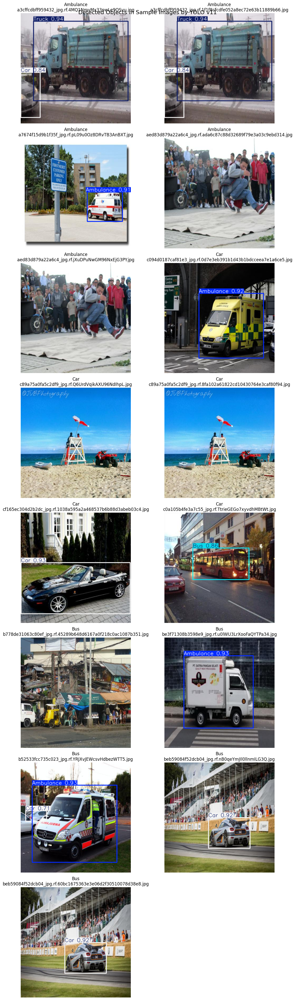

In [ ]:
# Load the trained YOLO v11 segmentation model
best_model = YOLO("/content/runs/detect/train7/weights/best.pt")  # Update with your model path

# Path to the test image folder
test_images_path = Path("/content/vehicle_data/VehiclesDetectionDataset/test/images")

# Define class mapping based on the first letter in filenames
class_mapping = {
    "A": "Ambulance",
    "C": "Car",
    "M": "Motorcycle",
    "B": "Bus",
    "T": "Truck"
}

# Collect images by class
image_classes = {cls: [] for cls in class_mapping.keys()}

# Ensure the directory exists
if not test_images_path.exists():
    raise FileNotFoundError(f"Error: The path {test_images_path} does not exist!")

# Iterate through images and categorize them
for img_name in os.listdir(test_images_path):
    if img_name.endswith(('.jpg', '.png', '.jpeg')):
        class_letter = img_name[0].upper()  # Convert to uppercase
        if class_letter in image_classes:
            image_classes[class_letter].append(img_name)

# Select 5 images per class
selected_images = []
for class_letter, img_list in image_classes.items():
    selected_images.extend([(class_letter, img) for img in img_list[:5]])

# ✅ Prevent crash if no images were found
if not selected_images:
    raise ValueError("No images were found matching the class mapping criteria. Check your filenames.")

# Set up figure with 2 vertical columns
num_images = len(selected_images)
num_rows = max(1, (num_images + 1) // 2)  # Ensure at least 1 row

fig, axes = plt.subplots(num_rows, 2, figsize=(12, 5 * num_rows))

# Flatten axes if more than one image
axes = axes.flatten() if num_images > 1 else [axes]

# Loop through selected images and display them
for idx, (class_letter, img_name) in enumerate(selected_images):
    img_path = test_images_path / img_name

    # Perform inference
    results = best_model.predict(source=str(img_path), imgsz=416, conf=0.7)
    annotated_img = results[0].plot(line_width=2)

    # Convert BGR to RGB
    annotated_img = cv2.cvtColor(annotated_img, cv2.COLOR_BGR2RGB)

    # Display image
    axes[idx].imshow(annotated_img)
    axes[idx].set_title(f"{class_mapping[class_letter]}\n{img_name}", fontsize=12)
    axes[idx].axis("off")

# Remove extra subplots if images are not exactly even
for i in range(idx + 1, len(axes)):
    fig.delaxes(axes[i])

plt.suptitle("Detected Objects in Sample Images by YOLO v11", fontsize=16)
plt.tight_layout()
plt.show()

In [ ]:
import cv2
import os
import supervision as sv
from ultralytics import YOLO
from IPython.display import Video

# Load YOLO model
model = YOLO("/content/runs/detect/train7/weights/best.pt")

# Annotators
bounding_box_annotator = sv.BoundingBoxAnnotator()
label_annotator = sv.LabelAnnotator()

# Video paths
video_path = "/content/vehicle_data/TestVideo/TrafficPolice.mp4"
output_path = "/content/output_TrafficPolice.mp4"
compressed_output_path = "/content/compressed_output_TrafficPolice.mp4"

# Open video
cap = cv2.VideoCapture(video_path)
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))
fps = int(cap.get(cv2.CAP_PROP_FPS))

# Jump to frame 0 (start of video)
cap.set(cv2.CAP_PROP_POS_FRAMES, 0)

# Calculate the number of frames for 30 seconds
max_frames = int(fps * 30)  # Stop after 30 seconds

# Video writer
out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))

frame_count = 0

# Process only 30 seconds of video
while cap.isOpened() and frame_count < max_frames:
    ret, frame = cap.read()
    if not ret:
        break  # Exit if video ends

    results = model(frame, conf=0.5, verbose=False)[0]
    detections = sv.Detections.from_ultralytics(results)

    # Annotate frame
    annotated_frame = bounding_box_annotator.annotate(scene=frame, detections=detections)
    annotated_frame = label_annotator.annotate(scene=annotated_frame, detections=detections)

    out.write(annotated_frame)
    frame_count += 1  # Keep track of processed frames

cap.release()
out.release()

# 🔹 Compress only the 10-second clip using FFmpeg
os.system(f"ffmpeg -y -t 30 -i {output_path} -vcodec libx264 -crf 30 {compressed_output_path}")

# 🔹 Display the compressed video preview
Video(compressed_output_path, embed=True)

SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


In [ ]:
from google.colab import files
files.download('/content/runs/detect/train2/weights/best.pt')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from ultralytics import YOLO

model = YOLO("yolov8l.pt")

model.train(
    data="/content/vehicle_data/VehiclesDetectionDataset/dataset.yaml",
    epochs=150,
    imgsz=640,
    batch=32,
    device=0,
    patience=20,
    optimizer="AdamW",
    lr0=0.001,
    lrf=0.01,
    dropout=0.5,
    weight_decay=0.0007,
    freeze=16,
    seed=42,
    hsv_h=0.005,
    hsv_s=0.3,
    hsv_v=0.3,
    degrees=2.0,
    translate=0.05,
    scale=0.3,
    shear=0.0,
    perspective=0.0,
    flipud=0.0,
    fliplr=0.3,
    mosaic=0.3,
    mixup=0.0,
    copy_paste=0.0,
    iou=0.2,
    box=0.1
)


100%|██████████| 83.7M/83.7M [00:00<00:00, 175MB/s]


New https://pypi.org/project/ultralytics/8.3.136 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=0.1, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/vehicle_data/VehiclesDetectionDataset/dataset.yaml, degrees=2.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.5, dynamic=False, embed=None, epochs=150, erasing=0.4, exist_ok=False, fliplr=0.3, flipud=0.0, format=torchscript, fraction=1.0, freeze=16, half=False, hsv_h=0.005, hsv_s=0.3, hsv_v=0.3, imgsz=640, int8=False, iou=0.2, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8l.pt, momentum=0.937, mosaic=0.3, multi_scale=False, name=train2, nbs=64, nms=Fal

train: Scanning /content/vehicle_data/VehiclesDetectionDataset/train/labels.cache... 659 images, 0 backgrounds, 0 corrupt: 100%|██████████| 659/659 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 265.4±27.5 MB/s, size: 33.5 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 469 images, 0 backgrounds, 0 corrupt: 100%|██████████| 469/469 [00:00<?, ?it/s]


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 97 weight(decay=0.0), 104 weight(decay=0.0007), 103 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/150      5.13G    0.01412      2.823      1.437         41        640: 100%|██████████| 21/21 [00:16<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.28s/it]

                   all        469        851      0.564      0.667      0.609      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/150      4.02G    0.01621      1.633      1.528         39        640: 100%|██████████| 21/21 [00:16<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.61s/it]

                   all        469        851      0.198      0.368     0.0672     0.0233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/150      7.04G    0.01675      1.546      1.572         52        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851       0.33      0.449      0.321      0.182



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/150      7.04G    0.01593      1.386      1.524         44        640: 100%|██████████| 21/21 [00:15<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.595      0.461      0.466      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/150      7.04G    0.01599      1.316      1.508         34        640: 100%|██████████| 21/21 [00:15<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851       0.57      0.525      0.514      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/150      7.04G    0.01456      1.245      1.447         32        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.566       0.57      0.539       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/150      7.04G    0.01467      1.215      1.441         45        640: 100%|██████████| 21/21 [00:16<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.30s/it]

                   all        469        851       0.54      0.541       0.56      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/150      7.04G    0.01432      1.218      1.429         45        640: 100%|██████████| 21/21 [00:15<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.691      0.601      0.659      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/150      7.04G    0.01427      1.126      1.414         39        640: 100%|██████████| 21/21 [00:16<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851      0.665      0.606      0.664      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/150      7.04G    0.01366      1.076      1.384         50        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.626      0.684      0.686      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/150      7.04G    0.01332     0.9997      1.346         55        640: 100%|██████████| 21/21 [00:15<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.30s/it]

                   all        469        851      0.757      0.693       0.74      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/150      7.04G    0.01325      1.033      1.342         60        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.669      0.693      0.723      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/150      7.04G    0.01333     0.9569      1.349         34        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.649      0.715      0.713       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/150      7.04G     0.0127     0.9498      1.314         61        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.748      0.708      0.754      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/150      7.04G    0.01236     0.9218      1.311         45        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.722      0.655      0.713      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/150      7.04G    0.01157     0.8794      1.269         41        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.729      0.699      0.756      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/150      7.04G    0.01213     0.8733      1.284         43        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.766      0.668      0.734       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/150      7.04G      0.012     0.8492      1.272         49        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.751      0.654      0.728      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/150      7.04G    0.01192     0.8577      1.256         53        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.703      0.713      0.741      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/150      7.04G    0.01103     0.7844      1.214         50        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.739      0.718      0.772      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/150      7.04G    0.01108     0.7944      1.231         49        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.28s/it]

                   all        469        851      0.756       0.71      0.759       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/150      7.04G    0.01091     0.7581      1.203         48        640: 100%|██████████| 21/21 [00:15<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.23s/it]

                   all        469        851      0.757      0.725      0.768      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/150      7.04G    0.01075     0.7742      1.219         55        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.798      0.616      0.739      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/150      7.04G    0.01041      0.735      1.188         45        640: 100%|██████████| 21/21 [00:15<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.758      0.711      0.771      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/150      7.04G    0.01048     0.7346      1.198         56        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851      0.754       0.71      0.769      0.591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/150      7.04G    0.01045      0.749      1.184         38        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.749      0.704      0.753       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/150      7.04G    0.01027     0.7065      1.171         30        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.819      0.699      0.782      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/150      7.04G     0.0101     0.7018      1.166         43        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.764      0.752      0.783      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/150      7.04G    0.00982     0.6821      1.145         53        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.769      0.738      0.788      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/150      7.04G   0.009956     0.6848      1.153         46        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.816      0.735      0.778      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/150      7.04G   0.009998     0.6922      1.159         49        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.775      0.739      0.782      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/150      7.04G   0.009864     0.6889      1.155         45        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851      0.797      0.727      0.784      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/150      7.04G   0.009498     0.6468      1.127         43        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.784      0.735       0.79      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/150      7.04G   0.009443     0.6338      1.132         59        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.781      0.696      0.768      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/150      7.04G     0.0096     0.6247      1.125         49        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.776      0.692      0.771      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/150      7.04G   0.009419     0.6038      1.127         45        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.768      0.727       0.77      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/150      7.04G    0.00962      0.642      1.129         42        640: 100%|██████████| 21/21 [00:15<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.735      0.777      0.764        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/150      7.04G   0.009481     0.6187      1.136         46        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.813      0.733      0.787      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/150      7.04G   0.009205     0.6023      1.119         44        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.739      0.741      0.779      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/150      7.04G   0.009141     0.6031      1.121         42        640: 100%|██████████| 21/21 [00:15<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.28s/it]

                   all        469        851      0.835      0.732       0.79      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/150      7.04G   0.009079     0.6126      1.116         43        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.843      0.728      0.796      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/150      7.04G   0.009384      0.625      1.117         36        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.769      0.748      0.789       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/150      7.04G   0.009062     0.6023      1.118         36        640: 100%|██████████| 21/21 [00:15<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.822      0.703      0.788      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/150      7.04G   0.008703     0.5828       1.09         37        640: 100%|██████████| 21/21 [00:15<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.23s/it]

                   all        469        851      0.747      0.743      0.793      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/150      7.04G   0.008774     0.5982      1.102         38        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851       0.85       0.73      0.803      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/150      7.04G   0.008956     0.5933      1.115         46        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.839      0.736      0.813      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/150      7.04G   0.008432     0.5404      1.082         39        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.788      0.715      0.796      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/150      7.04G   0.008394     0.5506      1.083         40        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.816      0.723      0.785      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/150      7.04G   0.008737     0.5629      1.095         45        640: 100%|██████████| 21/21 [00:15<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.782      0.749      0.791       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/150      7.04G   0.008248     0.5344      1.065         52        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851      0.788      0.758      0.794      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/150      7.04G   0.008542      0.562      1.091         52        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851      0.809       0.74      0.777      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/150      7.04G   0.008339     0.5447      1.064         40        640: 100%|██████████| 21/21 [00:15<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851       0.82      0.733      0.809      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/150      7.04G   0.008054     0.5431      1.052         41        640: 100%|██████████| 21/21 [00:15<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.23s/it]

                   all        469        851      0.805      0.742      0.794      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/150      7.04G   0.008175     0.5305      1.063         36        640: 100%|██████████| 21/21 [00:15<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851      0.814      0.718      0.772       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/150      7.04G   0.008125     0.5417      1.058         52        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.794      0.729      0.806      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/150      7.04G   0.008014     0.5203      1.056         48        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.781      0.769      0.801      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/150      7.04G   0.008291     0.5399      1.075         59        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.796      0.757      0.795      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/150      7.04G   0.008367     0.5346       1.07         48        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851       0.81      0.745      0.791      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/150      7.04G   0.008001     0.5093      1.061         34        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.811      0.726      0.795      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/150      7.04G   0.007928     0.5292      1.049         27        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851       0.85      0.706      0.795      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/150      7.04G   0.007862     0.5014      1.042         61        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.28s/it]

                   all        469        851      0.827      0.731      0.784      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/150      7.04G   0.007881     0.5079      1.047         35        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.782      0.746       0.79      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/150      7.04G   0.007944     0.5215      1.054         50        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851      0.809      0.734      0.791      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/150      7.04G   0.007625     0.4906      1.048         38        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.825      0.719      0.788      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/150      7.04G   0.007929     0.4921      1.057         62        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.744       0.77      0.782      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/150      7.04G   0.007753     0.4941      1.052         37        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.829      0.693      0.773      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/150      7.04G   0.007377       0.49      1.031         31        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.829      0.705      0.775      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/150      7.04G     0.0075     0.5004      1.036         40        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851      0.834      0.703      0.777      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/150      7.04G    0.00782     0.4992      1.047         47        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.825      0.713      0.787      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/150      7.04G   0.007364     0.4676      1.027         49        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851       0.83      0.711      0.791      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/150      7.04G   0.007487     0.4766      1.024         54        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.798      0.762      0.796      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/150      7.04G   0.007349     0.4791      1.028         38        640: 100%|██████████| 21/21 [00:15<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.849      0.708      0.793      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/150      7.04G   0.007155      0.461      1.009         48        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.807      0.747      0.791      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/150      7.04G   0.007487     0.4733      1.022         47        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.801       0.75      0.793      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/150      7.04G   0.007125     0.4482      1.013         51        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.23s/it]

                   all        469        851      0.817      0.738      0.803      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/150      7.04G   0.007334     0.4587      1.017         36        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.832      0.746      0.794      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/150      7.04G   0.007293     0.4495      1.022         44        640: 100%|██████████| 21/21 [00:15<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.821      0.743        0.8      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/150         5G   0.007101     0.4467      1.023         39        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.858      0.713      0.803      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/150      4.87G   0.007086     0.4555      1.021         43        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.817      0.749        0.8      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/150      4.08G   0.007473     0.4653      1.034         56        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.815      0.735      0.787      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/150       7.1G   0.006752     0.4322      1.001         36        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.818      0.735      0.793      0.656



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/150       7.1G     0.0072     0.4505      1.016         40        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.824      0.759      0.804       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/150       7.1G   0.007076     0.4363      1.014         41        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.841      0.709       0.79      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/150       7.1G   0.006985     0.4536      1.008         40        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.791      0.757        0.8      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/150       7.1G   0.007039     0.4435      1.014         42        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851       0.85      0.722      0.799      0.652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/150       7.1G    0.00699     0.4464      1.004         60        640: 100%|██████████| 21/21 [00:15<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.858      0.712      0.793      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/150       7.1G   0.006985     0.4498      1.002         55        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851      0.794      0.757      0.809      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/150       7.1G    0.00664     0.4197      0.989         39        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.28s/it]

                   all        469        851      0.846      0.702      0.808      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/150       7.1G    0.00656     0.4053     0.9996         55        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.811      0.746      0.797      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/150       7.1G   0.006946     0.4255      0.997         57        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.869      0.701      0.785      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/150       7.1G   0.006891     0.4239      1.003         39        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.839      0.709      0.805      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/150       7.1G   0.006677     0.4166      1.007         44        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.843      0.738       0.81      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/150       7.1G   0.006507     0.4074     0.9833         64        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.786      0.773      0.808      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/150       7.1G   0.006692     0.4154     0.9973         27        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.845      0.733       0.81       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/150       7.1G   0.006752     0.4243     0.9935         48        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.23s/it]

                   all        469        851      0.863      0.707      0.795      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/150       7.1G   0.006698     0.4066     0.9874         57        640: 100%|██████████| 21/21 [00:15<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851      0.811      0.754        0.8      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/150       7.1G    0.00637      0.393     0.9851         42        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.23s/it]

                   all        469        851      0.808      0.747      0.799      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/150       7.1G   0.006568     0.4089     0.9877         44        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.837      0.735      0.798      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/150       7.1G   0.006377     0.3994     0.9881         51        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.838      0.726      0.801      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/150       7.1G   0.006526     0.4031     0.9936         64        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.818      0.746      0.803      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/150       7.1G   0.006363     0.4131     0.9845         50        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.838      0.736      0.804      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/150       7.1G   0.006552     0.4139     0.9977         50        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.831      0.718       0.79      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/150       7.1G   0.006372     0.3908      0.979         46        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851       0.87      0.692      0.802      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/150       7.1G   0.006497      0.405     0.9945         52        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.785      0.747      0.807      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/150       7.1G   0.006413     0.3829     0.9839         34        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.846      0.729      0.795      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/150       7.1G   0.006326     0.3946     0.9759         61        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851      0.857      0.727      0.798      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/150       7.1G   0.006448     0.4044     0.9805         51        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.822      0.721      0.795      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/150       7.1G   0.006323     0.3916     0.9792         37        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.837      0.745      0.807      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/150       7.1G   0.006512     0.4064      0.988         53        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.23s/it]

                   all        469        851      0.842      0.728      0.807      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/150      4.41G   0.006265     0.3957     0.9781         53        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.873      0.712      0.803      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/150      4.35G   0.006374     0.3879     0.9796         44        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.824      0.734      0.803      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/150      7.36G   0.006344     0.3899     0.9743         45        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.827      0.751      0.811      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/150      7.36G   0.005984     0.3746     0.9598         48        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.818      0.769      0.811      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/150      7.36G   0.006149     0.3778     0.9709         38        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.23s/it]

                   all        469        851      0.853      0.735      0.807      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/150      7.36G   0.006006     0.3767     0.9647         41        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.812      0.765      0.812      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/150      7.36G   0.005906     0.3583     0.9667         46        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.857      0.746      0.811      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/150      7.36G   0.006089     0.3805     0.9697         50        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.835      0.737      0.811      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/150      7.36G   0.005989     0.3764      0.967         48        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.28s/it]

                   all        469        851      0.826      0.741      0.806      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/150      7.36G   0.006184     0.3929     0.9715         43        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.814      0.751      0.802      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/150      7.36G   0.005991     0.3674      0.961         42        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.23s/it]

                   all        469        851      0.864      0.717      0.801      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/150      7.36G   0.005982     0.3644     0.9636         53        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.841      0.733      0.804      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/150      7.36G   0.005976     0.3531     0.9694         51        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.835      0.742      0.804      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/150      7.36G   0.006096     0.3732     0.9761         50        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.23s/it]

                   all        469        851      0.828      0.725      0.801      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/150      7.36G   0.005842     0.3559     0.9607         44        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.827      0.734      0.791      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/150      7.36G   0.006103     0.3669     0.9671         44        640: 100%|██████████| 21/21 [00:15<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.23s/it]

                   all        469        851      0.838      0.746      0.794      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/150      7.36G    0.00592      0.369     0.9635         42        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.834      0.759      0.807      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/150      7.36G   0.005694     0.3588     0.9595         33        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.827      0.755      0.805      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/150      7.36G   0.005829     0.3662     0.9654         49        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851      0.836      0.748      0.811      0.691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/150      7.36G   0.005821     0.3668     0.9658         38        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.848      0.738       0.81      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/150      7.36G   0.005857     0.3609     0.9625         53        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.855      0.726      0.804      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/150      7.36G   0.005622     0.3427     0.9495         43        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.23s/it]

                   all        469        851      0.834      0.736      0.798       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/150      7.36G   0.005696     0.3406     0.9454         56        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.852      0.729      0.798      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/150      7.36G   0.005646     0.3413     0.9523         59        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.848      0.736        0.8      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/150      7.36G   0.005705     0.3554     0.9449         47        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851      0.853       0.72        0.8      0.691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/150      7.36G   0.005605      0.342     0.9482         48        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.847      0.727      0.802      0.689



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/150      7.36G   0.005734     0.3508     0.9597         42        640: 100%|██████████| 21/21 [00:15<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851      0.819      0.751      0.805      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/150      7.36G   0.005683     0.3585     0.9599         34        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851      0.808      0.767      0.806      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/150      7.36G   0.005437     0.3351     0.9432         36        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.813      0.758      0.807       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/150      7.36G   0.005571     0.3331     0.9472         54        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851       0.84      0.745      0.811      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/150      7.36G   0.005436     0.3333     0.9476         43        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.24s/it]

                   all        469        851      0.829      0.752      0.811      0.693


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/150      7.36G   0.004592     0.2551     0.8874         41        640: 100%|██████████| 21/21 [00:17<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.829      0.748      0.809      0.691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    142/150      7.36G   0.004513     0.2519     0.8837         43        640: 100%|██████████| 21/21 [00:15<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.844      0.736      0.808      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    143/150      7.36G   0.004511     0.2501     0.8795         31        640: 100%|██████████| 21/21 [00:15<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.844      0.732      0.809      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    144/150      7.36G   0.004483     0.2447     0.8804         41        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]

                   all        469        851      0.882      0.717      0.814      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    145/150      7.36G   0.004425     0.2432     0.8888         34        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.842      0.739      0.808      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    146/150      7.36G   0.004436     0.2435     0.8782         32        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]

                   all        469        851      0.846      0.735      0.809      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    147/150      7.36G   0.004426     0.2439     0.8859         30        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.25s/it]

                   all        469        851      0.844      0.735       0.81      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    148/150      7.36G   0.004446     0.2408     0.8892         26        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.842      0.742      0.809      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    149/150      7.36G   0.004413     0.2425     0.8849         30        640: 100%|██████████| 21/21 [00:15<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.841      0.742      0.808      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    150/150      7.36G   0.004455     0.2447     0.8849         46        640: 100%|██████████| 21/21 [00:15<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]

                   all        469        851      0.843      0.739      0.808      0.693



150 epochs completed in 1.222 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 87.7MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 87.7MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 112 layers, 43,610,463 parameters, 0 gradients, 164.8 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.47s/it]


                   all        469        851       0.84      0.731      0.808      0.695
             Ambulance         78         97      0.837      0.876      0.891      0.804
                   Bus         68         99      0.877      0.868      0.921       0.83
                   Car        172        443      0.816      0.639      0.757      0.611
            Motorcycle         75        106      0.883      0.717      0.793      0.662
                 Truck         76        106      0.786      0.557      0.676       0.57
Speed: 0.3ms preprocess, 17.0ms inference, 0.0ms loss, 2.0ms postprocess per image
Results saved to runs/detect/train2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7f1a602c1fd0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
# Define the path to the directory
post_training_files_path = '/content/runs/detect/train2'

# List the files in the directory
!ls {post_training_files_path}

args.yaml			 R_curve.png	      train_batch2.jpg
confusion_matrix_normalized.png  results.csv	      val_batch0_labels.jpg
confusion_matrix.png		 results.png	      val_batch0_pred.jpg
F1_curve.png			 train_batch0.jpg     val_batch1_labels.jpg
labels_correlogram.jpg		 train_batch1.jpg     val_batch1_pred.jpg
labels.jpg			 train_batch2940.jpg  val_batch2_labels.jpg
P_curve.png			 train_batch2941.jpg  val_batch2_pred.jpg
PR_curve.png			 train_batch2942.jpg  weights


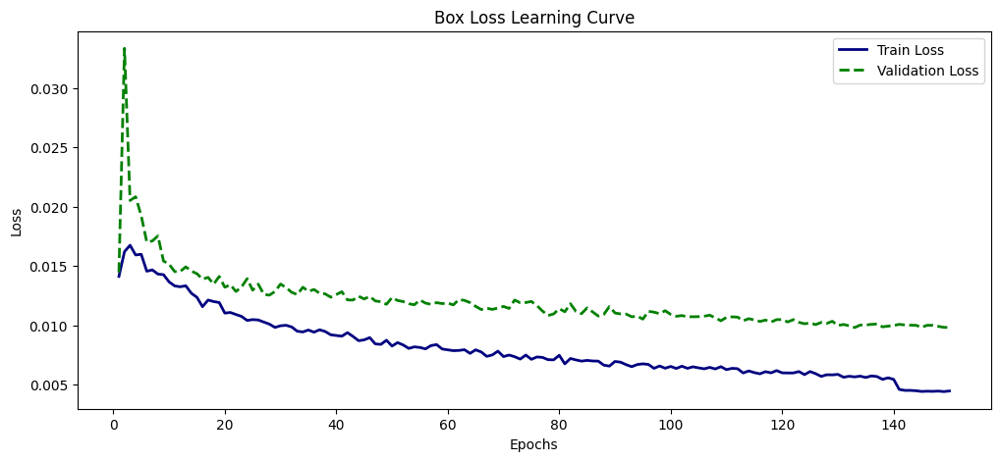

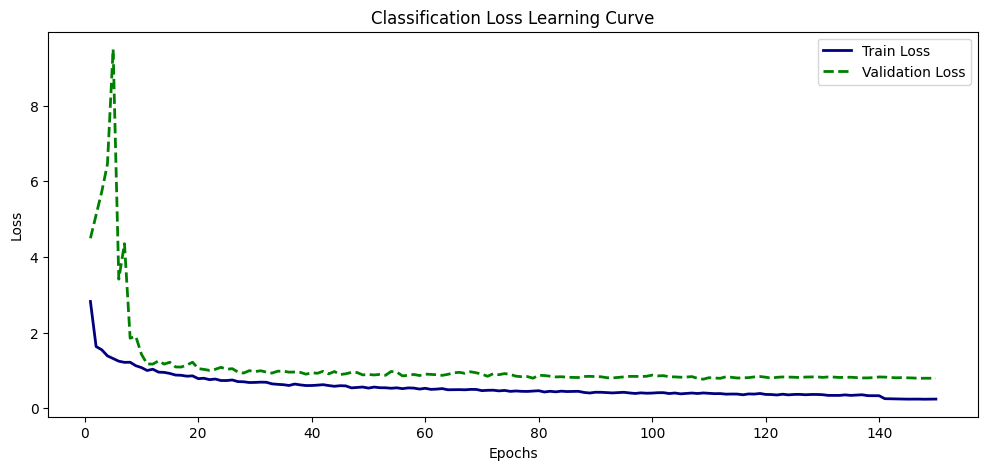

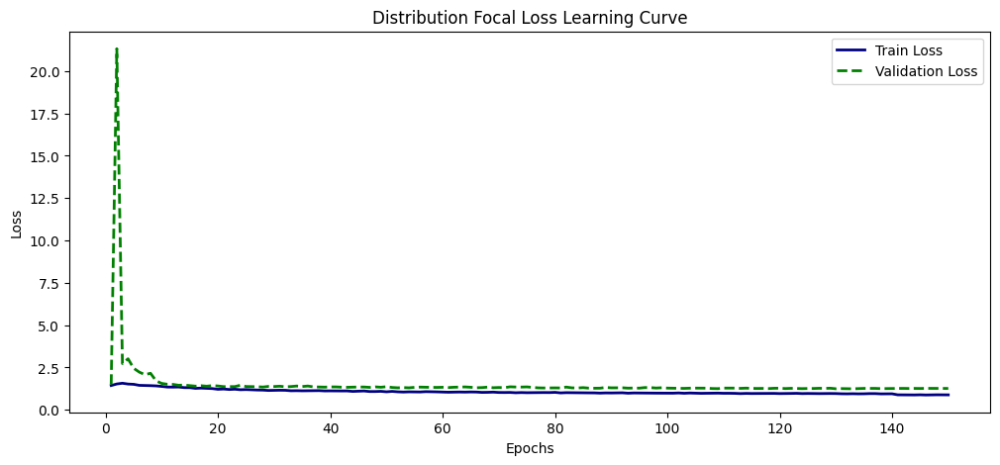

In [ ]:
import pandas as pd
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

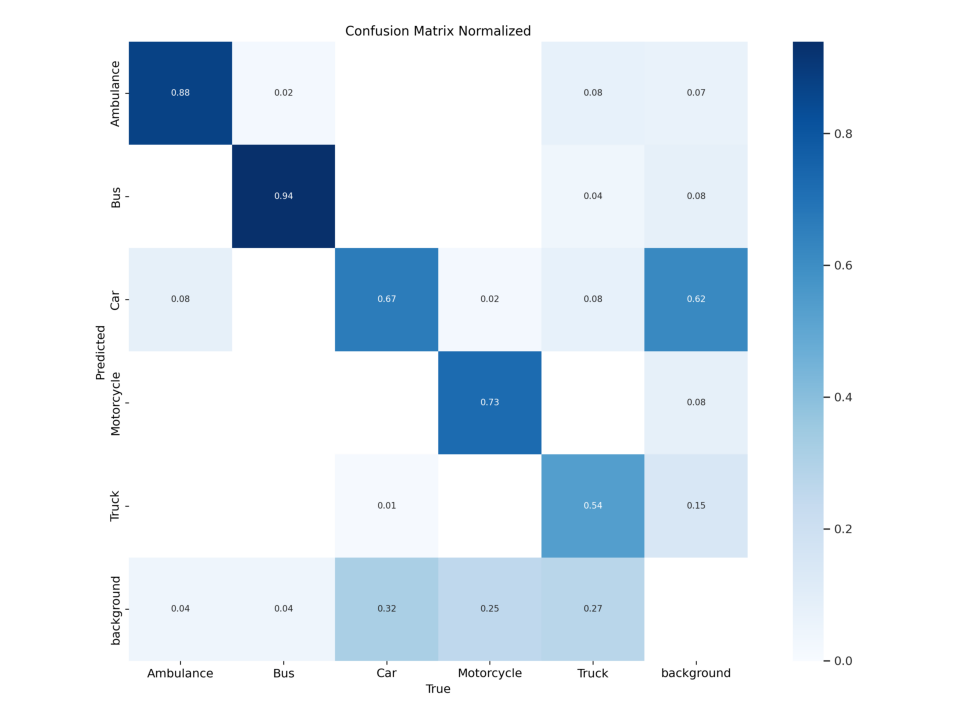

In [ ]:
# Construct the path to the normalized confusion matrix image
confusion_matrix_path = os.path.join(post_training_files_path, 'confusion_matrix_normalized.png')

# Read the image using cv2
cm_img = cv2.imread(confusion_matrix_path)

# Convert the image from BGR to RGB color space for accurate color representation with matplotlib
cm_img = cv2.cvtColor(cm_img, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(10, 10), dpi=120)
plt.imshow(cm_img)
plt.axis('off')
plt.show()

In [ ]:
# Construct the path to the best model weights file using os.path.join
best_model_path_yolo_detect = os.path.join(post_training_files_path, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model_yolo_detect = YOLO(best_model_path_yolo_detect)

# Validate the best model using the validation set with default parameters
metrics_yolo_detect = best_model_yolo_detect.val(split='val')

Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 112 layers, 43,610,463 parameters, 0 gradients, 164.8 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 743.0±308.7 MB/s, size: 27.9 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 469 images, 0 backgrounds, 0 corrupt: 100%|██████████| 469/469 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:21<00:00,  1.41it/s]


                   all        469        851      0.854      0.739      0.814        0.7
             Ambulance         78         97      0.843      0.886      0.898      0.804
                   Bus         68         99       0.87      0.859      0.916      0.833
                   Car        172        443      0.831      0.621      0.767      0.617
            Motorcycle         75        106      0.944      0.764      0.827      0.685
                 Truck         76        106      0.784      0.566      0.664       0.56
Speed: 1.2ms preprocess, 38.2ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/val2


In [ ]:
from ultralytics import YOLO

model = YOLO("/content/yolo11l.pt")

model.train(
    data="/content/vehicle_data/VehiclesDetectionDataset/dataset.yaml",
    epochs=150,
    imgsz=416,
    batch=32,
    device=0,
    patience=20,
    optimizer="AdamW",
    lr0=0.001,
    lrf=0.01,
    dropout=0.5,
    weight_decay=0.0007,
    freeze=20,
    seed=42,
    hsv_h=0.005,
    hsv_s=0.3,
    hsv_v=0.3,
    degrees=2.0,
    translate=0.05,
    scale=0.3,
    shear=0.0,
    perspective=0.0,
    flipud=0.0,
    fliplr=0.3,
    mosaic=0.3,
    mixup=0.0,
    copy_paste=0.0,
    iou=0.2,
    box=0.1
)


100%|██████████| 49.0M/49.0M [00:00<00:00, 108MB/s]


New https://pypi.org/project/ultralytics/8.3.136 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=0.1, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/vehicle_data/VehiclesDetectionDataset/dataset.yaml, degrees=2.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.5, dynamic=False, embed=None, epochs=150, erasing=0.4, exist_ok=False, fliplr=0.3, flipud=0.0, format=torchscript, fraction=1.0, freeze=20, half=False, hsv_h=0.005, hsv_s=0.3, hsv_v=0.3, imgsz=416, int8=False, iou=0.2, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/yolo11l.pt, momentum=0.937, mosaic=0.3, multi_scale=False, name=train3, nbs=64

train: Scanning /content/vehicle_data/VehiclesDetectionDataset/train/labels.cache... 659 images, 0 backgrounds, 0 corrupt: 100%|██████████| 659/659 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.1±0.1 ms, read: 440.5±362.2 MB/s, size: 33.5 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 469 images, 0 backgrounds, 0 corrupt: 100%|██████████| 469/469 [00:00<?, ?it/s]


Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 167 weight(decay=0.0), 174 weight(decay=0.0007), 173 bias(decay=0.0)
Image sizes 416 train, 416 val
Using 2 dataloader workers
Logging results to runs/detect/train3
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/150      4.37G    0.01388      1.939      1.324         41        416: 100%|██████████| 21/21 [00:07<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.72it/s]

                   all        469        851      0.472      0.646      0.548      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/150      4.95G    0.01532      1.381      1.372         39        416: 100%|██████████| 21/21 [00:07<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.75it/s]

                   all        469        851      0.348      0.634      0.366      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/150      4.95G    0.01487      1.284      1.358         52        416: 100%|██████████| 21/21 [00:07<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.78it/s]

                   all        469        851      0.414      0.558      0.355      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/150      4.95G    0.01427      1.212       1.33         44        416: 100%|██████████| 21/21 [00:07<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.82it/s]

                   all        469        851      0.569      0.719       0.67      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/150      4.95G     0.0142      1.168      1.318         34        416: 100%|██████████| 21/21 [00:06<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.74it/s]

                   all        469        851      0.426      0.678      0.553      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/150      4.95G    0.01382      1.067      1.301         32        416: 100%|██████████| 21/21 [00:06<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.77it/s]

                   all        469        851       0.65      0.624      0.665      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/150      4.95G    0.01375      1.043      1.297         46        416: 100%|██████████| 21/21 [00:06<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.79it/s]

                   all        469        851      0.655      0.613      0.673      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/150      4.95G    0.01353      1.038      1.292         45        416: 100%|██████████| 21/21 [00:07<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.77it/s]

                   all        469        851      0.678      0.615      0.668      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/150      4.95G    0.01316     0.9996      1.275         39        416: 100%|██████████| 21/21 [00:06<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.78it/s]

                   all        469        851      0.697      0.618      0.677      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/150      4.95G    0.01288     0.9474      1.262         50        416: 100%|██████████| 21/21 [00:06<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851      0.707      0.768      0.747      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/150      4.95G    0.01287     0.9371      1.253         55        416: 100%|██████████| 21/21 [00:06<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851      0.693      0.706      0.716      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/150      4.95G    0.01263     0.9123      1.238         60        416: 100%|██████████| 21/21 [00:07<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851      0.703      0.739      0.732       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/150      4.95G    0.01261     0.8845      1.246         33        416: 100%|██████████| 21/21 [00:07<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851      0.729      0.731      0.748      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/150      4.95G    0.01245     0.8871      1.239         61        416: 100%|██████████| 21/21 [00:07<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.82it/s]

                   all        469        851      0.762      0.691      0.765      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/150      4.95G    0.01245     0.8756      1.252         45        416: 100%|██████████| 21/21 [00:07<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851        0.7      0.744      0.757      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/150      4.95G     0.0117       0.81       1.21         41        416: 100%|██████████| 21/21 [00:07<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.69it/s]

                   all        469        851       0.67      0.792      0.772      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/150      4.95G    0.01208     0.8376      1.209         43        416: 100%|██████████| 21/21 [00:07<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851      0.761      0.773      0.782      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/150      4.95G    0.01153     0.7859      1.183         49        416: 100%|██████████| 21/21 [00:07<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.85it/s]

                   all        469        851       0.74      0.737      0.763      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/150      4.95G    0.01211     0.8163      1.209         53        416: 100%|██████████| 21/21 [00:06<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.75it/s]

                   all        469        851      0.716      0.756      0.787      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/150      4.95G    0.01173     0.7943      1.188         50        416: 100%|██████████| 21/21 [00:06<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  12%|█▎        | 1/8 [00:00<00:06,  1.16it/s]Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f19a06042c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1618, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py", line 1601, in _shutdown_workers
    if w.is_alive():
       ^^^^^^^^^^^^
  File "/usr/lib/python3.11/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  25%|██▌       | 2/8 [00:01<00:06,  1.02s/it]^^^^^^^^^^^^^^^^^^^^
AssertionError: 

                   all        469        851      0.784      0.707      0.783      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/150      4.95G    0.01142     0.7695      1.195         49        416: 100%|██████████| 21/21 [00:06<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.60it/s]

                   all        469        851      0.771      0.727      0.785      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/150      4.95G    0.01166     0.7822      1.189         48        416: 100%|██████████| 21/21 [00:06<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.67it/s]

                   all        469        851      0.798      0.706      0.792      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/150      4.95G    0.01128     0.7857      1.183         55        416: 100%|██████████| 21/21 [00:06<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:05<00:00,  1.60it/s]

                   all        469        851      0.751      0.787      0.786      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/150      4.95G      0.011     0.7372      1.172         45        416: 100%|██████████| 21/21 [00:06<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.72it/s]

                   all        469        851      0.773      0.721      0.771      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/150      4.95G    0.01083     0.7188       1.17         56        416: 100%|██████████| 21/21 [00:06<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.85it/s]

                   all        469        851      0.753       0.72      0.755      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/150      4.95G    0.01092     0.7184      1.169         38        416: 100%|██████████| 21/21 [00:06<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.85it/s]

                   all        469        851      0.774      0.715      0.777      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/150      4.95G    0.01092     0.6943      1.156         30        416: 100%|██████████| 21/21 [00:07<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851      0.785      0.738      0.788      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/150      4.95G    0.01111     0.7631      1.168         43        416: 100%|██████████| 21/21 [00:07<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.79it/s]

                   all        469        851      0.737      0.754      0.777      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/150      4.95G    0.01086     0.7038      1.154         53        416: 100%|██████████| 21/21 [00:07<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.82it/s]

                   all        469        851      0.795      0.708      0.791      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/150      4.95G    0.01052     0.6944      1.142         46        416: 100%|██████████| 21/21 [00:07<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.85it/s]

                   all        469        851      0.802      0.697      0.799       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/150      4.95G    0.01054     0.6933       1.15         49        416: 100%|██████████| 21/21 [00:07<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851      0.771      0.742      0.774      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/150      4.95G    0.01069     0.7003      1.144         45        416: 100%|██████████| 21/21 [00:07<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.79it/s]

                   all        469        851      0.775      0.755      0.797       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/150      4.95G    0.01042     0.6936      1.142         43        416: 100%|██████████| 21/21 [00:06<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.69it/s]

                   all        469        851      0.789      0.769      0.804       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/150      4.95G    0.01039     0.6725      1.139         59        416: 100%|██████████| 21/21 [00:06<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.72it/s]

                   all        469        851      0.825      0.714      0.796      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/150      4.95G    0.01042     0.6581      1.126         49        416: 100%|██████████| 21/21 [00:06<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.67it/s]

                   all        469        851      0.814      0.703      0.787      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/150      4.95G    0.01039     0.6573      1.136         45        416: 100%|██████████| 21/21 [00:06<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.67it/s]

                   all        469        851      0.801      0.726      0.811      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/150      4.95G    0.01055     0.6725      1.139         42        416: 100%|██████████| 21/21 [00:06<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.67it/s]

                   all        469        851      0.763      0.757      0.806      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/150      4.95G     0.0105     0.6632      1.135         46        416: 100%|██████████| 21/21 [00:06<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.65it/s]

                   all        469        851      0.822      0.698      0.804      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/150      4.95G    0.01027     0.6647      1.115         44        416: 100%|██████████| 21/21 [00:06<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.73it/s]

                   all        469        851      0.826      0.705      0.801      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/150      4.95G    0.01028     0.6801      1.143         42        416: 100%|██████████| 21/21 [00:06<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.77it/s]

                   all        469        851      0.818      0.709      0.788      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/150      4.95G    0.01015     0.6642      1.132         43        416: 100%|██████████| 21/21 [00:06<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.82it/s]

                   all        469        851      0.817      0.716      0.805      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/150      4.95G    0.01023     0.6373      1.119         36        416: 100%|██████████| 21/21 [00:07<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851      0.801      0.758      0.798      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/150      4.95G    0.01011     0.6292      1.131         36        416: 100%|██████████| 21/21 [00:07<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851      0.825      0.733      0.819      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/150      4.95G   0.009927     0.6406      1.121         35        416: 100%|██████████| 21/21 [00:07<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.85it/s]

                   all        469        851      0.774      0.777      0.802      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/150      4.95G    0.01007     0.6398      1.121         38        416: 100%|██████████| 21/21 [00:07<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851      0.792       0.76      0.806       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/150      4.95G     0.0105      0.653      1.137         46        416: 100%|██████████| 21/21 [00:07<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851      0.752      0.767      0.787      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/150      4.95G   0.009569     0.6091      1.102         39        416: 100%|██████████| 21/21 [00:07<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.83it/s]

                   all        469        851      0.783      0.722       0.79      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/150      4.95G   0.009826     0.6262       1.11         40        416: 100%|██████████| 21/21 [00:07<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.83it/s]

                   all        469        851      0.747      0.788      0.798      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/150      4.95G   0.009624     0.6085      1.094         45        416: 100%|██████████| 21/21 [00:06<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.70it/s]

                   all        469        851      0.769      0.792      0.817      0.651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/150      4.95G   0.009677     0.6059      1.105         52        416: 100%|██████████| 21/21 [00:07<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851      0.816       0.71      0.804      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/150      4.95G    0.01003     0.6252      1.124         52        416: 100%|██████████| 21/21 [00:07<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.85it/s]

                   all        469        851       0.81      0.747      0.803      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/150      4.95G    0.01005     0.6348       1.11         40        416: 100%|██████████| 21/21 [00:07<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.85it/s]

                   all        469        851      0.815      0.771      0.817       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/150      4.95G   0.009502     0.5959      1.087         41        416: 100%|██████████| 21/21 [00:07<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.86it/s]

                   all        469        851      0.781      0.763      0.818      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/150      4.95G   0.009674     0.6047      1.112         36        416: 100%|██████████| 21/21 [00:06<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.78it/s]

                   all        469        851      0.771      0.785      0.809       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/150      4.95G   0.009921     0.6169      1.116         52        416: 100%|██████████| 21/21 [00:06<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.68it/s]

                   all        469        851      0.763      0.782      0.808      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/150      4.95G    0.00947     0.5858      1.095         48        416: 100%|██████████| 21/21 [00:06<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.70it/s]

                   all        469        851      0.796      0.747      0.813      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/150      4.95G   0.009571     0.5973        1.1         59        416: 100%|██████████| 21/21 [00:06<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.68it/s]

                   all        469        851      0.845      0.712      0.812      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/150      4.95G   0.009726      0.611      1.108         48        416: 100%|██████████| 21/21 [00:06<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.63it/s]

                   all        469        851      0.846      0.741      0.811       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/150      4.95G   0.009475     0.5863      1.105         34        416: 100%|██████████| 21/21 [00:06<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.62it/s]

                   all        469        851      0.836      0.714      0.804      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/150      4.95G   0.009493     0.5967      1.085         27        416: 100%|██████████| 21/21 [00:06<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.61it/s]

                   all        469        851      0.811      0.744      0.809      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/150      4.95G   0.009417     0.5769      1.093         61        416: 100%|██████████| 21/21 [00:07<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.81it/s]

                   all        469        851      0.779      0.758      0.805      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/150      4.95G    0.00943     0.5815      1.088         35        416: 100%|██████████| 21/21 [00:07<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.79it/s]

                   all        469        851      0.805      0.784      0.821      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/150      4.95G   0.009631     0.6037        1.1         50        416: 100%|██████████| 21/21 [00:07<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.70it/s]

                   all        469        851      0.815      0.761      0.816      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/150      4.95G   0.009464      0.579       1.09         38        416: 100%|██████████| 21/21 [00:06<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.71it/s]

                   all        469        851      0.838      0.759      0.817      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/150      4.95G   0.009599     0.5705      1.102         63        416: 100%|██████████| 21/21 [00:06<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.64it/s]

                   all        469        851      0.805      0.774      0.808      0.652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/150      4.95G   0.009567     0.5825      1.104         37        416: 100%|██████████| 21/21 [00:06<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.66it/s]

                   all        469        851      0.807      0.781      0.815      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/150      4.95G   0.009166     0.5716      1.088         31        416: 100%|██████████| 21/21 [00:06<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.67it/s]

                   all        469        851       0.79      0.747      0.798      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/150      4.95G   0.009373     0.5844      1.082         40        416: 100%|██████████| 21/21 [00:06<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.62it/s]

                   all        469        851      0.798      0.738      0.787      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/150      4.95G   0.009386     0.5785      1.088         47        416: 100%|██████████| 21/21 [00:06<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.60it/s]

                   all        469        851      0.804      0.749      0.791      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/150      4.95G   0.009225     0.5572      1.071         49        416: 100%|██████████| 21/21 [00:06<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.65it/s]

                   all        469        851      0.805      0.761      0.814      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/150      4.95G   0.009254     0.5687      1.081         54        416: 100%|██████████| 21/21 [00:06<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.71it/s]

                   all        469        851      0.834      0.728        0.8      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/150      4.95G   0.009236     0.5661      1.081         38        416: 100%|██████████| 21/21 [00:06<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.72it/s]

                   all        469        851      0.832      0.765      0.819      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/150      4.95G   0.008919      0.552      1.067         48        416: 100%|██████████| 21/21 [00:06<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.67it/s]

                   all        469        851      0.797      0.776      0.801      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/150      4.95G   0.009107      0.567      1.061         47        416: 100%|██████████| 21/21 [00:06<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.62it/s]

                   all        469        851      0.823      0.751       0.81      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/150      4.95G   0.008772     0.5396      1.061         51        416: 100%|██████████| 21/21 [00:06<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.63it/s]

                   all        469        851      0.841      0.729      0.812      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/150      4.95G   0.008963     0.5345      1.061         36        416: 100%|██████████| 21/21 [00:06<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.71it/s]

                   all        469        851      0.828      0.754      0.808      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/150      4.95G    0.00905     0.5386      1.071         44        416: 100%|██████████| 21/21 [00:06<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.75it/s]

                   all        469        851       0.81      0.763      0.814       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/150      4.95G   0.008798      0.552      1.061         39        416: 100%|██████████| 21/21 [00:06<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.73it/s]

                   all        469        851      0.819      0.769      0.824      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/150      4.95G    0.00872     0.5459      1.059         43        416: 100%|██████████| 21/21 [00:06<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.83it/s]

                   all        469        851      0.801      0.763      0.813      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/150      4.95G   0.009349     0.5805      1.085         56        416: 100%|██████████| 21/21 [00:07<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.81it/s]

                   all        469        851      0.838       0.74      0.807      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/150      4.95G   0.008664     0.5243      1.055         36        416: 100%|██████████| 21/21 [00:07<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.79it/s]

                   all        469        851      0.775      0.756      0.803      0.656



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/150      4.95G   0.008847     0.5409      1.059         40        416: 100%|██████████| 21/21 [00:07<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.71it/s]

                   all        469        851       0.84      0.747      0.812       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/150      4.95G   0.008809      0.537      1.058         41        416: 100%|██████████| 21/21 [00:07<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.77it/s]

                   all        469        851       0.83      0.755      0.823      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/150      4.95G   0.008735      0.547       1.06         40        416: 100%|██████████| 21/21 [00:07<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.82it/s]

                   all        469        851      0.834       0.77      0.818      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/150      4.95G   0.008821     0.5373      1.072         42        416: 100%|██████████| 21/21 [00:07<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.80it/s]

                   all        469        851       0.81      0.731      0.808      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/150      4.95G   0.009006     0.5634      1.068         60        416: 100%|██████████| 21/21 [00:07<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.80it/s]

                   all        469        851      0.841      0.764      0.818      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/150      4.95G   0.008737     0.5487      1.048         55        416: 100%|██████████| 21/21 [00:07<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.81it/s]

                   all        469        851      0.812      0.744      0.815      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/150      4.95G   0.008398     0.5063      1.044         39        416: 100%|██████████| 21/21 [00:07<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.72it/s]

                   all        469        851      0.799      0.754      0.795      0.651



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/150      4.95G   0.008239     0.4921      1.039         55        416: 100%|██████████| 21/21 [00:06<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.67it/s]

                   all        469        851      0.796      0.774      0.814      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/150      4.95G   0.008637     0.5227      1.038         57        416: 100%|██████████| 21/21 [00:06<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.64it/s]

                   all        469        851      0.808       0.76      0.818      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/150      4.95G   0.008648     0.5326      1.046         39        416: 100%|██████████| 21/21 [00:06<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.65it/s]

                   all        469        851      0.815      0.769      0.811      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/150      4.95G   0.008434      0.527      1.051         44        416: 100%|██████████| 21/21 [00:06<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.67it/s]

                   all        469        851      0.784       0.77      0.814      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/150      4.95G   0.008354     0.5005      1.042         64        416: 100%|██████████| 21/21 [00:06<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.67it/s]

                   all        469        851      0.773      0.777       0.81      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/150      4.95G   0.008615     0.5243      1.058         27        416: 100%|██████████| 21/21 [00:06<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.64it/s]

                   all        469        851      0.781      0.777      0.809      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/150      4.95G   0.008554     0.5162      1.047         48        416: 100%|██████████| 21/21 [00:06<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.71it/s]

                   all        469        851      0.752      0.766      0.804       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/150      4.95G   0.008245     0.5079      1.032         57        416: 100%|██████████| 21/21 [00:06<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.72it/s]

                   all        469        851      0.796      0.757      0.811      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/150      4.95G   0.008103     0.4946      1.041         42        416: 100%|██████████| 21/21 [00:06<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.78it/s]

                   all        469        851      0.816      0.764      0.817       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/150      4.95G   0.008261     0.5098      1.049         44        416: 100%|██████████| 21/21 [00:06<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851      0.812      0.756      0.809      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/150      4.95G   0.008058     0.4954       1.03         51        416: 100%|██████████| 21/21 [00:07<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851      0.795      0.759      0.812      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/150      4.95G    0.00821     0.4916      1.029         64        416: 100%|██████████| 21/21 [00:07<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.82it/s]

                   all        469        851      0.842      0.734      0.816      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/150      4.95G   0.008137     0.5048      1.023         50        416: 100%|██████████| 21/21 [00:07<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.83it/s]

                   all        469        851      0.801      0.748      0.814       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/150      4.95G   0.008452     0.5205      1.041         50        416: 100%|██████████| 21/21 [00:07<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.82it/s]

                   all        469        851      0.816      0.732      0.811      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/150      4.95G   0.008187     0.5099      1.018         46        416: 100%|██████████| 21/21 [00:07<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.80it/s]

                   all        469        851      0.767      0.765      0.814      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/150      4.95G   0.008398     0.5139      1.046         52        416: 100%|██████████| 21/21 [00:07<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.82it/s]

                   all        469        851      0.829      0.742      0.819      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/150      4.95G   0.008065     0.4763      1.031         34        416: 100%|██████████| 21/21 [00:06<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.77it/s]

                   all        469        851      0.833      0.731      0.817      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/150      4.95G   0.008151      0.499      1.025         61        416: 100%|██████████| 21/21 [00:06<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.79it/s]

                   all        469        851      0.852       0.72      0.817      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/150      4.95G   0.008306     0.4968      1.035         51        416: 100%|██████████| 21/21 [00:06<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.82it/s]

                   all        469        851      0.855      0.708      0.818      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/150      4.95G   0.008266     0.4928      1.034         37        416: 100%|██████████| 21/21 [00:06<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:05<00:00,  1.56it/s]

                   all        469        851      0.832      0.743      0.818      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/150      4.95G   0.008357     0.5173      1.046         53        416: 100%|██████████| 21/21 [00:07<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.77it/s]

                   all        469        851      0.771      0.755      0.815       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/150      4.95G   0.008021     0.4952      1.021         53        416: 100%|██████████| 21/21 [00:07<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.81it/s]

                   all        469        851      0.856      0.723      0.812       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/150      4.95G   0.008182     0.4854       1.03         44        416: 100%|██████████| 21/21 [00:07<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.83it/s]

                   all        469        851      0.825       0.76      0.818      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/150      4.95G   0.008175     0.4824       1.02         44        416: 100%|██████████| 21/21 [00:07<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851      0.819      0.736      0.816      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/150      4.95G   0.007945     0.4712      1.023         48        416: 100%|██████████| 21/21 [00:07<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        469        851      0.837      0.735      0.824      0.689



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/150      4.95G   0.007993     0.4812      1.026         38        416: 100%|██████████| 21/21 [00:07<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.83it/s]

                   all        469        851      0.824      0.727      0.821      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/150      4.95G   0.007949     0.4793      1.029         41        416: 100%|██████████| 21/21 [00:07<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.82it/s]

                   all        469        851       0.78      0.762      0.819      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/150      4.95G   0.007815     0.4747      1.024         46        416: 100%|██████████| 21/21 [00:07<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.81it/s]

                   all        469        851      0.833      0.735      0.816      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/150      4.95G      0.008     0.4843      1.026         50        416: 100%|██████████| 21/21 [00:07<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.82it/s]

                   all        469        851       0.79      0.752       0.81      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/150      4.95G   0.008017     0.4845      1.024         48        416: 100%|██████████| 21/21 [00:07<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.83it/s]

                   all        469        851      0.808      0.756      0.813       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/150      4.95G   0.008132     0.5003      1.033         43        416: 100%|██████████| 21/21 [00:07<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.77it/s]

                   all        469        851      0.836      0.743      0.815      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/150      4.95G   0.007939     0.4715      1.031         42        416: 100%|██████████| 21/21 [00:06<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.72it/s]

                   all        469        851       0.83      0.746      0.824      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/150      4.95G   0.008018     0.4773      1.021         53        416: 100%|██████████| 21/21 [00:06<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.64it/s]

                   all        469        851      0.809      0.761      0.817       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/150      4.95G   0.007882     0.4772      1.014         51        416: 100%|██████████| 21/21 [00:06<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.69it/s]

                   all        469        851       0.81       0.76      0.818      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/150      4.95G   0.007987     0.4805      1.023         50        416: 100%|██████████| 21/21 [00:06<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.66it/s]

                   all        469        851      0.817      0.751      0.821      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/150      4.95G   0.007885     0.4718      1.025         44        416: 100%|██████████| 21/21 [00:06<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.63it/s]

                   all        469        851       0.84      0.733      0.816      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/150      4.95G   0.007913     0.4629      1.019         44        416: 100%|██████████| 21/21 [00:06<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.66it/s]

                   all        469        851      0.805      0.764      0.816      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/150      4.95G   0.007961     0.4886       1.03         42        416: 100%|██████████| 21/21 [00:06<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.67it/s]

                   all        469        851      0.814      0.759      0.823      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/150      4.95G   0.007739     0.4612      1.015         33        416: 100%|██████████| 21/21 [00:06<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.74it/s]

                   all        469        851      0.823      0.719      0.817      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/150      4.95G   0.007874     0.4789      1.014         49        416: 100%|██████████| 21/21 [00:06<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.75it/s]

                   all        469        851      0.832      0.744      0.818       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/150      4.95G   0.007709      0.472      1.015         38        416: 100%|██████████| 21/21 [00:06<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.82it/s]

                   all        469        851      0.841      0.745       0.82      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/150      4.95G   0.007931      0.471      1.021         53        416: 100%|██████████| 21/21 [00:07<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.81it/s]

                   all        469        851      0.776      0.776      0.818      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/150      4.95G   0.007524     0.4612      1.001         43        416: 100%|██████████| 21/21 [00:07<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.82it/s]

                   all        469        851      0.777       0.78      0.806      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/150      4.95G   0.007742      0.457      1.006         56        416: 100%|██████████| 21/21 [00:07<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.83it/s]

                   all        469        851      0.798      0.747      0.804      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/150      4.95G   0.007794     0.4678      1.012         58        416: 100%|██████████| 21/21 [00:07<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.82it/s]

                   all        469        851      0.835      0.754      0.819      0.677
EarlyStopping: Training stopped early as no improvement observed in last 20 epochs. Best results observed at epoch 113, best model saved as best.pt.
To update EarlyStopping(patience=20) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



133 epochs completed in 0.470 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 51.2MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 51.2MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11l summary (fused): 190 layers, 25,283,167 parameters, 0 gradients, 86.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:07<00:00,  1.14it/s]


                   all        469        851      0.837      0.735      0.824      0.689
             Ambulance         78         97       0.85      0.835      0.883       0.79
                   Bus         68         99      0.858      0.899      0.927      0.832
                   Car        172        443      0.855      0.666      0.772      0.609
            Motorcycle         75        106       0.84      0.792      0.839      0.666
                 Truck         76        106      0.782      0.481      0.695      0.545
Speed: 0.1ms preprocess, 5.9ms inference, 0.0ms loss, 2.4ms postprocess per image
Results saved to runs/detect/train3


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7f18e8331d50>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
# Define the path to the directory
post_training_files_path = '/content/runs/detect/train3'

# List the files in the directory
!ls {post_training_files_path}

args.yaml			 PR_curve.png	   val_batch0_labels.jpg
confusion_matrix_normalized.png  R_curve.png	   val_batch0_pred.jpg
confusion_matrix.png		 results.csv	   val_batch1_labels.jpg
F1_curve.png			 results.png	   val_batch1_pred.jpg
labels_correlogram.jpg		 train_batch0.jpg  val_batch2_labels.jpg
labels.jpg			 train_batch1.jpg  val_batch2_pred.jpg
P_curve.png			 train_batch2.jpg  weights


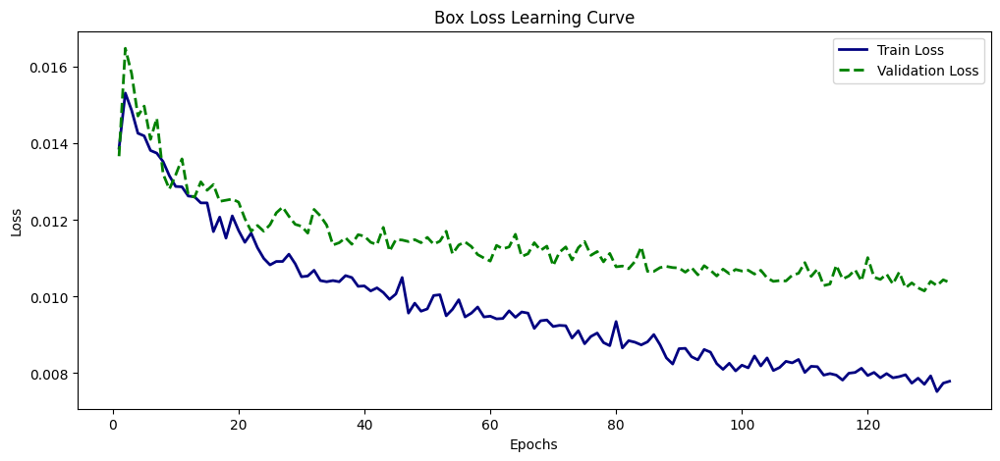

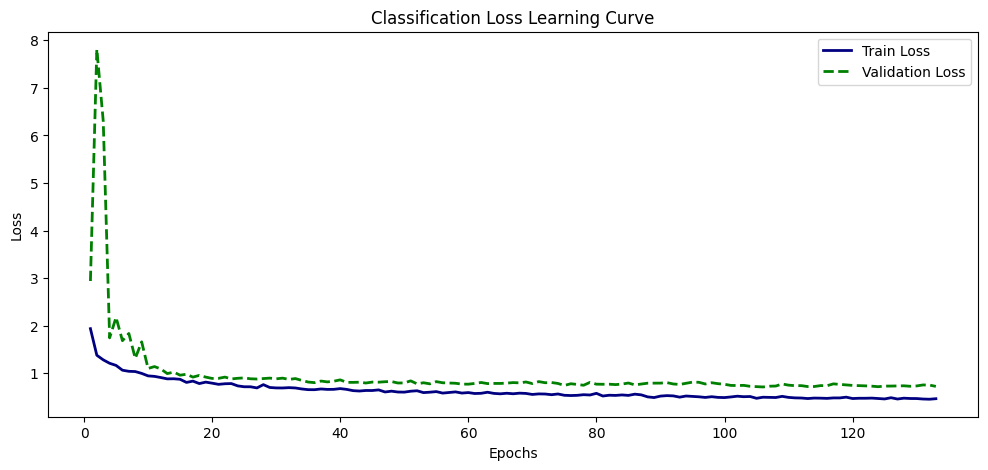

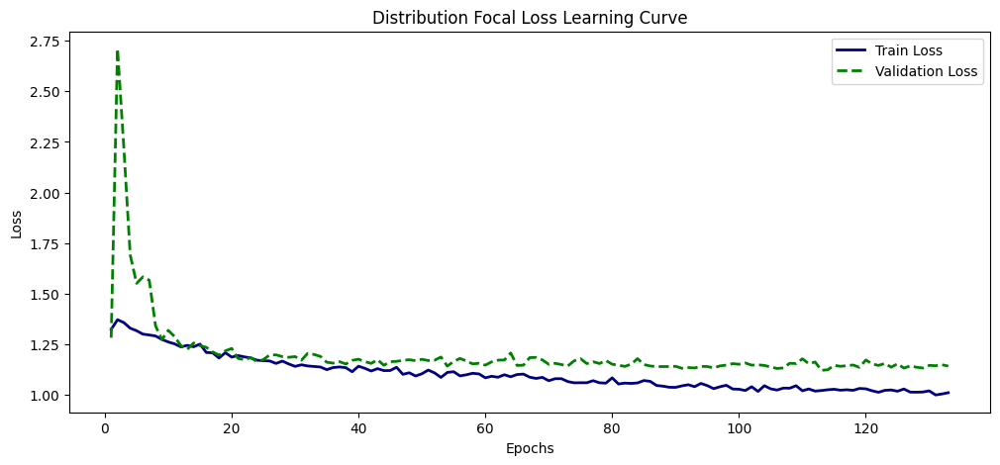

In [ ]:
import pandas as pd
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

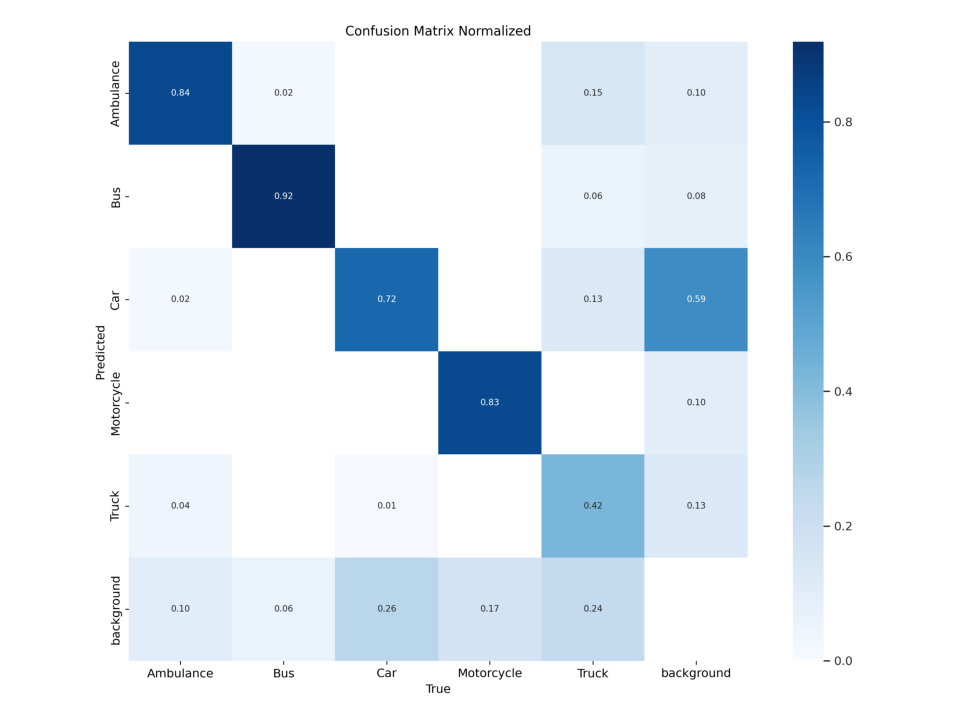

In [ ]:
s# Construct the path to the normalized confusion matrix image
confusion_matrix_path = os.path.join(post_training_files_path, 'confusion_matrix_normalized.png')

# Read the image using cv2
cm_img = cv2.imread(confusion_matrix_path)

# Convert the image from BGR to RGB color space for accurate color representation with matplotlib
cm_img = cv2.cvtColor(cm_img, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(10, 10), dpi=120)
plt.imshow(cm_img)
plt.axis('off')
plt.show()

In [ ]:
# Construct the path to the best model weights file using os.path.join
best_model_path_yolo_detect = os.path.join(post_training_files_path, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model_yolo_detect = YOLO(best_model_path_yolo_detect)

# Validate the best model using the validation set with default parameters
metrics_yolo_detect = best_model_yolo_detect.val(split='val')

Ultralytics 8.3.135 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11l summary (fused): 190 layers, 25,283,167 parameters, 0 gradients, 86.6 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 689.1±232.2 MB/s, size: 27.9 KB)


val: Scanning /content/vehicle_data/VehiclesDetectionDataset/valid/labels.cache... 469 images, 0 backgrounds, 0 corrupt: 100%|██████████| 469/469 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:09<00:00,  3.01it/s]


                   all        469        851      0.825      0.765      0.841      0.702
             Ambulance         78         97       0.86      0.897      0.925      0.822
                   Bus         68         99      0.841      0.899      0.944      0.852
                   Car        172        443      0.825      0.691      0.788       0.62
            Motorcycle         75        106      0.833      0.846      0.874      0.685
                 Truck         76        106      0.765      0.491      0.674      0.533
Speed: 0.8ms preprocess, 13.5ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to runs/detect/val3
